#### Benchmaking Experiment 006b
- benchmarking model architecture -3 with PAMAP2, DaLiAc and UTD-MHAD datasets
- Model : Model4
- Dataset : PAMAP2
- Semantic Space : Glove50
- Cross Validation : 5-fold fixed classes
- Feature Loss : MSELoss

In [116]:
import os 
from datetime import date
from tqdm import tqdm
from copy import deepcopy
import numpy as np 
import pandas as pd
import json

import torch 
from torch import nn, Tensor
from torch.nn import functional as F
from torch.nn.modules import MultiheadAttention, Linear, Dropout, BatchNorm1d, TransformerEncoderLayer
from torch.utils.data import Dataset, DataLoader
from torch.optim import Adam
from torch.nn import MSELoss

import numpy.random as random
from src.datasets.data import PAMAP2ReaderV2
from src.datasets.dataset import PAMAP2Dataset
from src.utils.analysis import action_evaluator
from src.datasets.utils import load_attribute

from src.models.loss import FeatureLoss, AttributeLoss

# from src.running import train_step1, eval_step1

In [117]:
# setup model configurations
config = {
    # general information
    "experiment-name": "test-001", 
    "datetime": date.today(),
    "device": "gpu",
    "dataset": "PAMAP2",
    "Model": "SOTAEmbedding",
    "model_params":{
        "linear_filters":[1024,1024,1024,512],
        "input_feat":36,
        "dropout":0.1,
    },
    "folding": True,
    "lr": 0.0001,
    "n_epochs": 15,
    "optimizer": "adam",
    "batch_size": 64,
    "seen_split": 0.2,
    "unseen_split": 0.8
}

In [118]:
def save_model(model,model_name,unique_name,fold_id):
    PATH = f"{models_saves}/{model_name}"
    os.makedirs(PATH,exist_ok=True)
    torch.save({
        "n_epochs" : config["n_epochs"],
        "model_state_dict":model.state_dict(),
        "config": config
    }, f"{PATH}/{unique_name}_{fold_id}.pt")

model_iden = "fold"
notebook_iden = "SORTModel_Pse3D_512"
models_saves = "model_saves"

In [119]:
dataReader = PAMAP2ReaderV2('data/PAMAP2_Dataset/Protocol/')
actionList = dataReader.idToLabel

Reading file 9 of 14
Reading file 10 of 14
Reading file 11 of 14
Reading file 12 of 14
Reading file 13 of 14
Reading file 14 of 14


D:\FYP\HAR-ZSL-XAI\src\datasets\data.py:525: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.asarray(data), np.asarray(labels, dtype=int), np.array(collection)


[ 1  2  3  4  5  6  7  9 10 11 12 13 16 17 18 19 20 24]
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
Reading file 1 of 14
Reading file 2 of 14
Reading file 3 of 14
Reading file 4 of 14
Reading file 5 of 14
Reading file 6 of 14
Reading file 7 of 14
Reading file 8 of 14
Reading file 9 of 14
Reading file 10 of 14
Reading file 11 of 14
Reading file 12 of 14
Reading file 13 of 14
Reading file 14 of 14


D:\FYP\HAR-ZSL-XAI\src\datasets\data.py:525: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.asarray(data), np.asarray(labels, dtype=int), np.array(collection)


[ 1  2  3  4  5  6  7  9 10 11 12 13 16 17 18 19 20 24]
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]


Model Building

In [120]:
class SOTAEmbedding(nn.Module):
    def __init__(self, linear_filters=[1024,1024,1024,2048],input_feat=102, dropout=0.1):
        super(SOTAEmbedding, self).__init__()
        self.input_feat = input_feat
        self.linear_filters = linear_filters
        self.input_feat = input_feat
        self.dropout = dropout

        self.linear1 = nn.Linear(input_feat,linear_filters[0])
        self.batch_norm1 = nn.BatchNorm1d(linear_filters[0])
        self.linear2 = nn.Linear(linear_filters[0],linear_filters[1])
        self.batch_norm2 = nn.BatchNorm1d(linear_filters[1])
        self.linear3 = nn.Linear(linear_filters[1],linear_filters[2])
        self.batch_norm3 = nn.BatchNorm1d(linear_filters[2])
        self.linear4 = nn.Linear(linear_filters[2]+linear_filters[1]+linear_filters[0],linear_filters[3])
        self.batch_norm4 = nn.BatchNorm1d(linear_filters[3])
        self.act = F.relu



    def forward(self, x):
        #layer1
        out1 = self.linear1(x)
        out1 = self.batch_norm1(out1)
        out1 = self.act(out1)

        #layer2
        out2 = self.linear2(out1)
        out2 = self.batch_norm2(out2)
        out2 = self.act(out2)

        #layer3
        out3 = self.linear3(out2)
        out3 = self.batch_norm3(out3)
        out3 = self.act(out3)

        concat = torch.cat([out1,out2,out3],-1)

        #layer4
        out4 = self.linear4(concat)
        out4 = self.batch_norm4(out4)
        out4 = self.act(out4)
        return out4

In [121]:
model = SOTAEmbedding(
    linear_filters=config["model_params"]["linear_filters"],
    input_feat=config["model_params"]["input_feat"],
    dropout=config["model_params"]["dropout"]
)

In [122]:
emb = model(torch.randn((32,36)))
emb.size()

torch.Size([32, 512])

torch.Size([32, 512])

In [123]:
emb

tensor([[0.0000, 1.4869, 0.7283,  ..., 0.0000, 0.9046, 0.0000],
        [0.0000, 0.8747, 0.0000,  ..., 2.2122, 0.0000, 0.0000],
        [0.6429, 0.7017, 1.4071,  ..., 0.9797, 0.0000, 0.0000],
        ...,
        [0.7765, 0.0000, 0.0000,  ..., 1.9160, 0.0000, 1.6804],
        [0.0000, 1.9667, 0.1284,  ..., 0.8266, 1.3393, 1.0089],
        [0.6884, 0.0000, 0.2712,  ..., 0.4221, 0.0000, 0.3386]],
       grad_fn=<ReluBackward0>)

tensor([[0.0000, 0.8405, 0.0000,  ..., 0.0000, 1.1584, 0.0000],
        [0.7699, 0.2634, 0.0000,  ..., 0.0000, 0.0000, 0.5675],
        [1.3743, 0.0000, 0.0000,  ..., 0.0000, 1.3122, 0.5106],
        ...,
        [0.7094, 0.1573, 0.0000,  ..., 0.0000, 0.0000, 1.4591],
        [0.9299, 0.1596, 0.8838,  ..., 1.5147, 0.0000, 0.1151],
        [0.7780, 1.0508, 0.6527,  ..., 0.0000, 0.4484, 0.7080]],
       grad_fn=<ReluBackward0>)

---

In [124]:
from sklearn.metrics import accuracy_score
from sklearn.metrics.pairwise import cosine_similarity

---

In [125]:
if config['device'] == 'cpu':
    device = "cpu"
else:
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [126]:
dataReader.data.shape

(124,)

(124,)

In [127]:
# run 5-fold running
fold_classes = [['watching TV', 'house cleaning', 'standing', 'ascending stairs'], ['walking', 'rope jumping', 'sitting', 'descending stairs'], ['playing soccer', 'lying', 'vacuum cleaning', 'computer work'], ['cycling', 'running', 'Nordic walking'], ['ironing', 'car driving', 'folding laundry']]

fold_cls_ids = [[actionList.index(i) for i in j] for j in fold_classes]

In [128]:
dts = PAMAP2Dataset

In [129]:
import pickle

with open("E:\\FYP_Data\\Pose3D\\dropout_prototypes.pkl","rb") as f0:
    prototype_map = pickle.load(f0)

In [130]:
video_data = prototype_map
video_classes, video_feat = np.asarray(list(prototype_map.keys())), np.asarray(list(prototype_map.values()))

In [131]:
video_feat.shape,list(prototype_map.keys())

((18, 512),
 ['Nordic walking',
  'ascending stairs',
  'car driving',
  'computer work',
  'cycling',
  'descending stairs',
  'folding laundry',
  'house cleaning',
  'ironing',
  'lying',
  'playing soccer',
  'rope jumping',
  'running',
  'sitting',
  'standing',
  'vacuum cleaning',
  'walking',
  'watching TV'])

((18, 512),
 ['Nordic walking',
  'ascending stairs',
  'car driving',
  'computer work',
  'cycling',
  'descending stairs',
  'folding laundry',
  'house cleaning',
  'ironing',
  'lying',
  'playing soccer',
  'rope jumping',
  'running',
  'sitting',
  'standing',
  'vacuum cleaning',
  'walking',
  'watching TV'])

In [132]:
video_classes,len(np.unique(video_classes))

(array(['Nordic walking', 'ascending stairs', 'car driving',
        'computer work', 'cycling', 'descending stairs', 'folding laundry',
        'house cleaning', 'ironing', 'lying', 'playing soccer',
        'rope jumping', 'running', 'sitting', 'standing',
        'vacuum cleaning', 'walking', 'watching TV'], dtype='<U17'),
 18)

(array(['Nordic walking', 'ascending stairs', 'car driving',
        'computer work', 'cycling', 'descending stairs', 'folding laundry',
        'house cleaning', 'ironing', 'lying', 'playing soccer',
        'rope jumping', 'running', 'sitting', 'standing',
        'vacuum cleaning', 'walking', 'watching TV'], dtype='<U17'),
 18)

In [133]:
vid_cls_name = np.unique(video_classes)

In [134]:
def selecting_video_prototypes(prototypes:np.array,classes:np.array,vid_class_name:np.array):
    selected = []
    for tar in vid_class_name:
        indexes = np.where(classes == tar)
        selected.append(torch.from_numpy(prototypes[random.choice(indexes[0])]))

    return torch.stack(selected)

In [135]:
selecting_video_prototypes(video_feat,video_classes,vid_cls_name).shape

torch.Size([18, 512])

torch.Size([18, 512])

In [136]:
dataReader.label_map

[(1, 'lying'),
 (2, 'sitting'),
 (3, 'standing'),
 (4, 'walking'),
 (5, 'running'),
 (6, 'cycling'),
 (7, 'Nordic walking'),
 (9, 'watching TV'),
 (10, 'computer work'),
 (11, 'car driving'),
 (12, 'ascending stairs'),
 (13, 'descending stairs'),
 (16, 'vacuum cleaning'),
 (17, 'ironing'),
 (18, 'folding laundry'),
 (19, 'house cleaning'),
 (20, 'playing soccer'),
 (24, 'rope jumping')]

[(1, 'lying'),
 (2, 'sitting'),
 (3, 'standing'),
 (4, 'walking'),
 (5, 'running'),
 (6, 'cycling'),
 (7, 'Nordic walking'),
 (9, 'watching TV'),
 (10, 'computer work'),
 (11, 'car driving'),
 (12, 'ascending stairs'),
 (13, 'descending stairs'),
 (16, 'vacuum cleaning'),
 (17, 'ironing'),
 (18, 'folding laundry'),
 (19, 'house cleaning'),
 (20, 'playing soccer'),
 (24, 'rope jumping')]

In [137]:
np.unique(video_classes)

array(['Nordic walking', 'ascending stairs', 'car driving',
       'computer work', 'cycling', 'descending stairs', 'folding laundry',
       'house cleaning', 'ironing', 'lying', 'playing soccer',
       'rope jumping', 'running', 'sitting', 'standing',
       'vacuum cleaning', 'walking', 'watching TV'], dtype='<U17')

array(['Nordic walking', 'ascending stairs', 'car driving',
       'computer work', 'cycling', 'descending stairs', 'folding laundry',
       'house cleaning', 'ironing', 'lying', 'playing soccer',
       'rope jumping', 'running', 'sitting', 'standing',
       'vacuum cleaning', 'walking', 'watching TV'], dtype='<U17')

In [138]:
from collections import defaultdict

label2Id = {c[1]:i for i,c in enumerate(dataReader.label_map)}
action_dict = defaultdict(list)
skeleton_Ids = []
for i, a in enumerate(video_classes):
    action_dict[label2Id[a]].append(i)
    skeleton_Ids.append(label2Id[a])

In [139]:
action_dict

defaultdict(list,
            {6: [0],
             10: [1],
             9: [2],
             8: [3],
             5: [4],
             11: [5],
             14: [6],
             15: [7],
             13: [8],
             0: [9],
             16: [10],
             17: [11],
             4: [12],
             1: [13],
             2: [14],
             12: [15],
             3: [16],
             7: [17]})

defaultdict(list,
            {6: [0],
             10: [1],
             9: [2],
             8: [3],
             5: [4],
             11: [5],
             14: [6],
             15: [7],
             13: [8],
             0: [9],
             16: [10],
             17: [11],
             4: [12],
             1: [13],
             2: [14],
             12: [15],
             3: [16],
             7: [17]})

In [140]:
data_dict = dataReader.generate(unseen_classes=fold_cls_ids[0], seen_ratio=0.2, unseen_ratio=0.8, window_size=5.21, window_overlap=4.21, resample_freq=20)

per class count :  {'lying': 8, 'sitting': 8, 'standing': 8, 'walking': 8, 'running': 6, 'cycling': 7, 'Nordic walking': 7, 'watching TV': 1, 'computer work': 4, 'car driving': 1, 'ascending stairs': 16, 'descending stairs': 17, 'vacuum cleaning': 8, 'ironing': 8, 'folding laundry': 4, 'house cleaning': 5, 'playing soccer': 2, 'rope jumping': 6}
<class 'list'> <class 'list'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
per class count :  {'lying': 8, 'sitting': 8, 'standing': 8, 'walking': 8, 'running': 6, 'cycling': 7, 'Nordic walking': 7, 'watching TV': 1, 'computer work': 4, 'car driving': 1, 'ascending stairs': 16, 'descending stairs': 17, 'vacuum cleaning': 8, 'ironing': 8, 'folding laundry': 4, 'house cleaning': 5, 'playing soccer': 2, 'rope jumping': 6}
<class 'list'> <class 'list'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>


In [141]:
data_dict['train']['X'].shape,data_dict['train']['y'].shape

((16752, 36), (16752,))

((16752, 36), (16752,))

In [142]:
action_dict

defaultdict(list,
            {6: [0],
             10: [1],
             9: [2],
             8: [3],
             5: [4],
             11: [5],
             14: [6],
             15: [7],
             13: [8],
             0: [9],
             16: [10],
             17: [11],
             4: [12],
             1: [13],
             2: [14],
             12: [15],
             3: [16],
             7: [17]})

defaultdict(list,
            {6: [0],
             10: [1],
             9: [2],
             8: [3],
             5: [4],
             11: [5],
             14: [6],
             15: [7],
             13: [8],
             0: [9],
             16: [10],
             17: [11],
             4: [12],
             1: [13],
             2: [14],
             12: [15],
             3: [16],
             7: [17]})

In [143]:
data_dict['seen_classes']

[0, 1, 3, 4, 5, 6, 8, 9, 11, 12, 13, 14, 16, 17]

[0, 1, 3, 4, 5, 6, 8, 9, 11, 12, 13, 14, 16, 17]

In [144]:
sample_dt = PAMAP2Dataset(data=data_dict['train']['X'], actions=data_dict['train']['y'], attributes=video_feat, attribute_dict=action_dict, action_classes=data_dict['seen_classes'], seq_len=100)
sample_dl = DataLoader(sample_dt, batch_size=32, shuffle=True, pin_memory=True, drop_last=True)
for d in sample_dl:
    print(100*np.isinf(d[0].numpy()).sum()/(d[0].shape[0]*d[0].shape[1]))

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0


In [145]:
sample_dt.action2Id

{0: 0,
 1: 1,
 3: 2,
 4: 3,
 5: 4,
 6: 5,
 8: 6,
 9: 7,
 11: 8,
 12: 9,
 13: 10,
 14: 11,
 16: 12,
 17: 13}

{0: 0,
 1: 1,
 3: 2,
 4: 3,
 5: 4,
 6: 5,
 8: 6,
 9: 7,
 11: 8,
 12: 9,
 13: 10,
 14: 11,
 16: 12,
 17: 13}

In [146]:
sample_dt.attribute_dict

defaultdict(list,
            {6: [0],
             10: [1],
             9: [2],
             8: [3],
             5: [4],
             11: [5],
             14: [6],
             15: [7],
             13: [8],
             0: [9],
             16: [10],
             17: [11],
             4: [12],
             1: [13],
             2: [14],
             12: [15],
             3: [16],
             7: [17]})

defaultdict(list,
            {6: [0],
             10: [1],
             9: [2],
             8: [3],
             5: [4],
             11: [5],
             14: [6],
             15: [7],
             13: [8],
             0: [9],
             16: [10],
             17: [11],
             4: [12],
             1: [13],
             2: [14],
             12: [15],
             3: [16],
             7: [17]})

In [147]:
r = sample_dt.getClassAttrs()
r.shape

torch.Size([14, 512])

torch.Size([14, 512])

In [148]:
def loss_cross_entropy(
        y_pred:torch.Tensor,
        cls:torch.Tensor,
        selected_features,
        loss_fn=nn.CrossEntropyLoss(reduction="sum")
):
    num_classes = selected_features.size()[0]
    #print(selected_features)
    cosine_sim_comb = []
    for entry in y_pred.unbind():
        #print(entry.repeat(num_classes,1),selected_features.size())
        cosine_sim = F.cosine_similarity(entry.repeat(num_classes,1),selected_features)
        cosine_sim_comb.append(cosine_sim)

    cosine_sim_comb = torch.stack(cosine_sim_comb)
    loss = loss_fn(cosine_sim_comb,cls)
    #print(loss)
    return loss

def predict_class(
        y_pred:torch.Tensor,
        selected_features):

    num_classes = selected_features.size()[0]

    cosine_sim_comb = []
    for entry in y_pred.unbind():
        cosine_sim = torch.argmax(F.softmax(F.cosine_similarity(entry.repeat(num_classes,1),selected_features),dim=-1))
        cosine_sim_comb.append(cosine_sim)

    pred = torch.stack(cosine_sim_comb)
    return pred

In [149]:
def loss_reconstruction_calc(y_pred:torch.Tensor,y_feat:torch.Tensor,loss_fn=nn.L1Loss(reduction="sum")):
    bat_size,feature_size = y_pred.size()
    loss = loss_fn(y_pred,y_feat)*(1/feature_size)
    #print(loss)
    return loss

In [150]:
def train_step(model, dataloader, dataset:PAMAP2Dataset, optimizer, loss_module, device, class_names, phase='train', l2_reg=False, loss_alpha=0.7):
    model = model.train()
    epoch_loss = 0  # total loss of epoch
    total_samples = 0  # total samples in epoch
    random_selected_feat = dataset.getClassFeatures().to(device)

    with tqdm(dataloader, unit="batch", desc=phase) as tepoch:
        for batch in tepoch:
            X, targets, target_feat = batch
            X = X.float().to(device)
            target_feat = target_feat.float().to(device)
            targets = targets.long().to(device)

            # Zero gradients, perform a backward pass, and update the weights.
            optimizer.zero_grad()
            # forward
            # track history if only in train
            with torch.set_grad_enabled(phase == 'train'):
            # with autocast():
                feat_output = model(X)
                class_loss = loss_cross_entropy(feat_output,targets.squeeze(),random_selected_feat,loss_fn =loss_module['class'] )
                feat_loss = loss_reconstruction_calc(feat_output,target_feat,loss_fn=loss_module["feature"])

            #loss = cross_entropy_loss
            loss = feat_loss + loss_alpha*class_loss
            class_output = predict_class(feat_output,random_selected_feat)

            if phase == 'train':
                loss.backward()
                optimizer.step()

            metrics = {"loss": loss.item()}
            with torch.no_grad():
                total_samples += len(targets)
                epoch_loss += loss.item()  # add total loss of batch

            # convert feature vector into action class
            # using cosine
            pred_class = class_output.cpu().detach().numpy()
            metrics["accuracy"] = accuracy_score(y_true=targets.cpu().detach().numpy(), y_pred=pred_class)
            tepoch.set_postfix(metrics)

    epoch_loss = epoch_loss / total_samples  # average loss per sample for whole epoch
    return metrics

In [151]:
def eval_step(model, dataloader,dataset, loss_module, device, class_names,  phase='seen', l2_reg=False, print_report=True, loss_alpha=0.7):
    model = model.eval()
    random_selected_feat = dataset.getClassFeatures().to(device)
    epoch_loss = 0  # total loss of epoch
    total_samples = 0  # total samples in epoch
    per_batch = {'target_masks': [], 'targets': [], 'predictions': [], 'metrics': [], 'IDs': []}

    with tqdm(dataloader, unit="batch", desc=phase) as tepoch:
        for batch in tepoch:
            X, targets, target_feat = batch
            X = X.float().to(device)
            X = X.float().to(device)
            target_feat = target_feat.float().to(device)
            targets = targets.long().to(device)

            # forward
            # track history if only in train
            with torch.set_grad_enabled(phase == 'train'):
            # with autocast():
                feat_output = model(X)
                class_loss = loss_cross_entropy(feat_output,targets.squeeze(),random_selected_feat,loss_fn =loss_module['class'] )
                feat_loss = loss_reconstruction_calc(feat_output,target_feat,loss_fn=loss_module["feature"])

            #loss = cross_entropy_loss
            loss = feat_loss + loss_alpha*class_loss
            class_output = predict_class(feat_output,random_selected_feat)

            # convert feature vector into action class
            # using cosine
            if phase == 'seen':
                pred_action = class_output
            else:
                #feat_numpy = torch.sigmoid(feat_output.cpu().detach())
                #action_probs = cosine_similarity(feat_numpy, target_feat_met)
                pred_action = class_output

            per_batch['targets'].append(targets.cpu().numpy())
            per_batch['predictions'].append(pred_action.cpu().numpy())
            per_batch['metrics'].append([loss.cpu().numpy()])

            tepoch.set_postfix({"loss": loss.item()})

    all_preds = np.concatenate(per_batch["predictions"])
    all_targets = np.concatenate(per_batch["targets"])
    metrics_dict = action_evaluator(y_pred=all_preds, y_true=all_targets[:, 0], class_names=class_names, print_report=print_report)
    return metrics_dict

================ Fold-0 ================
Unseen Classes : ['watching TV', 'house cleaning', 'standing', 'ascending stairs']
per class count :  {'lying': 8, 'sitting': 8, 'standing': 8, 'walking': 8, 'running': 6, 'cycling': 7, 'Nordic walking': 7, 'watching TV': 1, 'computer work': 4, 'car driving': 1, 'ascending stairs': 16, 'descending stairs': 17, 'vacuum cleaning': 8, 'ironing': 8, 'folding laundry': 4, 'house cleaning': 5, 'playing soccer': 2, 'rope jumping': 6}
<class 'list'> <class 'list'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
seen classes >  [0, 1, 3, 4, 5, 6, 8, 9, 11, 12, 13, 14, 16, 17]
unseen classes >  [7, 15, 2, 10]
Initiate IMU datasets ...


Training Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

torch.Size([14, 512])



train: 100%|██████████| 261/261 [00:33<00:00,  7.84batch/s, loss=7.14, accuracy=0.953]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:04<00:00, 13.66batch/s, loss=4.89]


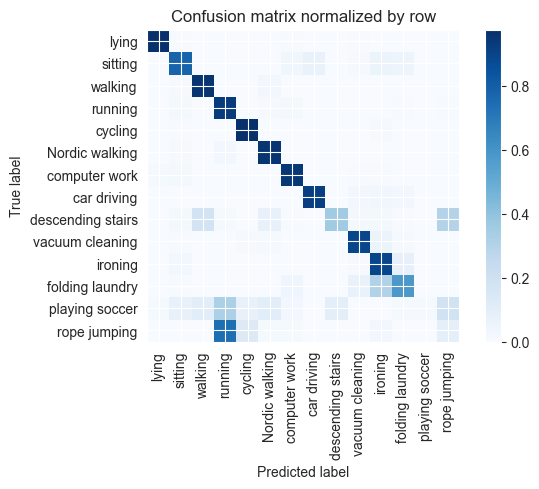

Training Epoch:   7%|▋         | 1/15 [00:40<09:31, 40.84s/it]

Overall accuracy: 0.848

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.945      0.949      0.947      0.145        602|	 sitting: 0.020,	lying: 0.015,	
          walking       0.910      0.958      0.933      0.114        476|	 Nordic walking: 0.027,	sitting: 0.008,	
          ironing       0.788      0.890      0.835      0.113        471|	 folding laundry: 0.076,	sitting: 0.025,	
            lying       0.975      0.977      0.976      0.095        396|	 vacuum cleaning: 0.005,	computer work: 0.005,	
   Nordic walking       0.882      0.955      0.917      0.086        359|	 running: 0.028,	sitting: 0.008,	
          sitting       0.841      0.779      0.809      0.085        353|	 car driving: 0.065,	ironing: 0.059,	
          cycling       0.940      0.976      0.958      0.081        335|	 ironing: 0.009,	sitting: 0.006,	
  vacuum cleaning       0.896      0.896      0.896      0.076        317|	 ironing: 0.0


train: 100%|██████████| 261/261 [00:37<00:00,  6.88batch/s, loss=8, accuracy=0.891]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:05<00:00, 11.30batch/s, loss=5.79]


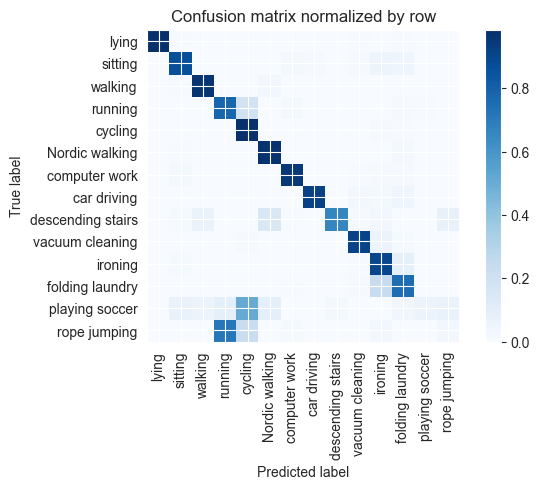

Training Epoch:  13%|█▎        | 2/15 [01:25<09:20, 43.09s/it]

Overall accuracy: 0.877

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.978      0.954      0.966      0.146        609|	 sitting: 0.018,	folding laundry: 0.008,	
          walking       0.960      0.966      0.963      0.114        475|	 Nordic walking: 0.023,	sitting: 0.004,	
          ironing       0.817      0.900      0.856      0.113        470|	 folding laundry: 0.083,	sitting: 0.013,	
            lying       0.995      0.977      0.986      0.095        397|	 folding laundry: 0.005,	vacuum cleaning: 0.005,	
   Nordic walking       0.877      0.975      0.924      0.087        360|	 folding laundry: 0.017,	sitting: 0.006,	
          sitting       0.902      0.866      0.884      0.085        352|	 ironing: 0.048,	folding laundry: 0.043,	
          cycling       0.762      0.985      0.859      0.080        331|	 ironing: 0.009,	folding laundry: 0.006,	
  vacuum cleaning       0.941      0.911      0.926     


train: 100%|██████████| 261/261 [00:40<00:00,  6.49batch/s, loss=5.96, accuracy=0.859]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:05<00:00, 11.84batch/s, loss=4.51]


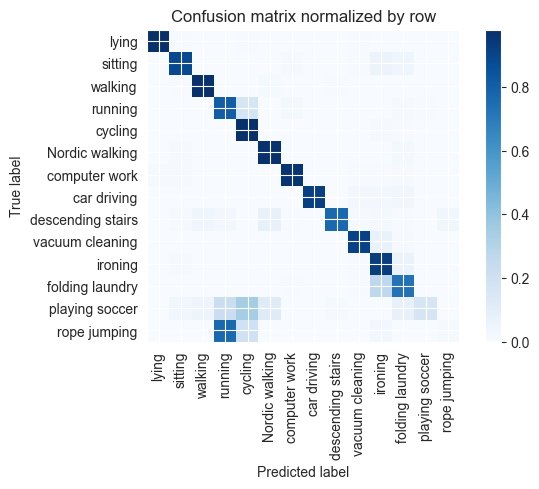

Training Epoch:  20%|██        | 3/15 [02:12<08:56, 44.70s/it]

Overall accuracy: 0.889

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.983      0.960      0.972      0.145        604|	 folding laundry: 0.008,	sitting: 0.008,	
          walking       0.973      0.973      0.973      0.114        474|	 Nordic walking: 0.015,	descending stairs: 0.004,	
          ironing       0.806      0.926      0.861      0.113        470|	 folding laundry: 0.062,	sitting: 0.009,	
            lying       0.987      0.977      0.982      0.096        398|	 vacuum cleaning: 0.005,	cycling: 0.005,	
   Nordic walking       0.915      0.969      0.941      0.086        357|	 folding laundry: 0.017,	sitting: 0.008,	
          sitting       0.932      0.887      0.909      0.085        353|	 ironing: 0.054,	folding laundry: 0.040,	
          cycling       0.800      0.979      0.880      0.080        334|	 ironing: 0.009,	folding laundry: 0.006,	
  vacuum cleaning       0.944      0.911      0.928   


train: 100%|██████████| 261/261 [00:41<00:00,  6.22batch/s, loss=5.15, accuracy=0.922]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:05<00:00, 11.16batch/s, loss=4.07]


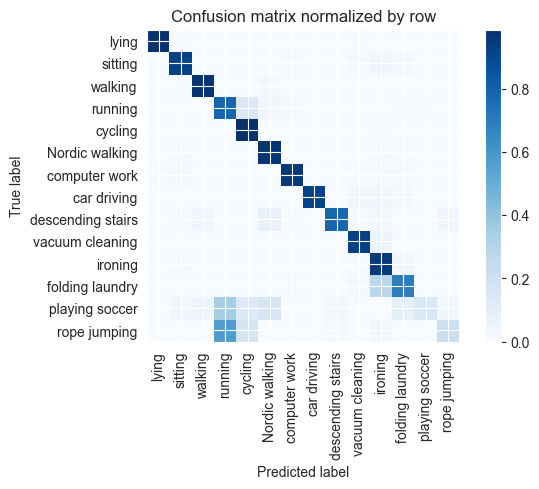

Training Epoch:  27%|██▋       | 4/15 [03:05<08:47, 48.00s/it]

Overall accuracy: 0.899

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.983      0.951      0.967      0.146        609|	 sitting: 0.018,	folding laundry: 0.008,	
          walking       0.971      0.973      0.972      0.114        476|	 Nordic walking: 0.017,	sitting: 0.004,	
          ironing       0.807      0.951      0.873      0.113        469|	 folding laundry: 0.034,	sitting: 0.009,	
            lying       0.990      0.980      0.985      0.095        395|	 vacuum cleaning: 0.005,	sitting: 0.005,	
   Nordic walking       0.888      0.972      0.928      0.087        360|	 sitting: 0.011,	ironing: 0.008,	
          sitting       0.915      0.915      0.915      0.085        355|	 ironing: 0.042,	folding laundry: 0.023,	
          cycling       0.854      0.988      0.916      0.080        332|	 ironing: 0.006,	Nordic walking: 0.003,	
  vacuum cleaning       0.930      0.925      0.927      0.076        318


train: 100%|██████████| 261/261 [00:43<00:00,  6.00batch/s, loss=5.62, accuracy=0.875]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:06<00:00, 10.58batch/s, loss=4.49]


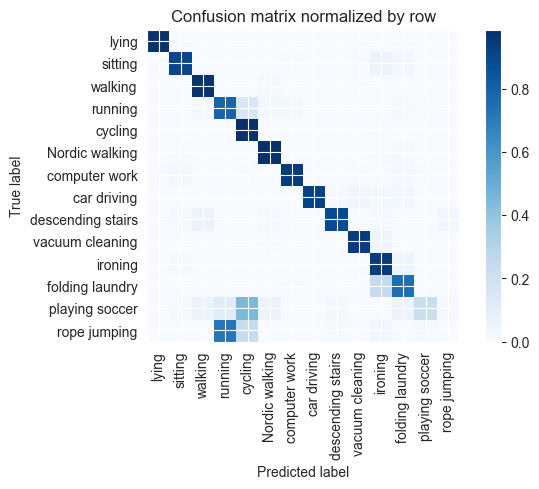

Training Epoch:  33%|███▎      | 5/15 [03:55<08:08, 48.90s/it]

Overall accuracy: 0.902

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.988      0.946      0.966      0.146        606|	 sitting: 0.017,	folding laundry: 0.012,	
          walking       0.965      0.975      0.970      0.114        474|	 Nordic walking: 0.015,	vacuum cleaning: 0.006,	
          ironing       0.833      0.945      0.885      0.113        470|	 folding laundry: 0.043,	sitting: 0.009,	
            lying       0.990      0.980      0.985      0.095        396|	 folding laundry: 0.005,	vacuum cleaning: 0.005,	
   Nordic walking       0.946      0.980      0.963      0.086        358|	 folding laundry: 0.008,	ironing: 0.006,	
          sitting       0.933      0.904      0.918      0.085        354|	 ironing: 0.054,	folding laundry: 0.028,	
          cycling       0.782      0.988      0.873      0.080        334|	 ironing: 0.006,	descending stairs: 0.003,	
  vacuum cleaning       0.946      0.940      


train: 100%|██████████| 261/261 [00:45<00:00,  5.76batch/s, loss=6.73, accuracy=0.891]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:06<00:00, 10.42batch/s, loss=5.4]


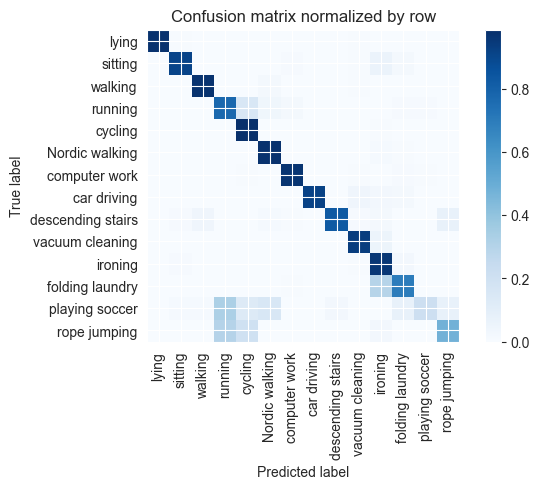

Training Epoch:  40%|████      | 6/15 [04:48<07:31, 50.12s/it]

Overall accuracy: 0.910

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.985      0.969      0.977      0.145        605|	 folding laundry: 0.010,	cycling: 0.007,	
          walking       0.981      0.975      0.978      0.114        473|	 Nordic walking: 0.017,	vacuum cleaning: 0.006,	
          ironing       0.803      0.959      0.874      0.113        468|	 folding laundry: 0.026,	sitting: 0.009,	
            lying       1.000      0.980      0.990      0.096        398|	 vacuum cleaning: 0.005,	sitting: 0.005,	
   Nordic walking       0.917      0.978      0.946      0.087        360|	 ironing: 0.014,	folding laundry: 0.006,	
          sitting       0.961      0.907      0.933      0.085        355|	 ironing: 0.059,	folding laundry: 0.017,	
          cycling       0.844      0.988      0.910      0.080        334|	 ironing: 0.006,	descending stairs: 0.003,	
  vacuum cleaning       0.937      0.937      0.937   


train: 100%|██████████| 261/261 [00:46<00:00,  5.62batch/s, loss=4.7, accuracy=0.859]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:06<00:00, 10.51batch/s, loss=4.6]


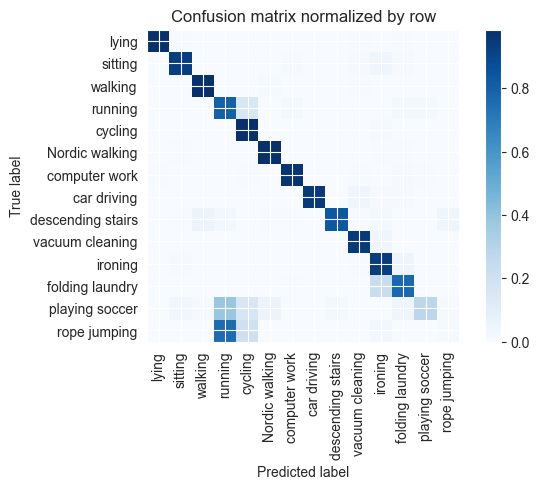

Training Epoch:  47%|████▋     | 7/15 [05:41<06:50, 51.25s/it]

Overall accuracy: 0.908

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.987      0.964      0.975      0.146        609|	 folding laundry: 0.008,	cycling: 0.007,	
          walking       0.975      0.979      0.977      0.113        472|	 Nordic walking: 0.013,	vacuum cleaning: 0.004,	
          ironing       0.844      0.938      0.888      0.113        471|	 folding laundry: 0.047,	sitting: 0.008,	
            lying       0.992      0.980      0.986      0.095        396|	 folding laundry: 0.005,	vacuum cleaning: 0.005,	
   Nordic walking       0.964      0.978      0.971      0.086        358|	 folding laundry: 0.006,	ironing: 0.006,	
          sitting       0.951      0.935      0.943      0.085        354|	 ironing: 0.040,	folding laundry: 0.008,	
          cycling       0.836      0.985      0.904      0.081        336|	 ironing: 0.009,	descending stairs: 0.003,	
  vacuum cleaning       0.940      0.943      


train: 100%|██████████| 261/261 [00:46<00:00,  5.57batch/s, loss=4.15, accuracy=0.891]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:06<00:00, 10.07batch/s, loss=4.59]


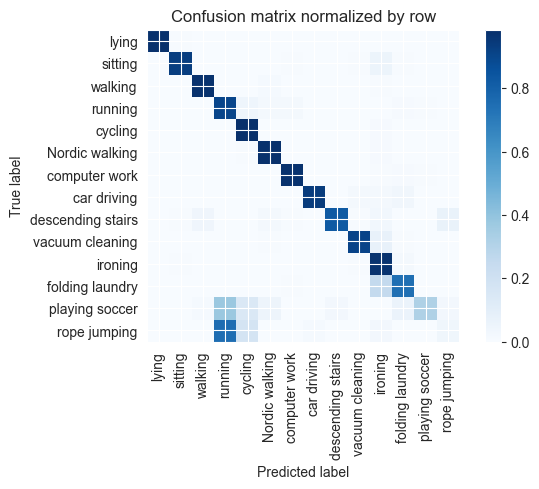

Training Epoch:  53%|█████▎    | 8/15 [06:36<06:05, 52.23s/it]

Overall accuracy: 0.914

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.987      0.975      0.981      0.146        609|	 folding laundry: 0.008,	ironing: 0.007,	
          walking       0.981      0.975      0.978      0.114        476|	 Nordic walking: 0.015,	ironing: 0.006,	
          ironing       0.805      0.972      0.881      0.113        472|	 folding laundry: 0.017,	sitting: 0.006,	
            lying       1.000      0.980      0.990      0.095        397|	 sitting: 0.008,	playing soccer: 0.003,	
   Nordic walking       0.943      0.977      0.960      0.085        355|	 ironing: 0.011,	cycling: 0.006,	
          sitting       0.970      0.929      0.949      0.085        353|	 ironing: 0.054,	folding laundry: 0.006,	
          cycling       0.896      0.985      0.938      0.080        331|	 ironing: 0.009,	descending stairs: 0.003,	
  vacuum cleaning       0.967      0.912      0.938      0.076        3


train: 100%|██████████| 261/261 [00:47<00:00,  5.53batch/s, loss=5.22, accuracy=0.891]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:06<00:00, 10.01batch/s, loss=4.82]


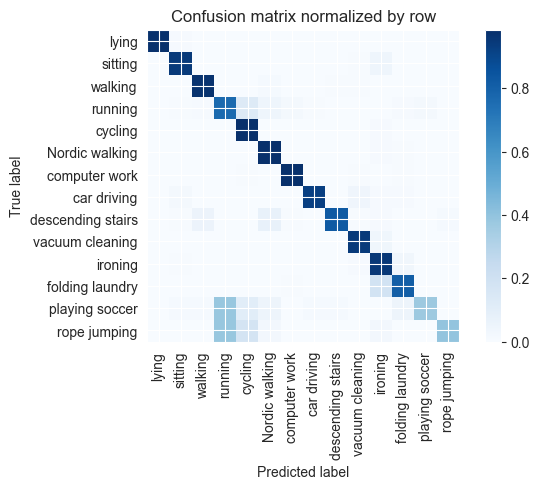

Training Epoch:  60%|██████    | 9/15 [07:30<05:17, 52.99s/it]

Overall accuracy: 0.921

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.988      0.979      0.984      0.147        610|	 folding laundry: 0.005,	vacuum cleaning: 0.005,	
          walking       0.971      0.973      0.972      0.114        476|	 Nordic walking: 0.015,	vacuum cleaning: 0.004,	
          ironing       0.858      0.953      0.903      0.113        469|	 folding laundry: 0.032,	vacuum cleaning: 0.009,	
            lying       1.000      0.980      0.990      0.095        396|	 sitting: 0.010,	playing soccer: 0.003,	
   Nordic walking       0.904      0.983      0.942      0.086        356|	 ironing: 0.008,	folding laundry: 0.006,	
          sitting       0.952      0.946      0.949      0.085        354|	 ironing: 0.042,	vacuum cleaning: 0.006,	
          cycling       0.868      0.985      0.923      0.080        334|	 ironing: 0.009,	descending stairs: 0.003,	
  vacuum cleaning       0.943      0.94


train: 100%|██████████| 261/261 [00:47<00:00,  5.45batch/s, loss=4.84, accuracy=0.953]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:06<00:00,  9.87batch/s, loss=3.79]


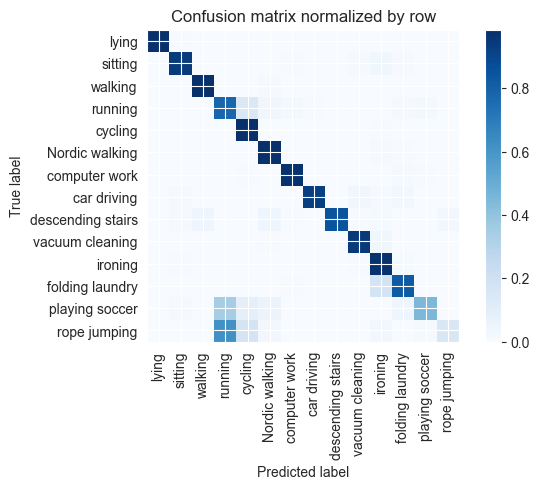

Training Epoch:  67%|██████▋   | 10/15 [08:26<04:28, 53.76s/it]

Overall accuracy: 0.922

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.987      0.974      0.980      0.146        607|	 folding laundry: 0.008,	playing soccer: 0.007,	
          ironing       0.870      0.975      0.919      0.113        472|	 folding laundry: 0.013,	vacuum cleaning: 0.006,	
          walking       0.979      0.981      0.980      0.113        472|	 Nordic walking: 0.011,	ironing: 0.002,	
            lying       1.000      0.980      0.990      0.096        398|	 sitting: 0.008,	playing soccer: 0.003,	
   Nordic walking       0.927      0.983      0.954      0.087        360|	 ironing: 0.008,	folding laundry: 0.006,	
          sitting       0.957      0.941      0.949      0.085        354|	 ironing: 0.037,	folding laundry: 0.008,	
          cycling       0.862      0.985      0.920      0.080        331|	 ironing: 0.006,	playing soccer: 0.003,	
  vacuum cleaning       0.952      0.946      0.949


train: 100%|██████████| 261/261 [00:47<00:00,  5.45batch/s, loss=5.03, accuracy=0.922]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:06<00:00,  9.86batch/s, loss=3.97]


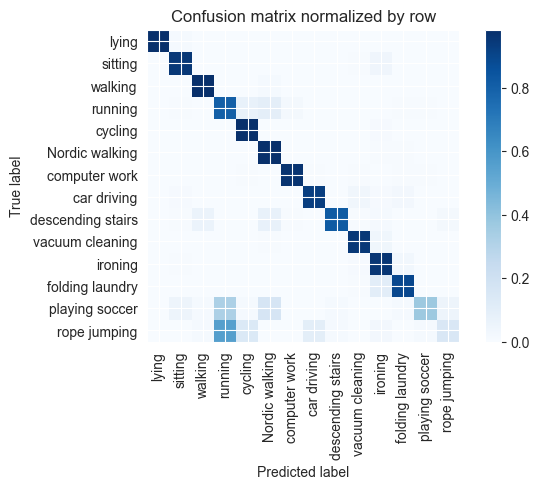

Training Epoch:  73%|███████▎  | 11/15 [09:21<03:37, 54.28s/it]

Overall accuracy: 0.922

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.992      0.967      0.979      0.146        608|	 playing soccer: 0.007,	folding laundry: 0.007,	
          walking       0.971      0.981      0.976      0.114        474|	 Nordic walking: 0.015,	ironing: 0.002,	
          ironing       0.886      0.959      0.921      0.113        468|	 folding laundry: 0.028,	vacuum cleaning: 0.009,	
            lying       1.000      0.980      0.990      0.096        398|	 sitting: 0.013,	playing soccer: 0.003,	
   Nordic walking       0.867      0.983      0.921      0.086        358|	 folding laundry: 0.006,	ironing: 0.006,	
          sitting       0.952      0.949      0.950      0.085        354|	 ironing: 0.040,	vacuum cleaning: 0.006,	
          cycling       0.919      0.982      0.950      0.081        336|	 ironing: 0.009,	playing soccer: 0.003,	
  vacuum cleaning       0.944      0.950      0.947


train: 100%|██████████| 261/261 [00:48<00:00,  5.40batch/s, loss=4.35, accuracy=0.922]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:06<00:00,  9.96batch/s, loss=3.24]


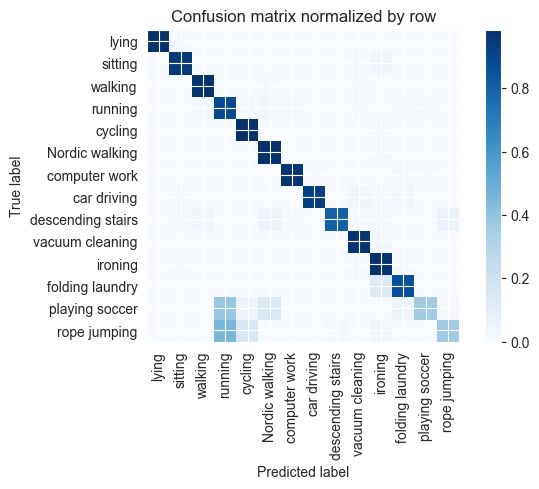

Training Epoch:  80%|████████  | 12/15 [10:17<02:44, 54.78s/it]

Overall accuracy: 0.930

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.992      0.969      0.980      0.146        607|	 folding laundry: 0.010,	car driving: 0.007,	
          walking       0.973      0.977      0.975      0.115        478|	 Nordic walking: 0.013,	vacuum cleaning: 0.006,	
          ironing       0.877      0.977      0.924      0.113        469|	 folding laundry: 0.011,	vacuum cleaning: 0.006,	
            lying       1.000      0.980      0.990      0.095        397|	 sitting: 0.013,	playing soccer: 0.003,	
   Nordic walking       0.907      0.983      0.944      0.086        358|	 ironing: 0.008,	folding laundry: 0.003,	
          sitting       0.957      0.943      0.950      0.085        352|	 ironing: 0.045,	vacuum cleaning: 0.006,	
          cycling       0.940      0.985      0.962      0.080        334|	 ironing: 0.009,	folding laundry: 0.003,	
  vacuum cleaning       0.941      0.965     


train: 100%|██████████| 261/261 [00:49<00:00,  5.31batch/s, loss=4.01, accuracy=0.984]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  9.10batch/s, loss=3.45]


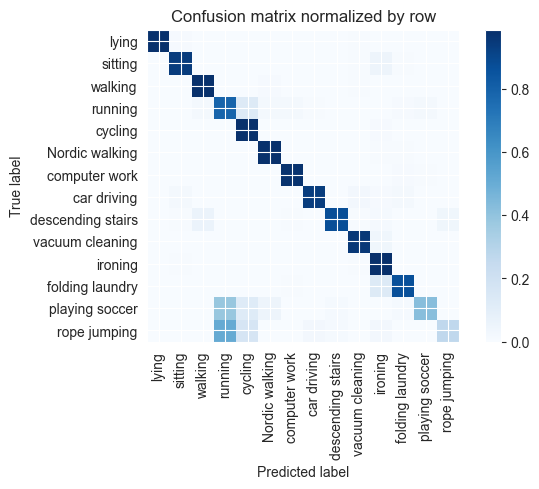

Training Epoch:  87%|████████▋ | 13/15 [11:14<01:51, 55.54s/it]

Overall accuracy: 0.930

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.990      0.974      0.982      0.147        610|	 folding laundry: 0.010,	playing soccer: 0.005,	
          walking       0.967      0.981      0.974      0.115        478|	 Nordic walking: 0.010,	vacuum cleaning: 0.006,	
          ironing       0.874      0.987      0.927      0.113        471|	 vacuum cleaning: 0.006,	sitting: 0.004,	
            lying       1.000      0.980      0.990      0.095        396|	 sitting: 0.010,	vacuum cleaning: 0.005,	
   Nordic walking       0.964      0.983      0.974      0.086        357|	 folding laundry: 0.006,	ironing: 0.006,	
          sitting       0.968      0.938      0.953      0.085        354|	 ironing: 0.048,	folding laundry: 0.006,	
          cycling       0.872      0.982      0.924      0.080        334|	 ironing: 0.009,	playing soccer: 0.003,	
  vacuum cleaning       0.946      0.955      0.95


train: 100%|██████████| 261/261 [00:48<00:00,  5.34batch/s, loss=3.39, accuracy=0.969]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:06<00:00,  9.29batch/s, loss=2.99]


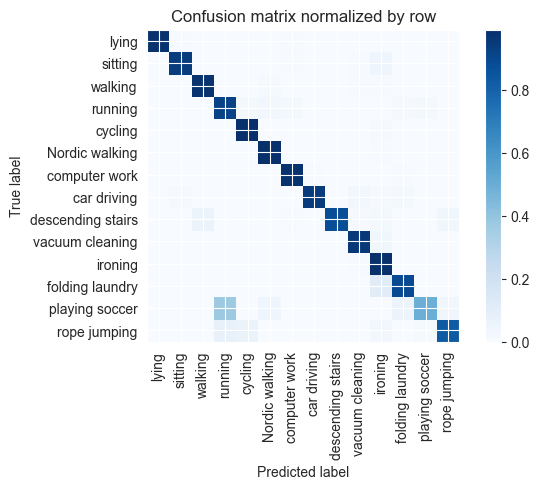

Training Epoch:  93%|█████████▎| 14/15 [12:11<00:55, 55.95s/it]

Overall accuracy: 0.950

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.985      0.979      0.982      0.146        606|	 folding laundry: 0.005,	car driving: 0.005,	
          walking       0.979      0.977      0.978      0.114        475|	 Nordic walking: 0.013,	ironing: 0.004,	
          ironing       0.877      0.989      0.930      0.113        470|	 vacuum cleaning: 0.006,	folding laundry: 0.002,	
            lying       1.000      0.980      0.990      0.095        396|	 sitting: 0.008,	computer work: 0.005,	
   Nordic walking       0.957      0.983      0.970      0.086        359|	 ironing: 0.006,	folding laundry: 0.003,	
          sitting       0.976      0.941      0.958      0.085        353|	 ironing: 0.045,	vacuum cleaning: 0.006,	
          cycling       0.968      0.985      0.976      0.081        335|	 ironing: 0.009,	descending stairs: 0.003,	
  vacuum cleaning       0.953      0.956      0.954 


train: 100%|██████████| 261/261 [00:49<00:00,  5.30batch/s, loss=4.73, accuracy=0.953]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:06<00:00, 10.68batch/s, loss=3.46]


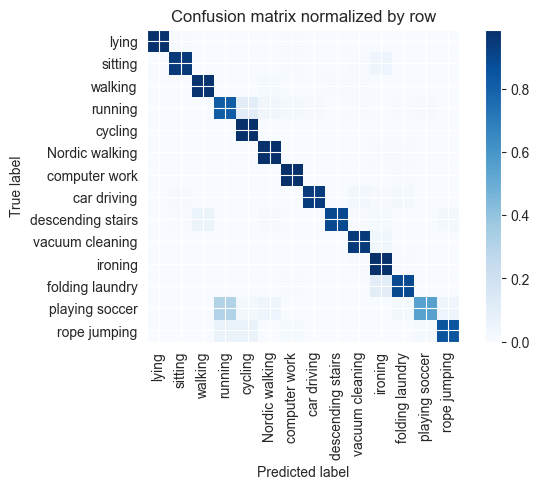

Overall accuracy: 0.949

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.985      0.982      0.983      0.146        607|	 folding laundry: 0.005,	playing soccer: 0.003,	
          walking       0.979      0.973      0.976      0.114        476|	 Nordic walking: 0.015,	vacuum cleaning: 0.006,	
          ironing       0.897      0.987      0.940      0.113        470|	 folding laundry: 0.006,	vacuum cleaning: 0.004,	
            lying       1.000      0.980      0.990      0.095        396|	 computer work: 0.005,	sitting: 0.005,	
   Nordic walking       0.947      0.983      0.965      0.087        360|	 folding laundry: 0.006,	ironing: 0.006,	
          sitting       0.974      0.946      0.960      0.085        353|	 ironing: 0.040,	vacuum cleaning: 0.006,	
          cycling       0.919      0.988      0.952      0.080        334|	 playing soccer: 0.003,	ironing: 0.003,	
  vacuum cleaning       0.949      0.952    

unseen: 100%|██████████| 87/87 [00:08<00:00, 10.72batch/s, loss=2.83]


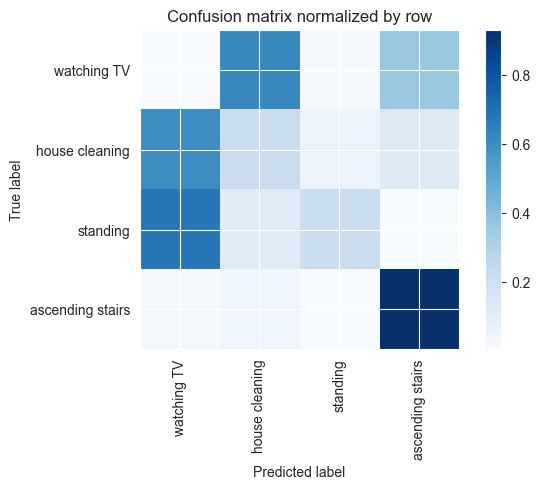

Overall accuracy: 0.321

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

        standing       0.761      0.209      0.328      0.331       1842|	 watching TV: 0.673,	house cleaning: 0.111,	
  house cleaning       0.343      0.218      0.266      0.328       1824|	 watching TV: 0.599,	ascending stairs: 0.127,	
ascending stairs       0.649      0.929      0.764      0.193       1076|	 house cleaning: 0.044,	watching TV: 0.021,	
     watching TV       0.003      0.007      0.004      0.148        826|	 house cleaning: 0.617,	ascending stairs: 0.361,	standing: 0.015,	

----------------------------------------------------------------------------------------------------
     avg / total       0.490      0.321      0.344        1.0       5568|	      

{'accuracy': 0.32112068965517243, 'precision': 0.43861399035767246, 'recall': 0.34082435114237436, 'f1': 0.3404552249395862}
================ Fold-1 ================
Unseen Classes : ['walking', 'rop

Training Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

torch.Size([14, 512])



train: 100%|██████████| 262/262 [00:50<00:00,  5.19batch/s, loss=7.59, accuracy=0.781]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  8.88batch/s, loss=7.14]


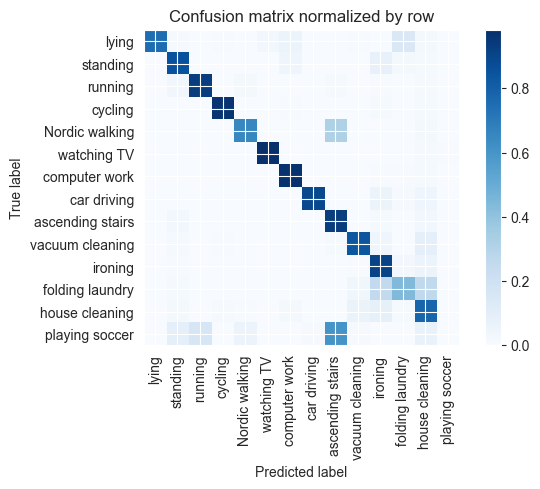

Training Epoch:   7%|▋         | 1/15 [00:59<13:46, 59.03s/it]

Overall accuracy: 0.824

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.928      0.973      0.950      0.144        600|	 house cleaning: 0.013,	folding laundry: 0.005,	
         ironing       0.748      0.908      0.820      0.110        457|	 house cleaning: 0.050,	folding laundry: 0.031,	
  Nordic walking       0.963      0.654      0.779      0.094        393|	 ascending stairs: 0.318,	house cleaning: 0.023,	
        standing       0.885      0.858      0.871      0.093        387|	 ironing: 0.070,	computer work: 0.039,	
           lying       1.000      0.749      0.856      0.093        386|	 folding laundry: 0.140,	computer work: 0.052,	
  house cleaning       0.637      0.781      0.702      0.085        352|	 ironing: 0.082,	vacuum cleaning: 0.062,	
 vacuum cleaning       0.888      0.839      0.863      0.082        341|	 house cleaning: 0.088,	ironing: 0.041,	
         cycling       0.974      0.960      0


train: 100%|██████████| 262/262 [00:51<00:00,  5.08batch/s, loss=5.76, accuracy=0.875]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:06<00:00,  9.34batch/s, loss=5.44]


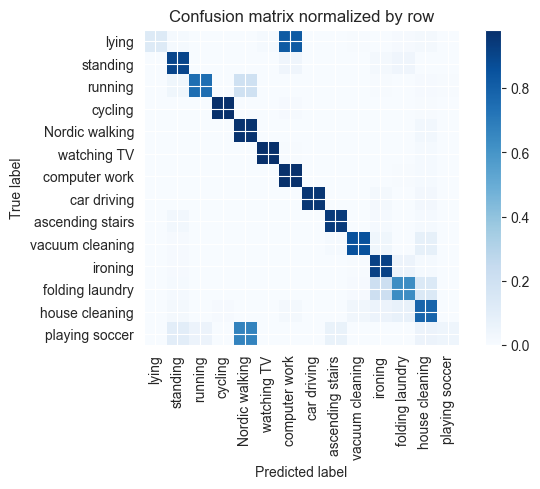

Training Epoch:  13%|█▎        | 2/15 [01:58<12:51, 59.31s/it]

Overall accuracy: 0.807

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.629      0.977      0.765      0.144        598|	 house cleaning: 0.013,	folding laundry: 0.007,	
         ironing       0.823      0.915      0.866      0.110        457|	 folding laundry: 0.057,	house cleaning: 0.015,	
  Nordic walking       0.796      0.967      0.873      0.095        395|	 house cleaning: 0.028,	ironing: 0.003,	
           lying       1.000      0.123      0.220      0.094        389|	 computer work: 0.817,	house cleaning: 0.015,	
        standing       0.883      0.899      0.891      0.093        387|	 folding laundry: 0.041,	computer work: 0.039,	
  house cleaning       0.726      0.783      0.753      0.085        355|	 folding laundry: 0.073,	ironing: 0.056,	
 vacuum cleaning       0.941      0.855      0.896      0.081        338|	 house cleaning: 0.083,	ironing: 0.036,	
         cycling       0.986      0.979      0.9


train: 100%|██████████| 262/262 [00:52<00:00,  4.98batch/s, loss=6.7, accuracy=0.906]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  9.01batch/s, loss=3.61]


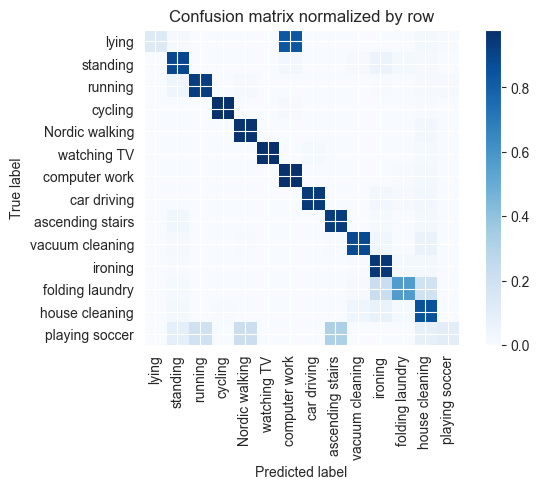

Training Epoch:  20%|██        | 3/15 [02:59<12:00, 60.00s/it]

Overall accuracy: 0.823

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.634      0.973      0.768      0.144        599|	 house cleaning: 0.017,	folding laundry: 0.005,	
         ironing       0.796      0.950      0.866      0.110        456|	 house cleaning: 0.022,	folding laundry: 0.018,	
  Nordic walking       0.943      0.967      0.955      0.094        393|	 house cleaning: 0.028,	ironing: 0.003,	
           lying       1.000      0.129      0.228      0.093        388|	 computer work: 0.832,	house cleaning: 0.021,	
        standing       0.887      0.889      0.888      0.093        387|	 ironing: 0.054,	computer work: 0.026,	
  house cleaning       0.712      0.849      0.775      0.085        352|	 ironing: 0.065,	vacuum cleaning: 0.040,	
 vacuum cleaning       0.926      0.882      0.904      0.082        340|	 house cleaning: 0.062,	ironing: 0.035,	
         cycling       0.993      0.979      0.986      


train: 100%|██████████| 262/262 [00:51<00:00,  5.11batch/s, loss=6.82, accuracy=0.891]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  9.11batch/s, loss=5.43]


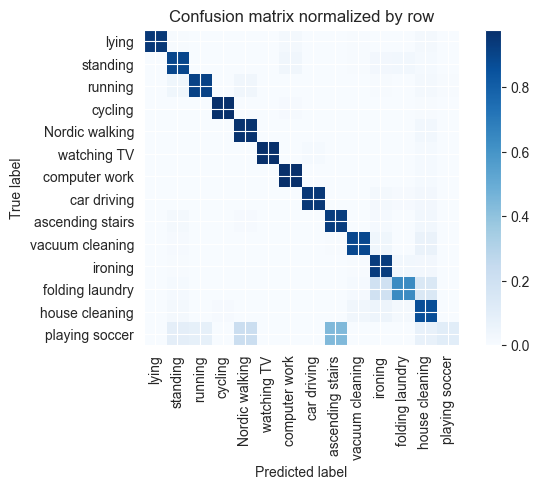

Training Epoch:  27%|██▋       | 4/15 [03:58<10:57, 59.78s/it]

Overall accuracy: 0.902

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.962      0.975      0.968      0.144        598|	 house cleaning: 0.015,	folding laundry: 0.003,	
         ironing       0.828      0.932      0.877      0.110        459|	 folding laundry: 0.031,	house cleaning: 0.026,	
  Nordic walking       0.933      0.967      0.950      0.094        390|	 house cleaning: 0.028,	ironing: 0.003,	
           lying       1.000      0.946      0.972      0.093        388|	 house cleaning: 0.021,	computer work: 0.018,	
        standing       0.901      0.894      0.897      0.093        385|	 computer work: 0.034,	folding laundry: 0.029,	
  house cleaning       0.726      0.867      0.790      0.085        354|	 ironing: 0.048,	vacuum cleaning: 0.034,	
 vacuum cleaning       0.929      0.888      0.908      0.082        340|	 house cleaning: 0.062,	ironing: 0.035,	
         cycling       0.989      0.979      0.9


train: 100%|██████████| 262/262 [00:50<00:00,  5.16batch/s, loss=4.9, accuracy=0.875]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  9.11batch/s, loss=4.49]


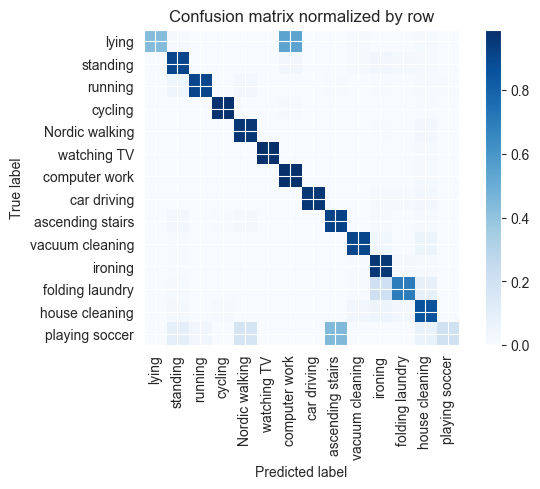

Training Epoch:  33%|███▎      | 5/15 [04:57<09:54, 59.47s/it]

Overall accuracy: 0.865

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.728      0.980      0.835      0.144        601|	 house cleaning: 0.013,	folding laundry: 0.002,	
         ironing       0.827      0.961      0.889      0.110        458|	 folding laundry: 0.020,	house cleaning: 0.009,	
  Nordic walking       0.940      0.964      0.952      0.094        393|	 house cleaning: 0.028,	ironing: 0.005,	
        standing       0.895      0.904      0.900      0.093        387|	 ironing: 0.034,	computer work: 0.031,	
           lying       1.000      0.432      0.603      0.092        382|	 computer work: 0.537,	house cleaning: 0.013,	
  house cleaning       0.787      0.858      0.821      0.086        358|	 ironing: 0.047,	vacuum cleaning: 0.034,	
 vacuum cleaning       0.927      0.903      0.915      0.081        339|	 house cleaning: 0.053,	ironing: 0.035,	
         cycling       0.986      0.979      0.982      


train: 100%|██████████| 262/262 [00:50<00:00,  5.16batch/s, loss=5.75, accuracy=0.969]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  8.95batch/s, loss=4.8]


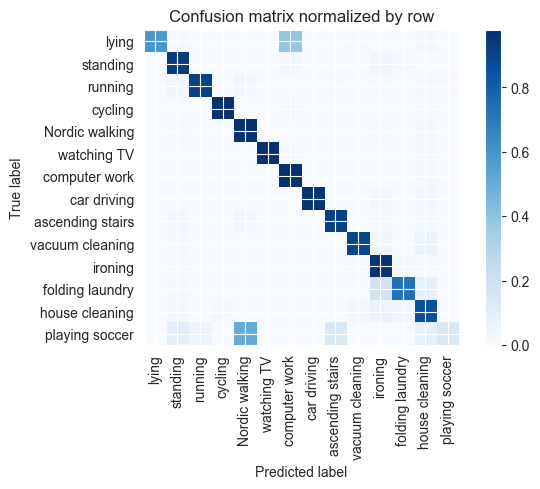

Training Epoch:  40%|████      | 6/15 [05:56<08:54, 59.34s/it]

Overall accuracy: 0.882

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.786      0.978      0.871      0.144        599|	 house cleaning: 0.015,	folding laundry: 0.003,	
         ironing       0.831      0.963      0.892      0.110        456|	 folding laundry: 0.020,	vacuum cleaning: 0.007,	
  Nordic walking       0.875      0.969      0.920      0.094        391|	 house cleaning: 0.020,	ironing: 0.005,	
        standing       0.890      0.936      0.912      0.093        388|	 ironing: 0.034,	computer work: 0.015,	
           lying       1.000      0.585      0.739      0.093        386|	 computer work: 0.386,	house cleaning: 0.016,	
  house cleaning       0.795      0.853      0.823      0.085        354|	 ironing: 0.054,	folding laundry: 0.031,	
 vacuum cleaning       0.953      0.893      0.922      0.081        338|	 house cleaning: 0.053,	ironing: 0.036,	
         cycling       0.986      0.979      0.982     


train: 100%|██████████| 262/262 [00:50<00:00,  5.23batch/s, loss=5.04, accuracy=0.953]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  9.08batch/s, loss=4.65]


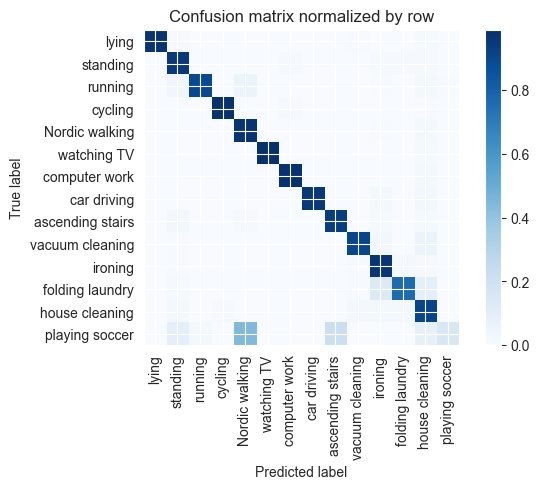

Training Epoch:  47%|████▋     | 7/15 [06:55<07:51, 59.00s/it]

Overall accuracy: 0.926

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.985      0.978      0.982      0.144        597|	 house cleaning: 0.017,	folding laundry: 0.003,	
         ironing       0.886      0.961      0.922      0.110        459|	 folding laundry: 0.020,	house cleaning: 0.009,	
  Nordic walking       0.882      0.972      0.925      0.095        394|	 house cleaning: 0.020,	ironing: 0.005,	
        standing       0.905      0.954      0.928      0.093        388|	 ironing: 0.013,	computer work: 0.013,	
           lying       1.000      0.969      0.984      0.093        387|	 house cleaning: 0.013,	standing: 0.010,	
  house cleaning       0.787      0.907      0.843      0.085        354|	 folding laundry: 0.023,	vacuum cleaning: 0.023,	
 vacuum cleaning       0.956      0.905      0.930      0.081        338|	 house cleaning: 0.053,	ironing: 0.030,	
         cycling       0.986      0.979      0.982   


train: 100%|██████████| 262/262 [00:50<00:00,  5.24batch/s, loss=5.27, accuracy=0.922]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  8.86batch/s, loss=5.03]


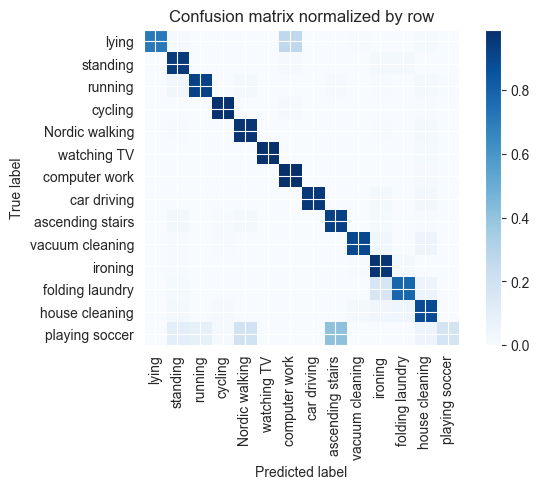

Training Epoch:  53%|█████▎    | 8/15 [07:53<06:51, 58.80s/it]

Overall accuracy: 0.903

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.845      0.987      0.910      0.144        601|	 house cleaning: 0.008,	folding laundry: 0.002,	
         ironing       0.859      0.969      0.911      0.110        458|	 folding laundry: 0.017,	vacuum cleaning: 0.007,	
  Nordic walking       0.943      0.969      0.956      0.094        391|	 house cleaning: 0.020,	ironing: 0.005,	
        standing       0.902      0.951      0.926      0.093        388|	 ironing: 0.021,	folding laundry: 0.015,	
           lying       1.000      0.706      0.828      0.093        385|	 computer work: 0.265,	house cleaning: 0.013,	
  house cleaning       0.835      0.882      0.858      0.086        356|	 folding laundry: 0.039,	ironing: 0.031,	
 vacuum cleaning       0.962      0.897      0.928      0.082        340|	 house cleaning: 0.050,	ironing: 0.038,	
         cycling       0.975      0.979      0.977   


train: 100%|██████████| 262/262 [00:50<00:00,  5.19batch/s, loss=5.56, accuracy=0.891]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  8.88batch/s, loss=2.97]


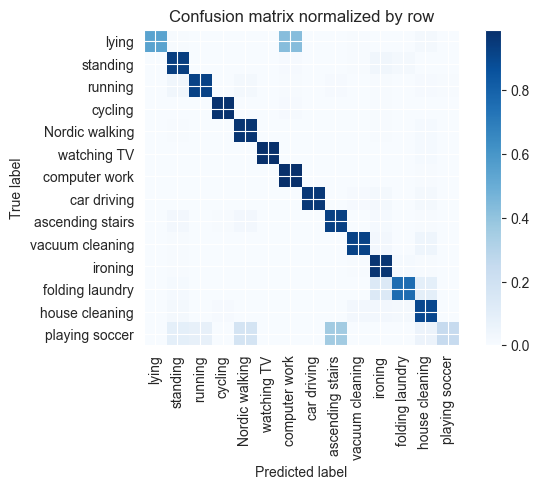

Training Epoch:  60%|██████    | 9/15 [08:52<05:52, 58.80s/it]

Overall accuracy: 0.891

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.774      0.990      0.869      0.144        598|	 house cleaning: 0.007,	folding laundry: 0.002,	
         ironing       0.869      0.969      0.916      0.110        458|	 folding laundry: 0.015,	vacuum cleaning: 0.007,	
  Nordic walking       0.943      0.970      0.956      0.095        394|	 house cleaning: 0.015,	standing: 0.008,	
        standing       0.902      0.935      0.919      0.093        386|	 ironing: 0.031,	folding laundry: 0.016,	
           lying       1.000      0.544      0.705      0.093        386|	 computer work: 0.427,	house cleaning: 0.016,	
  house cleaning       0.830      0.898      0.863      0.085        354|	 ironing: 0.025,	vacuum cleaning: 0.025,	
 vacuum cleaning       0.948      0.920      0.934      0.081        339|	 house cleaning: 0.044,	ironing: 0.024,	
         cycling       0.978      0.978      0.978  


train: 100%|██████████| 262/262 [00:50<00:00,  5.21batch/s, loss=4.2, accuracy=0.938]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  9.00batch/s, loss=3.53]


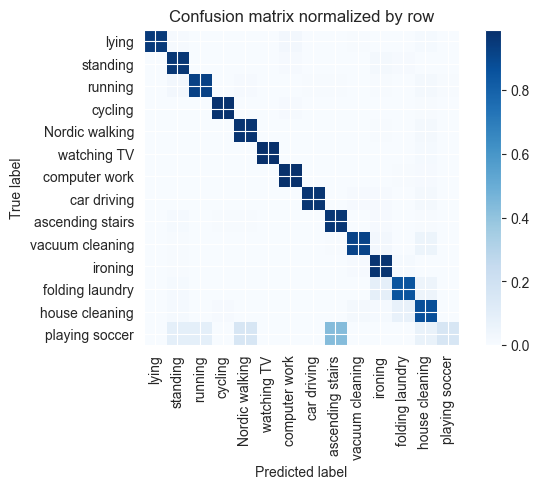

Training Epoch:  67%|██████▋   | 10/15 [09:50<04:53, 58.72s/it]

Overall accuracy: 0.931

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.974      0.983      0.978      0.144        601|	 house cleaning: 0.010,	folding laundry: 0.005,	
         ironing       0.907      0.971      0.938      0.109        454|	 folding laundry: 0.015,	vacuum cleaning: 0.009,	
  Nordic walking       0.957      0.969      0.963      0.094        392|	 house cleaning: 0.020,	ironing: 0.005,	
           lying       1.000      0.948      0.974      0.093        388|	 computer work: 0.026,	house cleaning: 0.013,	
        standing       0.918      0.959      0.938      0.093        387|	 ironing: 0.021,	folding laundry: 0.010,	
  house cleaning       0.828      0.870      0.849      0.085        355|	 folding laundry: 0.070,	vacuum cleaning: 0.020,	
 vacuum cleaning       0.957      0.911      0.933      0.081        338|	 house cleaning: 0.050,	ironing: 0.024,	
         cycling       0.979      0.979      


train: 100%|██████████| 262/262 [00:50<00:00,  5.20batch/s, loss=4.71, accuracy=0.875]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  8.57batch/s, loss=5.05]


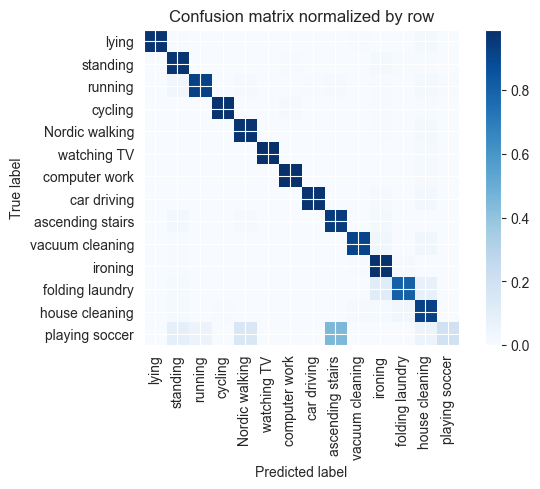

Training Epoch:  73%|███████▎  | 11/15 [10:49<03:55, 58.82s/it]

Overall accuracy: 0.937

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.990      0.985      0.987      0.144        597|	 house cleaning: 0.010,	folding laundry: 0.003,	
         ironing       0.885      0.978      0.929      0.110        457|	 folding laundry: 0.011,	vacuum cleaning: 0.007,	
  Nordic walking       0.955      0.972      0.963      0.094        392|	 house cleaning: 0.020,	ironing: 0.005,	
           lying       1.000      0.969      0.984      0.093        387|	 house cleaning: 0.016,	vacuum cleaning: 0.005,	
        standing       0.912      0.969      0.940      0.093        386|	 ironing: 0.016,	house cleaning: 0.005,	
  house cleaning       0.835      0.921      0.876      0.085        353|	 folding laundry: 0.031,	ironing: 0.014,	
 vacuum cleaning       0.972      0.909      0.939      0.082        341|	 house cleaning: 0.038,	ironing: 0.038,	
         cycling       0.989      0.975      0.982  


train: 100%|██████████| 262/262 [00:50<00:00,  5.19batch/s, loss=3.54, accuracy=0.969]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  8.70batch/s, loss=4.35]


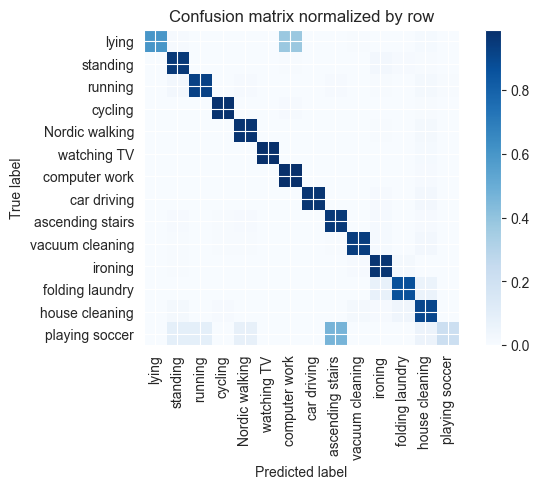

Training Epoch:  80%|████████  | 12/15 [11:49<02:56, 58.95s/it]

Overall accuracy: 0.904

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.797      0.985      0.881      0.144        601|	 house cleaning: 0.010,	folding laundry: 0.003,	
         ironing       0.915      0.967      0.940      0.110        456|	 folding laundry: 0.018,	vacuum cleaning: 0.009,	
  Nordic walking       0.967      0.972      0.969      0.094        391|	 house cleaning: 0.020,	ironing: 0.005,	
           lying       1.000      0.594      0.746      0.093        387|	 computer work: 0.377,	house cleaning: 0.013,	
        standing       0.922      0.953      0.937      0.092        384|	 ironing: 0.026,	folding laundry: 0.008,	
  house cleaning       0.841      0.902      0.870      0.086        357|	 folding laundry: 0.042,	vacuum cleaning: 0.020,	
 vacuum cleaning       0.957      0.934      0.945      0.080        334|	 house cleaning: 0.027,	ironing: 0.015,	
         cycling       0.979      0.979      


train: 100%|██████████| 262/262 [00:51<00:00,  5.10batch/s, loss=5.11, accuracy=0.812]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  8.86batch/s, loss=3.24]


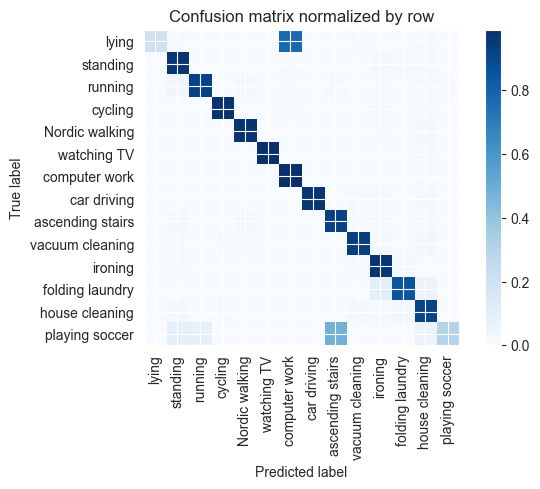

Training Epoch:  87%|████████▋ | 13/15 [12:48<01:58, 59.21s/it]

Overall accuracy: 0.869

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.662      0.990      0.793      0.144        601|	 house cleaning: 0.007,	folding laundry: 0.002,	
         ironing       0.906      0.965      0.934      0.110        458|	 folding laundry: 0.022,	vacuum cleaning: 0.007,	
  Nordic walking       0.977      0.972      0.974      0.094        389|	 house cleaning: 0.021,	ironing: 0.005,	
           lying       1.000      0.197      0.329      0.093        386|	 computer work: 0.775,	house cleaning: 0.013,	
        standing       0.921      0.964      0.942      0.093        385|	 ironing: 0.016,	house cleaning: 0.008,	
  house cleaning       0.849      0.915      0.881      0.085        355|	 folding laundry: 0.028,	vacuum cleaning: 0.020,	
 vacuum cleaning       0.958      0.935      0.946      0.081        338|	 house cleaning: 0.030,	ironing: 0.018,	
         cycling       0.986      0.975      0


train: 100%|██████████| 262/262 [00:51<00:00,  5.12batch/s, loss=3.68, accuracy=0.891]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  8.96batch/s, loss=3.61]


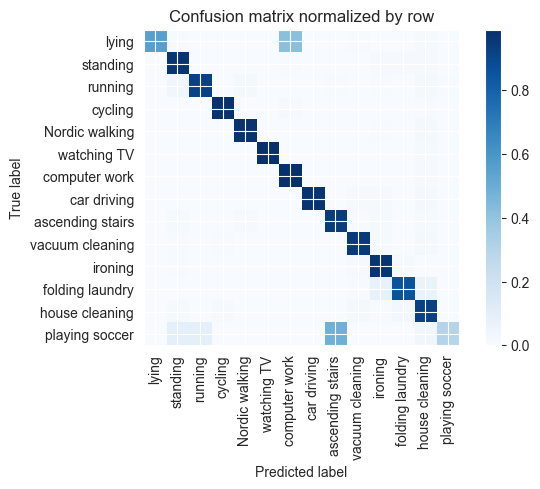

Training Epoch:  93%|█████████▎| 14/15 [13:48<00:59, 59.27s/it]

Overall accuracy: 0.907

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.782      0.988      0.873      0.145        602|	 house cleaning: 0.008,	folding laundry: 0.002,	
         ironing       0.931      0.971      0.951      0.109        455|	 folding laundry: 0.013,	vacuum cleaning: 0.009,	
  Nordic walking       0.984      0.974      0.979      0.094        389|	 house cleaning: 0.018,	ironing: 0.005,	
           lying       1.000      0.555      0.714      0.094        389|	 computer work: 0.414,	house cleaning: 0.015,	
        standing       0.926      0.969      0.947      0.093        385|	 house cleaning: 0.008,	folding laundry: 0.008,	
  house cleaning       0.854      0.924      0.887      0.085        354|	 folding laundry: 0.025,	vacuum cleaning: 0.020,	
 vacuum cleaning       0.950      0.953      0.951      0.081        338|	 house cleaning: 0.018,	ironing: 0.012,	
         cycling       0.982      0.97


train: 100%|██████████| 262/262 [00:51<00:00,  5.13batch/s, loss=3.3, accuracy=0.938]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:07<00:00,  8.67batch/s, loss=2.56]


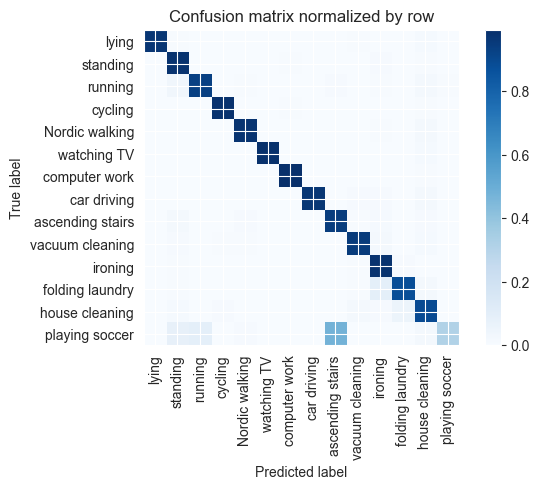

Overall accuracy: 0.947

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.992      0.993      0.992      0.143        595|	 house cleaning: 0.005,	standing: 0.002,	
         ironing       0.918      0.980      0.948      0.109        454|	 folding laundry: 0.009,	vacuum cleaning: 0.004,	
  Nordic walking       0.985      0.975      0.980      0.095        394|	 house cleaning: 0.018,	ironing: 0.005,	
           lying       1.000      0.969      0.984      0.094        391|	 house cleaning: 0.013,	vacuum cleaning: 0.005,	
        standing       0.922      0.979      0.950      0.093        386|	 ironing: 0.008,	house cleaning: 0.005,	
  house cleaning       0.890      0.890      0.890      0.086        356|	 folding laundry: 0.051,	vacuum cleaning: 0.022,	
 vacuum cleaning       0.955      0.950      0.952      0.081        337|	 ironing: 0.018,	house cleaning: 0.012,	
         cycling       0.982      0.982      0.982 

unseen: 100%|██████████| 86/86 [00:10<00:00,  8.29batch/s, loss=4.65]


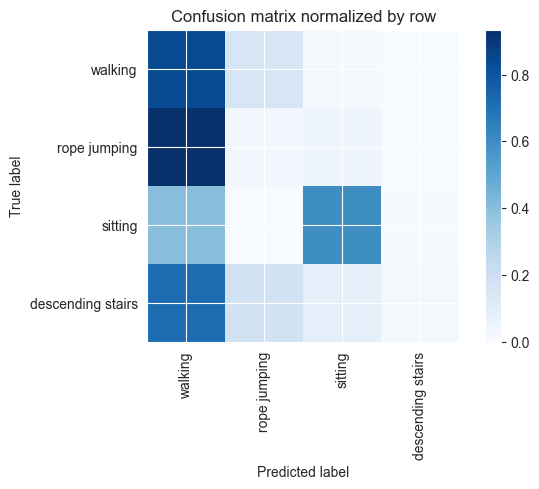

Overall accuracy: 0.552

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.518      0.839      0.640      0.422       2323|	 rope jumping: 0.149,	sitting: 0.009,	
          sitting       0.898      0.597      0.717      0.324       1782|	 walking: 0.399,	descending stairs: 0.004,	
descending stairs       0.467      0.015      0.029      0.171        942|	 walking: 0.719,	rope jumping: 0.180,	sitting: 0.086,	
     rope jumping       0.021      0.024      0.022      0.083        457|	 walking: 0.934,	sitting: 0.042,	

----------------------------------------------------------------------------------------------------
      avg / total       0.591      0.552      0.509        1.0       5504|	      

{'accuracy': 0.551780523255814, 'precision': 0.4757958701972723, 'recall': 0.36861351806411863, 'f1': 0.3520896206012226}
================ Fold-2 ================
Unseen Classes : ['playing soccer', 'lying', 'vacuum cleaning'

Training Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

torch.Size([14, 512])



train: 100%|██████████| 242/242 [00:47<00:00,  5.15batch/s, loss=6.85, accuracy=0.688]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:06<00:00,  8.70batch/s, loss=5.46]


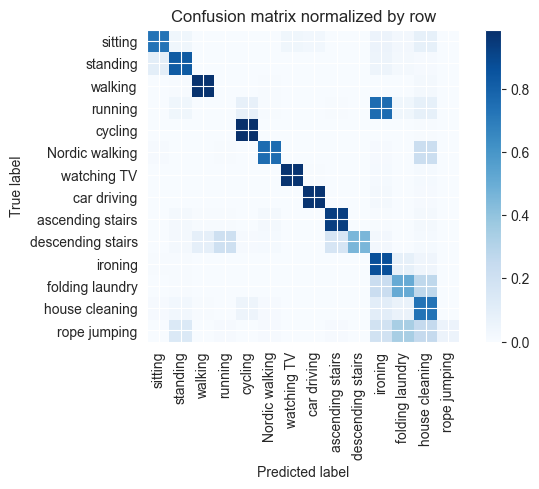

Training Epoch:   7%|▋         | 1/15 [00:55<12:50, 55.04s/it]

Overall accuracy: 0.758

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.960      0.972      0.966      0.129        494|	 house cleaning: 0.018,	Nordic walking: 0.006,	
          ironing       0.578      0.867      0.694      0.121        465|	 folding laundry: 0.084,	house cleaning: 0.039,	
   Nordic walking       0.948      0.758      0.842      0.101        388|	 house cleaning: 0.219,	sitting: 0.010,	
         standing       0.852      0.823      0.837      0.100        384|	 sitting: 0.099,	ironing: 0.049,	
   house cleaning       0.525      0.728      0.610      0.096        368|	 ironing: 0.103,	folding laundry: 0.065,	
          sitting       0.841      0.732      0.782      0.088        339|	 house cleaning: 0.083,	ironing: 0.056,	
          cycling       0.889      0.986      0.935      0.074        285|	 house cleaning: 0.007,	ironing: 0.004,	
descending stairs       1.000      0.456      0.627      0.05


train: 100%|██████████| 242/242 [00:47<00:00,  5.15batch/s, loss=6.36, accuracy=0.703]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:07<00:00,  8.29batch/s, loss=5.32]


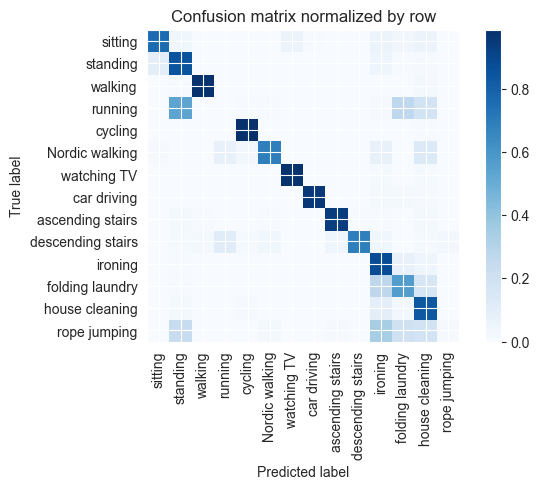

Training Epoch:  13%|█▎        | 2/15 [01:50<11:57, 55.21s/it]

Overall accuracy: 0.782

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.988      0.978      0.983      0.129        496|	 house cleaning: 0.016,	standing: 0.004,	
          ironing       0.679      0.877      0.765      0.121        465|	 folding laundry: 0.075,	house cleaning: 0.039,	
         standing       0.674      0.847      0.751      0.101        386|	 sitting: 0.096,	ironing: 0.044,	
   Nordic walking       0.953      0.682      0.795      0.100        384|	 house cleaning: 0.133,	ironing: 0.073,	
   house cleaning       0.616      0.835      0.709      0.096        369|	 ironing: 0.095,	folding laundry: 0.030,	
          sitting       0.856      0.762      0.806      0.087        336|	 house cleaning: 0.057,	watching TV: 0.057,	
          cycling       0.939      0.986      0.962      0.073        279|	 house cleaning: 0.007,	ironing: 0.004,	
descending stairs       0.993      0.684      0.810      0.051 


train: 100%|██████████| 242/242 [00:47<00:00,  5.14batch/s, loss=6.98, accuracy=0.891]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:06<00:00,  8.70batch/s, loss=6.02]


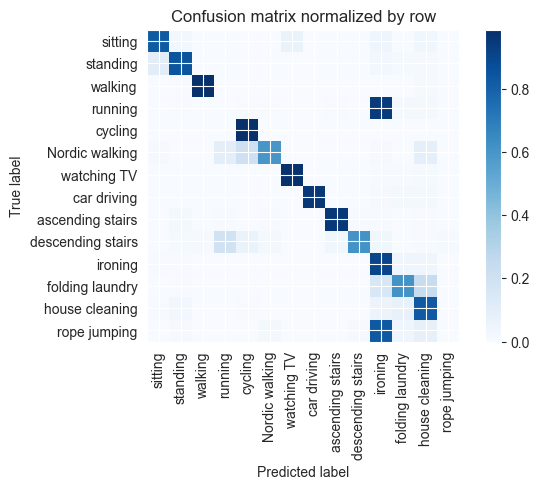

Training Epoch:  20%|██        | 3/15 [02:45<11:01, 55.09s/it]

Overall accuracy: 0.779

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.994      0.980      0.987      0.128        490|	 house cleaning: 0.012,	standing: 0.004,	
          ironing       0.553      0.904      0.686      0.122        468|	 house cleaning: 0.043,	folding laundry: 0.043,	
         standing       0.906      0.847      0.875      0.100        385|	 sitting: 0.101,	ironing: 0.029,	
   Nordic walking       0.954      0.594      0.732      0.100        384|	 cycling: 0.206,	running: 0.094,	
   house cleaning       0.688      0.826      0.751      0.096        368|	 folding laundry: 0.073,	ironing: 0.057,	
          sitting       0.853      0.823      0.838      0.088        339|	 watching TV: 0.062,	ironing: 0.041,	
          cycling       0.745      0.986      0.849      0.073        282|	 house cleaning: 0.004,	ironing: 0.004,	
descending stairs       0.976      0.610      0.751      0.052        200|	 r


train: 100%|██████████| 242/242 [00:48<00:00,  4.95batch/s, loss=5.79, accuracy=0.766]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:06<00:00,  9.06batch/s, loss=4.65]


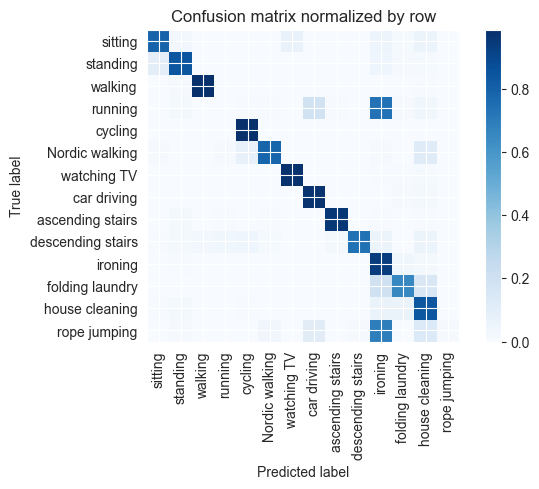

Training Epoch:  27%|██▋       | 4/15 [03:41<10:11, 55.63s/it]

Overall accuracy: 0.810

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.990      0.982      0.986      0.128        493|	 standing: 0.008,	house cleaning: 0.006,	
          ironing       0.580      0.937      0.717      0.120        460|	 folding laundry: 0.035,	house cleaning: 0.020,	
   Nordic walking       0.965      0.782      0.864      0.101        386|	 house cleaning: 0.119,	cycling: 0.073,	
         standing       0.900      0.842      0.870      0.100        385|	 sitting: 0.094,	ironing: 0.044,	
   house cleaning       0.681      0.837      0.751      0.096        368|	 folding laundry: 0.062,	ironing: 0.062,	
          sitting       0.855      0.792      0.822      0.087        336|	 watching TV: 0.065,	house cleaning: 0.054,	
          cycling       0.877      0.986      0.928      0.074        283|	 house cleaning: 0.004,	ironing: 0.004,	
descending stairs       0.993      0.739      0.847      0.052 


train: 100%|██████████| 242/242 [00:47<00:00,  5.15batch/s, loss=5.28, accuracy=0.812]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:06<00:00,  9.05batch/s, loss=5.54]


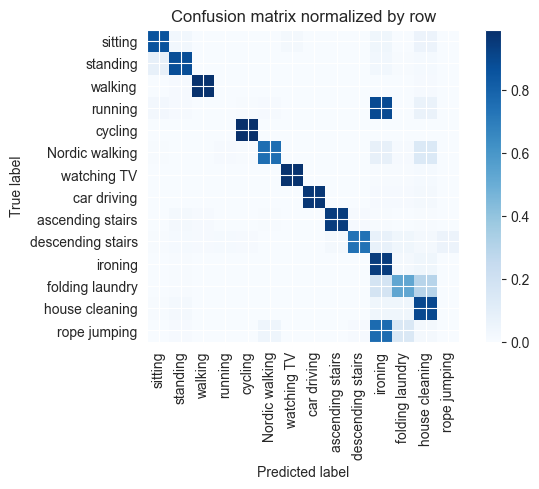

Training Epoch:  33%|███▎      | 5/15 [04:36<09:12, 55.30s/it]

Overall accuracy: 0.814

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.990      0.982      0.986      0.128        490|	 house cleaning: 0.008,	standing: 0.008,	
          ironing       0.547      0.941      0.692      0.120        461|	 house cleaning: 0.037,	folding laundry: 0.017,	
         standing       0.909      0.874      0.891      0.101        388|	 sitting: 0.080,	ironing: 0.028,	
   Nordic walking       0.973      0.751      0.848      0.099        382|	 house cleaning: 0.136,	ironing: 0.081,	
   house cleaning       0.653      0.895      0.755      0.096        370|	 folding laundry: 0.038,	ironing: 0.038,	
          sitting       0.873      0.855      0.864      0.088        338|	 house cleaning: 0.056,	ironing: 0.038,	
          cycling       0.979      0.989      0.984      0.074        284|	 house cleaning: 0.004,	ironing: 0.004,	
descending stairs       0.980      0.737      0.841      0.052     


train: 100%|██████████| 242/242 [00:46<00:00,  5.17batch/s, loss=6.29, accuracy=0.75]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:06<00:00,  8.93batch/s, loss=3.98]


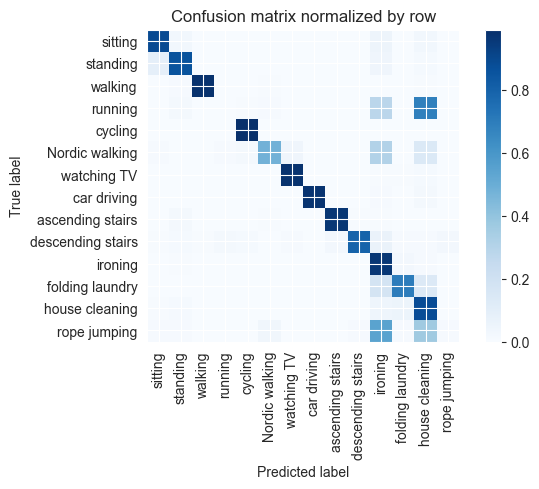

Training Epoch:  40%|████      | 6/15 [05:31<08:15, 55.05s/it]

Overall accuracy: 0.802

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.998      0.982      0.990      0.127        489|	 standing: 0.008,	house cleaning: 0.006,	
          ironing       0.583      0.959      0.725      0.121        466|	 folding laundry: 0.026,	house cleaning: 0.009,	
   Nordic walking       0.958      0.479      0.639      0.100        384|	 ironing: 0.307,	house cleaning: 0.138,	
         standing       0.909      0.857      0.882      0.100        384|	 sitting: 0.086,	ironing: 0.042,	
   house cleaning       0.544      0.880      0.672      0.096        367|	 folding laundry: 0.052,	ironing: 0.046,	
          sitting       0.875      0.888      0.882      0.089        340|	 ironing: 0.050,	house cleaning: 0.029,	
          cycling       0.962      0.989      0.976      0.074        284|	 house cleaning: 0.004,	ironing: 0.004,	
descending stairs       0.988      0.794      0.880      0.052     


train: 100%|██████████| 242/242 [00:47<00:00,  5.11batch/s, loss=4.68, accuracy=0.797]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:06<00:00,  8.82batch/s, loss=2.94]


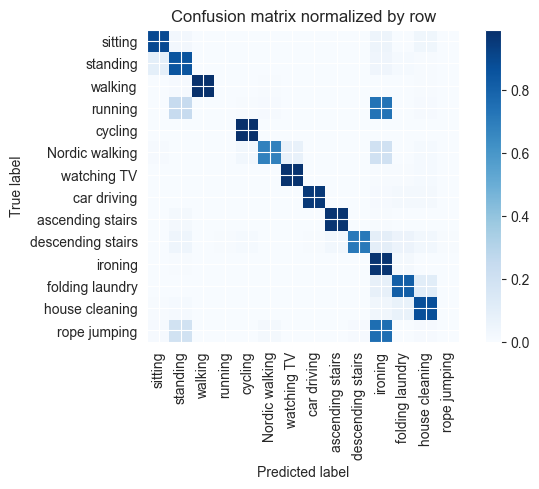

Training Epoch:  47%|████▋     | 7/15 [06:27<07:22, 55.35s/it]

Overall accuracy: 0.826

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.998      0.984      0.991      0.129        495|	 standing: 0.008,	house cleaning: 0.004,	
          ironing       0.558      0.972      0.709      0.122        468|	 folding laundry: 0.019,	standing: 0.004,	
         standing       0.776      0.850      0.811      0.101        387|	 sitting: 0.090,	ironing: 0.041,	
   Nordic walking       0.974      0.679      0.800      0.101        386|	 ironing: 0.197,	watching TV: 0.073,	
   house cleaning       0.851      0.872      0.862      0.096        368|	 folding laundry: 0.068,	ironing: 0.033,	
          sitting       0.872      0.891      0.881      0.088        338|	 ironing: 0.047,	house cleaning: 0.036,	
          cycling       0.946      0.989      0.967      0.073        282|	 house cleaning: 0.004,	ironing: 0.004,	
descending stairs       0.993      0.711      0.828      0.051        197|	 


train: 100%|██████████| 242/242 [00:46<00:00,  5.19batch/s, loss=5.55, accuracy=0.828]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:06<00:00,  8.70batch/s, loss=4.2]


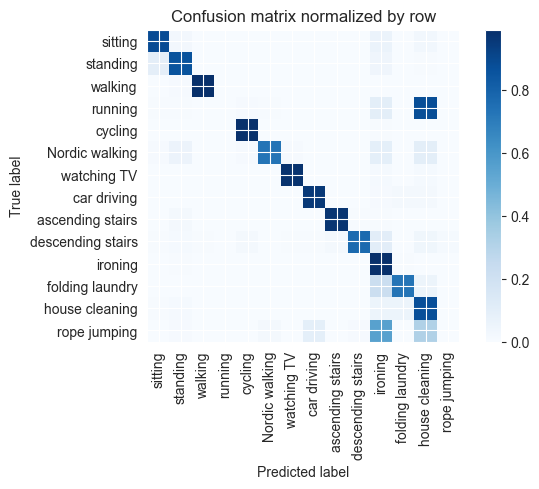

Training Epoch:  53%|█████▎    | 8/15 [07:21<06:26, 55.23s/it]

Overall accuracy: 0.829

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.998      0.990      0.994      0.128        490|	 standing: 0.008,	Nordic walking: 0.002,	
          ironing       0.672      0.989      0.800      0.122        467|	 folding laundry: 0.004,	standing: 0.004,	
         standing       0.866      0.855      0.861      0.101        387|	 sitting: 0.096,	ironing: 0.041,	
   Nordic walking       0.986      0.728      0.838      0.101        386|	 house cleaning: 0.098,	ironing: 0.091,	
   house cleaning       0.544      0.871      0.669      0.097        371|	 folding laundry: 0.054,	ironing: 0.054,	
          sitting       0.869      0.884      0.876      0.088        337|	 ironing: 0.059,	house cleaning: 0.030,	
          cycling       0.965      0.986      0.975      0.073        282|	 ironing: 0.007,	house cleaning: 0.004,	
descending stairs       0.987      0.769      0.865      0.051        195


train: 100%|██████████| 242/242 [00:46<00:00,  5.19batch/s, loss=5.34, accuracy=0.766]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:07<00:00,  8.36batch/s, loss=4.05]


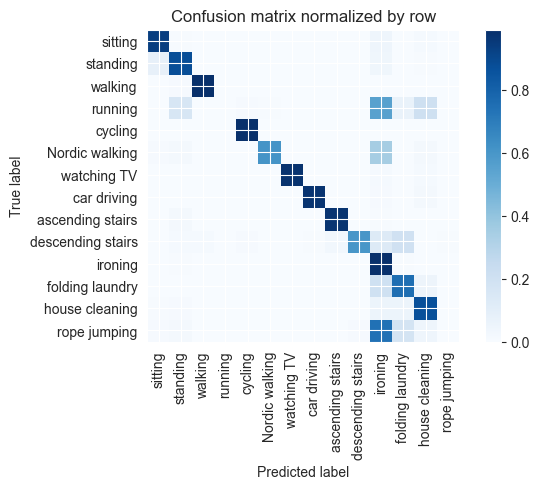

Training Epoch:  60%|██████    | 9/15 [08:16<05:30, 55.14s/it]

Overall accuracy: 0.818

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.992      0.990      0.991      0.128        493|	 standing: 0.008,	Nordic walking: 0.002,	
          ironing       0.524      0.989      0.685      0.122        467|	 folding laundry: 0.004,	standing: 0.004,	
   Nordic walking       0.987      0.608      0.752      0.100        385|	 ironing: 0.345,	house cleaning: 0.021,	
         standing       0.853      0.878      0.865      0.100        384|	 sitting: 0.081,	ironing: 0.036,	
   house cleaning       0.815      0.868      0.840      0.096        370|	 ironing: 0.054,	folding laundry: 0.051,	
          sitting       0.891      0.935      0.912      0.089        340|	 ironing: 0.044,	house cleaning: 0.015,	
          cycling       0.982      0.989      0.986      0.074        283|	 house cleaning: 0.004,	ironing: 0.004,	
descending stairs       0.992      0.598      0.746      0.052        199


train: 100%|██████████| 242/242 [00:46<00:00,  5.15batch/s, loss=3.37, accuracy=0.828]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:07<00:00,  8.41batch/s, loss=5.54]


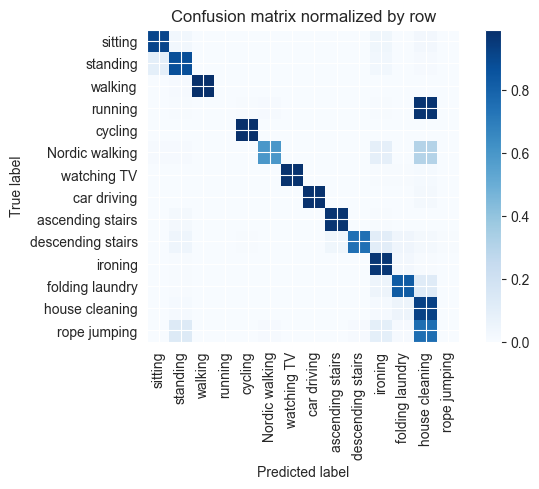

Training Epoch:  67%|██████▋   | 10/15 [09:12<04:35, 55.15s/it]

Overall accuracy: 0.827

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       1.000      0.988      0.994      0.128        491|	 standing: 0.008,	descending stairs: 0.002,	
          ironing       0.815      0.966      0.884      0.121        466|	 folding laundry: 0.024,	house cleaning: 0.004,	
   Nordic walking       0.983      0.592      0.739      0.101        387|	 house cleaning: 0.302,	ironing: 0.085,	
         standing       0.869      0.871      0.870      0.101        387|	 sitting: 0.090,	ironing: 0.028,	
   house cleaning       0.449      0.921      0.603      0.095        366|	 folding laundry: 0.046,	ironing: 0.014,	
          sitting       0.880      0.906      0.893      0.089        341|	 ironing: 0.035,	standing: 0.029,	
          cycling       0.989      0.989      0.989      0.074        284|	 house cleaning: 0.004,	ironing: 0.004,	
descending stairs       0.986      0.745      0.849      0.051        


train: 100%|██████████| 242/242 [00:47<00:00,  5.12batch/s, loss=4.74, accuracy=0.797]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:06<00:00,  9.13batch/s, loss=3.66]


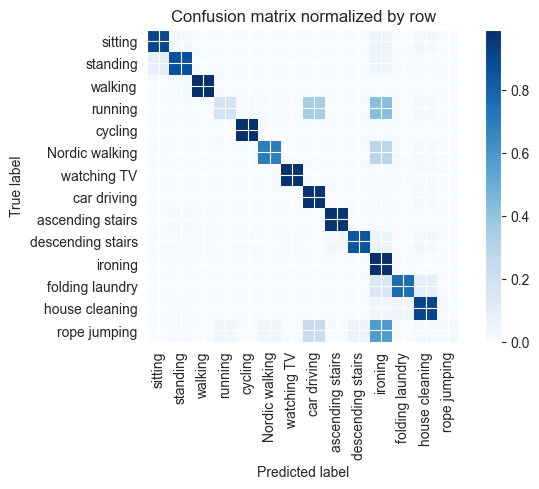

Training Epoch:  73%|███████▎  | 11/15 [10:07<03:40, 55.08s/it]

Overall accuracy: 0.848

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.992      0.990      0.991      0.128        492|	 standing: 0.008,	Nordic walking: 0.002,	
          ironing       0.585      0.989      0.735      0.122        467|	 folding laundry: 0.004,	standing: 0.004,	
   Nordic walking       0.982      0.695      0.814      0.101        387|	 ironing: 0.282,	house cleaning: 0.018,	
         standing       0.920      0.866      0.892      0.101        387|	 sitting: 0.080,	ironing: 0.044,	
   house cleaning       0.863      0.905      0.884      0.096        370|	 folding laundry: 0.041,	ironing: 0.032,	
          sitting       0.896      0.902      0.899      0.087        336|	 ironing: 0.048,	standing: 0.027,	
          cycling       0.986      0.989      0.988      0.074        283|	 ironing: 0.007,	house cleaning: 0.004,	
descending stairs       0.971      0.848      0.905      0.051        197|	 iro


train: 100%|██████████| 242/242 [00:47<00:00,  5.10batch/s, loss=4.38, accuracy=0.828]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:06<00:00,  8.84batch/s, loss=1.89]


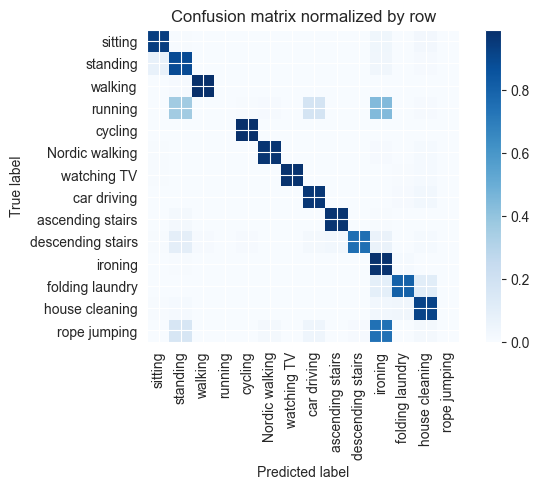

Training Epoch:  80%|████████  | 12/15 [11:02<02:45, 55.20s/it]

Overall accuracy: 0.868

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.996      0.990      0.993      0.129        496|	 standing: 0.008,	Nordic walking: 0.002,	
          ironing       0.676      0.979      0.800      0.122        469|	 folding laundry: 0.015,	standing: 0.004,	
         standing       0.739      0.885      0.806      0.100        384|	 sitting: 0.076,	ironing: 0.031,	
   Nordic walking       0.987      0.969      0.977      0.099        381|	 house cleaning: 0.013,	ironing: 0.010,	
   house cleaning       0.872      0.916      0.894      0.097        371|	 folding laundry: 0.032,	ironing: 0.030,	
          sitting       0.897      0.935      0.916      0.088        337|	 ironing: 0.036,	house cleaning: 0.024,	
          cycling       0.986      0.989      0.988      0.073        281|	 house cleaning: 0.004,	ironing: 0.004,	
descending stairs       0.993      0.747      0.853      0.052        198


train: 100%|██████████| 242/242 [00:47<00:00,  5.11batch/s, loss=4.15, accuracy=0.812]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:06<00:00,  8.96batch/s, loss=4.1]


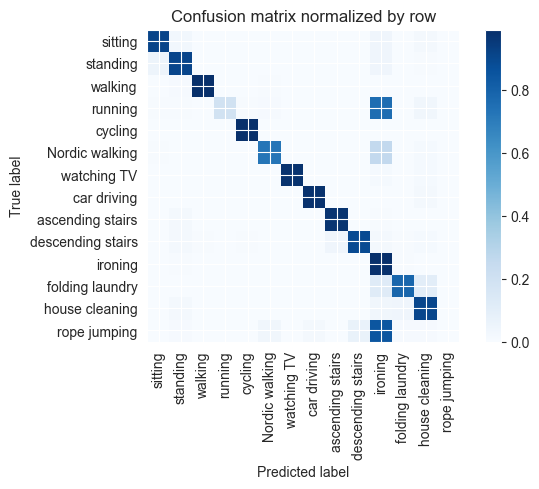

Training Epoch:  87%|████████▋ | 13/15 [11:57<01:50, 55.19s/it]

Overall accuracy: 0.859

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.998      0.988      0.993      0.128        493|	 standing: 0.008,	Nordic walking: 0.004,	
          ironing       0.538      0.987      0.696      0.120        460|	 standing: 0.007,	folding laundry: 0.004,	
         standing       0.911      0.907      0.909      0.101        386|	 sitting: 0.047,	ironing: 0.039,	
   Nordic walking       0.975      0.726      0.832      0.100        383|	 ironing: 0.256,	house cleaning: 0.013,	
   house cleaning       0.872      0.903      0.887      0.097        371|	 folding laundry: 0.040,	ironing: 0.032,	
          sitting       0.931      0.909      0.920      0.089        342|	 ironing: 0.041,	standing: 0.029,	
          cycling       0.989      0.989      0.989      0.074        283|	 house cleaning: 0.004,	ironing: 0.004,	
descending stairs       0.967      0.888      0.926      0.051        196|	 asc


train: 100%|██████████| 242/242 [00:47<00:00,  5.10batch/s, loss=3.89, accuracy=0.844]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:06<00:00,  9.26batch/s, loss=3.24]


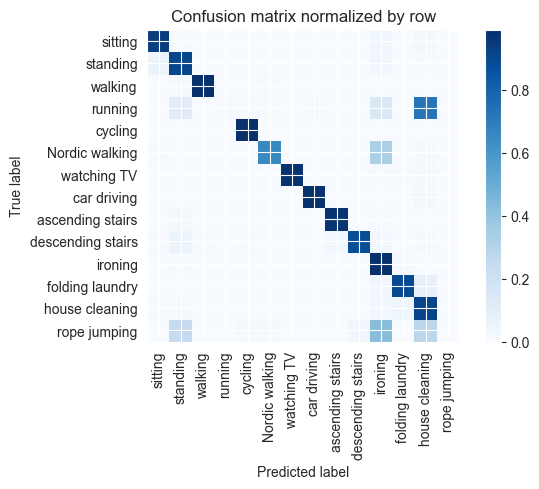

Training Epoch:  93%|█████████▎| 14/15 [12:52<00:55, 55.15s/it]

Overall accuracy: 0.849

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.998      0.988      0.993      0.128        493|	 standing: 0.008,	Nordic walking: 0.004,	
          ironing       0.655      0.983      0.786      0.121        465|	 folding laundry: 0.011,	standing: 0.004,	
         standing       0.833      0.902      0.866      0.101        387|	 sitting: 0.059,	ironing: 0.031,	
   Nordic walking       0.984      0.650      0.783      0.100        383|	 ironing: 0.332,	house cleaning: 0.013,	
   house cleaning       0.627      0.911      0.743      0.096        369|	 folding laundry: 0.041,	ironing: 0.027,	
          sitting       0.916      0.938      0.927      0.088        339|	 ironing: 0.038,	house cleaning: 0.018,	
          cycling       0.989      0.989      0.989      0.073        281|	 house cleaning: 0.004,	ironing: 0.004,	
descending stairs       0.983      0.874      0.925      0.052        198


train: 100%|██████████| 242/242 [00:47<00:00,  5.07batch/s, loss=3.68, accuracy=0.844]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:06<00:00,  8.65batch/s, loss=2.83]


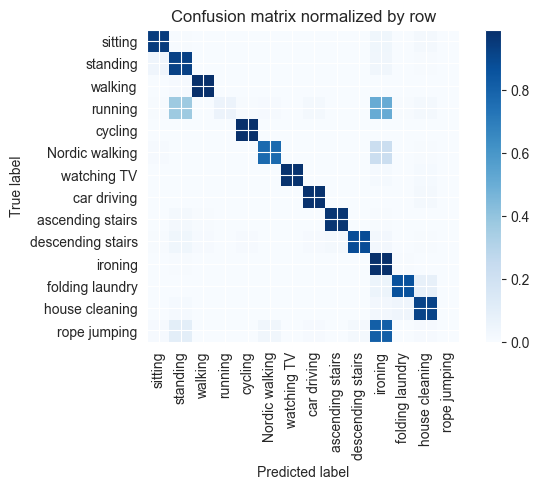

Overall accuracy: 0.866

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.994      0.990      0.992      0.128        491|	 standing: 0.008,	Nordic walking: 0.002,	
          ironing       0.601      0.989      0.748      0.121        466|	 folding laundry: 0.006,	standing: 0.004,	
   Nordic walking       0.980      0.768      0.861      0.100        383|	 ironing: 0.217,	sitting: 0.010,	
         standing       0.772      0.922      0.840      0.100        383|	 sitting: 0.042,	ironing: 0.031,	
   house cleaning       0.904      0.914      0.909      0.096        370|	 folding laundry: 0.041,	ironing: 0.027,	
          sitting       0.927      0.941      0.934      0.088        338|	 ironing: 0.036,	house cleaning: 0.018,	
          cycling       0.986      0.989      0.988      0.074        284|	 house cleaning: 0.004,	ironing: 0.004,	
descending stairs       0.989      0.879      0.931      0.052        199|	 stan

unseen: 100%|██████████| 111/111 [00:11<00:00,  9.89batch/s, loss=4.16]


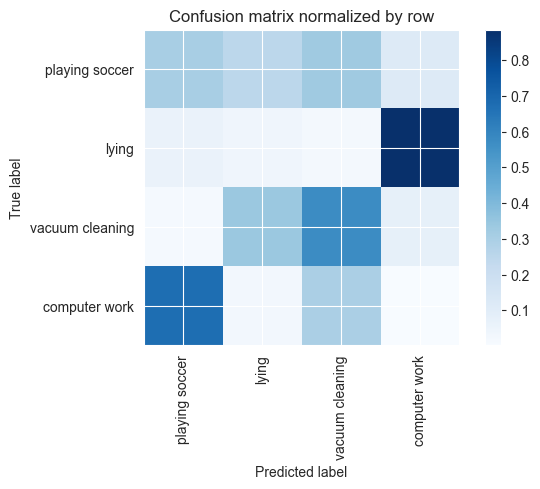

Overall accuracy: 0.168

                  precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

  computer work       0.003      0.002      0.002      0.431       3065|	 playing soccer: 0.675,	vacuum cleaning: 0.298,	lying: 0.026,	
          lying       0.086      0.038      0.053      0.264       1876|	 computer work: 0.885,	playing soccer: 0.059,	
vacuum cleaning       0.472      0.572      0.517      0.240       1707|	 lying: 0.338,	computer work: 0.077,	
 playing soccer       0.059      0.305      0.099      0.064        456|	 vacuum cleaning: 0.329,	lying: 0.248,	

----------------------------------------------------------------------------------------------------
    avg / total       0.141      0.168      0.146        1.0       7104|	      

{'accuracy': 0.16793355855855857, 'precision': 0.15481608809343425, 'recall': 0.22929614106179877, 'f1': 0.16789118178742354}
================ Fold-3 ================
Unseen Classes : ['cycling', 'running', 'Nordic walkin

Training Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

torch.Size([15, 512])



train: 100%|██████████| 276/276 [00:52<00:00,  5.27batch/s, loss=7.11, accuracy=0.75]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:07<00:00,  9.17batch/s, loss=6.84]


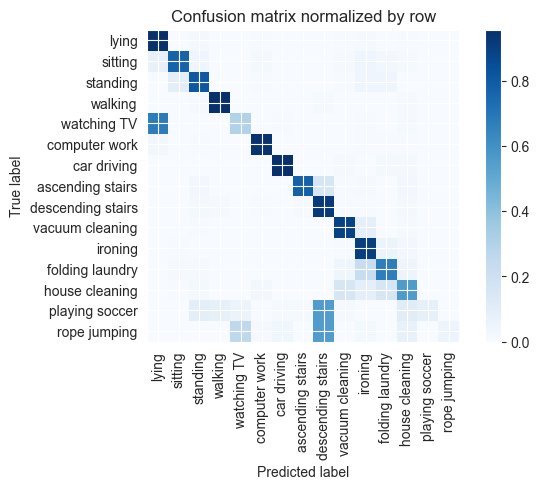

Training Epoch:   7%|▋         | 1/15 [01:01<14:15, 61.10s/it]

Overall accuracy: 0.802

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.962      0.945      0.954      0.135        597|	 lying: 0.028,	standing: 0.007,	
          ironing       0.754      0.907      0.823      0.109        483|	 folding laundry: 0.058,	house cleaning: 0.023,	
          walking       0.980      0.957      0.969      0.106        468|	 descending stairs: 0.015,	house cleaning: 0.011,	
            lying       0.712      0.958      0.817      0.091        400|	 standing: 0.015,	ironing: 0.007,	
          sitting       0.866      0.770      0.815      0.082        361|	 lying: 0.072,	ironing: 0.044,	
         standing       0.835      0.811      0.823      0.080        355|	 sitting: 0.093,	folding laundry: 0.042,	
   house cleaning       0.732      0.559      0.634      0.079        347|	 folding laundry: 0.153,	vacuum cleaning: 0.150,	
  vacuum cleaning       0.799      0.890      0.842      0.078   


train: 100%|██████████| 276/276 [00:54<00:00,  5.08batch/s, loss=6.19, accuracy=0.859]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:07<00:00,  9.02batch/s, loss=6.82]


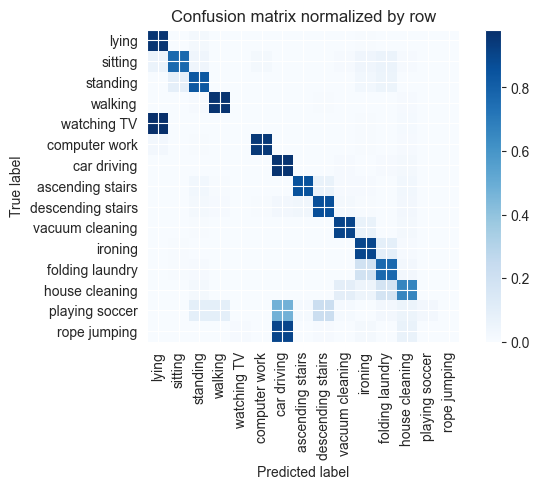

Training Epoch:  13%|█▎        | 2/15 [02:04<13:29, 62.30s/it]

Overall accuracy: 0.804

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.983      0.947      0.964      0.136        599|	 lying: 0.027,	house cleaning: 0.010,	
          ironing       0.793      0.896      0.842      0.109        483|	 folding laundry: 0.089,	house cleaning: 0.008,	
          walking       0.976      0.966      0.971      0.106        469|	 house cleaning: 0.011,	standing: 0.011,	
            lying       0.661      0.960      0.783      0.091        400|	 standing: 0.020,	ironing: 0.007,	
          sitting       0.884      0.763      0.819      0.081        359|	 lying: 0.061,	folding laundry: 0.058,	
         standing       0.833      0.828      0.831      0.080        355|	 sitting: 0.085,	folding laundry: 0.054,	
   house cleaning       0.798      0.658      0.721      0.079        348|	 folding laundry: 0.170,	vacuum cleaning: 0.095,	
  vacuum cleaning       0.864      0.901      0.882      0.0


train: 100%|██████████| 276/276 [00:54<00:00,  5.09batch/s, loss=5.87, accuracy=0.703]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:07<00:00,  8.98batch/s, loss=5.5]


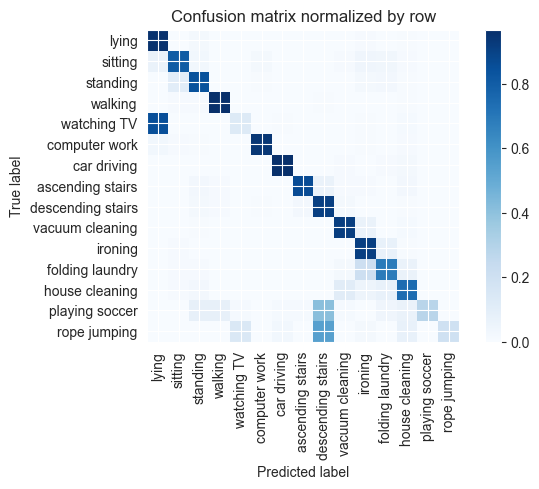

Training Epoch:  20%|██        | 3/15 [03:07<12:33, 62.78s/it]

Overall accuracy: 0.829

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.984      0.938      0.961      0.136        600|	 lying: 0.028,	house cleaning: 0.010,	
          ironing       0.797      0.909      0.849      0.109        481|	 folding laundry: 0.071,	sitting: 0.010,	
          walking       0.976      0.968      0.972      0.106        467|	 standing: 0.009,	sitting: 0.009,	
            lying       0.683      0.958      0.798      0.091        401|	 standing: 0.020,	ironing: 0.010,	
          sitting       0.835      0.803      0.819      0.082        360|	 lying: 0.061,	ironing: 0.039,	
         standing       0.844      0.839      0.842      0.080        355|	 sitting: 0.101,	folding laundry: 0.025,	
   house cleaning       0.811      0.741      0.775      0.079        348|	 vacuum cleaning: 0.109,	folding laundry: 0.069,	
  vacuum cleaning       0.841      0.913      0.876      0.078        343|	 ironin


train: 100%|██████████| 276/276 [00:54<00:00,  5.04batch/s, loss=7.54, accuracy=0.828]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:07<00:00,  9.14batch/s, loss=6]  


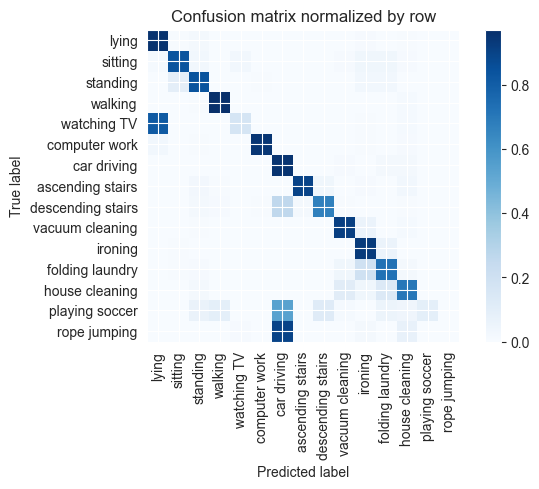

Training Epoch:  27%|██▋       | 4/15 [04:11<11:33, 63.04s/it]

Overall accuracy: 0.820

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.947      0.970      0.136        601|	 lying: 0.028,	house cleaning: 0.010,	
          ironing       0.809      0.928      0.864      0.110        484|	 folding laundry: 0.060,	sitting: 0.006,	
          walking       0.976      0.972      0.974      0.106        468|	 house cleaning: 0.013,	standing: 0.006,	
            lying       0.712      0.958      0.817      0.091        401|	 standing: 0.017,	ironing: 0.010,	
          sitting       0.883      0.839      0.860      0.082        360|	 folding laundry: 0.036,	ironing: 0.036,	
         standing       0.858      0.841      0.850      0.080        353|	 sitting: 0.093,	folding laundry: 0.028,	
   house cleaning       0.827      0.705      0.761      0.078        346|	 folding laundry: 0.130,	vacuum cleaning: 0.107,	
  vacuum cleaning       0.848      0.915      0.880      0.077   


train: 100%|██████████| 276/276 [00:55<00:00,  4.95batch/s, loss=7.07, accuracy=0.797]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:07<00:00,  9.23batch/s, loss=4.24]


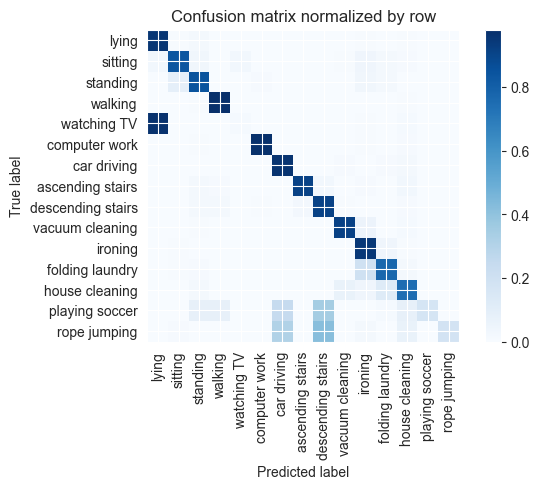

Training Epoch:  33%|███▎      | 5/15 [05:15<10:35, 63.53s/it]

Overall accuracy: 0.843

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.990      0.975      0.982      0.136        600|	 house cleaning: 0.010,	ironing: 0.005,	
          ironing       0.809      0.946      0.872      0.110        484|	 folding laundry: 0.039,	sitting: 0.006,	
          walking       0.972      0.981      0.977      0.106        467|	 standing: 0.006,	house cleaning: 0.004,	
            lying       0.694      0.958      0.805      0.091        401|	 standing: 0.020,	ironing: 0.007,	
          sitting       0.885      0.836      0.860      0.082        360|	 ironing: 0.039,	standing: 0.033,	
         standing       0.853      0.850      0.851      0.080        354|	 sitting: 0.085,	ironing: 0.034,	
   house cleaning       0.844      0.749      0.794      0.079        347|	 folding laundry: 0.121,	vacuum cleaning: 0.066,	
  vacuum cleaning       0.908      0.915      0.911      0.078        343|	 ir


train: 100%|██████████| 276/276 [00:55<00:00,  4.97batch/s, loss=4.7, accuracy=0.844]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:07<00:00,  9.15batch/s, loss=5.14]


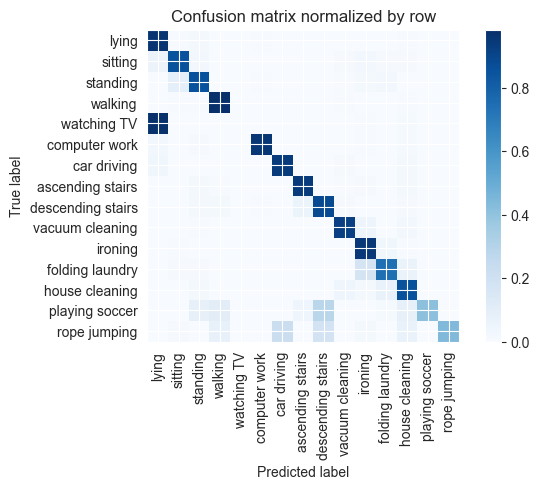

Training Epoch:  40%|████      | 6/15 [06:19<09:34, 63.79s/it]

Overall accuracy: 0.858

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.990      0.952      0.970      0.136        601|	 lying: 0.023,	house cleaning: 0.012,	
          ironing       0.847      0.948      0.895      0.109        483|	 folding laundry: 0.037,	sitting: 0.006,	
          walking       0.956      0.977      0.966      0.106        470|	 standing: 0.006,	house cleaning: 0.004,	
            lying       0.657      0.960      0.780      0.090        398|	 standing: 0.018,	computer work: 0.008,	
          sitting       0.881      0.859      0.870      0.082        361|	 lying: 0.055,	ironing: 0.028,	
         standing       0.853      0.856      0.854      0.080        353|	 sitting: 0.088,	folding laundry: 0.025,	
   house cleaning       0.831      0.853      0.842      0.079        347|	 folding laundry: 0.066,	vacuum cleaning: 0.040,	
  vacuum cleaning       0.919      0.919      0.919      0.078       


train: 100%|██████████| 276/276 [00:55<00:00,  4.99batch/s, loss=4.75, accuracy=0.906]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:07<00:00,  9.17batch/s, loss=4.57]


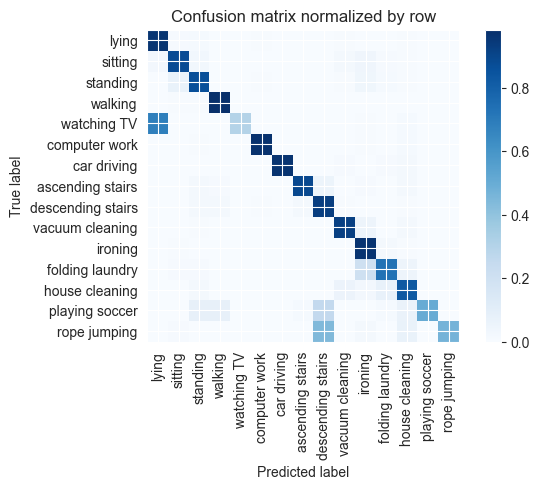

Training Epoch:  47%|████▋     | 7/15 [07:23<08:30, 63.85s/it]

Overall accuracy: 0.878

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.992      0.975      0.983      0.136        599|	 house cleaning: 0.012,	ironing: 0.005,	
          ironing       0.826      0.965      0.890      0.109        481|	 folding laundry: 0.021,	sitting: 0.006,	
          walking       0.975      0.983      0.979      0.107        471|	 standing: 0.004,	sitting: 0.004,	
            lying       0.761      0.962      0.850      0.090        398|	 standing: 0.013,	sitting: 0.010,	
          sitting       0.893      0.876      0.884      0.082        362|	 ironing: 0.039,	standing: 0.028,	
         standing       0.869      0.864      0.867      0.080        354|	 sitting: 0.068,	ironing: 0.037,	
   house cleaning       0.841      0.827      0.834      0.078        346|	 folding laundry: 0.075,	vacuum cleaning: 0.055,	
  vacuum cleaning       0.903      0.922      0.912      0.078        344|	 ironing: 


train: 100%|██████████| 276/276 [00:55<00:00,  4.98batch/s, loss=5.3, accuracy=0.922]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:07<00:00,  9.08batch/s, loss=4.03]


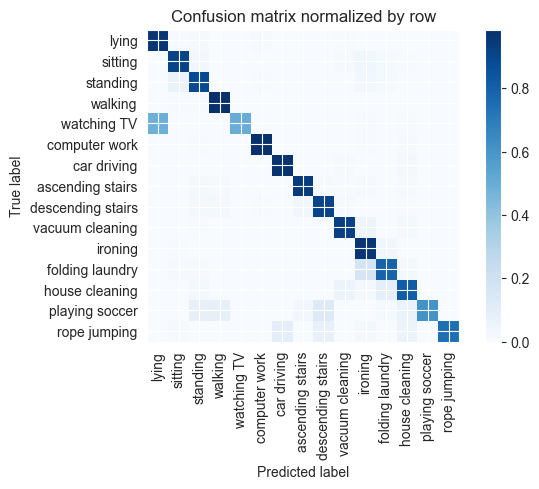

Training Epoch:  53%|█████▎    | 8/15 [08:27<07:27, 63.97s/it]

Overall accuracy: 0.902

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.988      0.978      0.983      0.136        599|	 house cleaning: 0.010,	ironing: 0.005,	
          ironing       0.844      0.959      0.897      0.110        484|	 folding laundry: 0.031,	sitting: 0.006,	
          walking       0.975      0.985      0.980      0.106        469|	 sitting: 0.006,	standing: 0.004,	
            lying       0.827      0.960      0.888      0.090        398|	 standing: 0.015,	computer work: 0.010,	
          sitting       0.906      0.909      0.908      0.082        362|	 ironing: 0.036,	standing: 0.028,	
         standing       0.870      0.887      0.878      0.080        354|	 sitting: 0.062,	ironing: 0.028,	
   house cleaning       0.884      0.813      0.847      0.079        348|	 folding laundry: 0.092,	vacuum cleaning: 0.055,	
  vacuum cleaning       0.908      0.922      0.915      0.078        344|	 iro


train: 100%|██████████| 276/276 [00:54<00:00,  5.03batch/s, loss=4.94, accuracy=0.891]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:07<00:00,  9.21batch/s, loss=3.32]


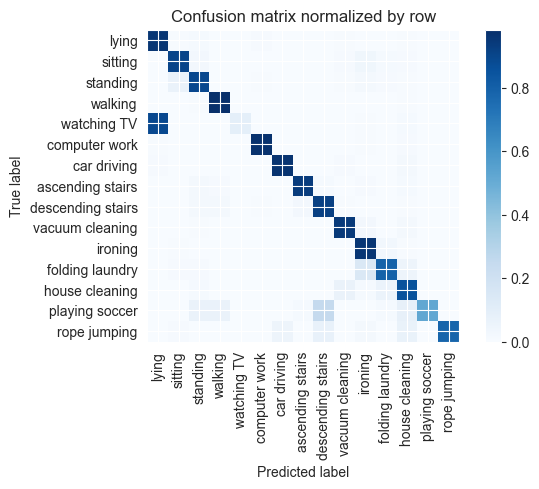

Training Epoch:  60%|██████    | 9/15 [09:31<06:23, 63.84s/it]

Overall accuracy: 0.890

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.988      0.973      0.981      0.136        602|	 house cleaning: 0.010,	lying: 0.007,	
          ironing       0.874      0.959      0.914      0.109        483|	 folding laundry: 0.027,	sitting: 0.006,	
          walking       0.977      0.983      0.980      0.107        471|	 house cleaning: 0.006,	standing: 0.004,	
            lying       0.715      0.960      0.820      0.090        398|	 standing: 0.013,	computer work: 0.010,	
          sitting       0.903      0.903      0.903      0.082        361|	 ironing: 0.036,	standing: 0.025,	
         standing       0.888      0.893      0.890      0.080        354|	 sitting: 0.065,	ironing: 0.017,	
   house cleaning       0.841      0.853      0.847      0.079        347|	 vacuum cleaning: 0.063,	folding laundry: 0.058,	
  vacuum cleaning       0.905      0.942      0.923      0.078        343|


train: 100%|██████████| 276/276 [00:55<00:00,  5.00batch/s, loss=4.74, accuracy=0.938]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:07<00:00,  9.07batch/s, loss=2.64]


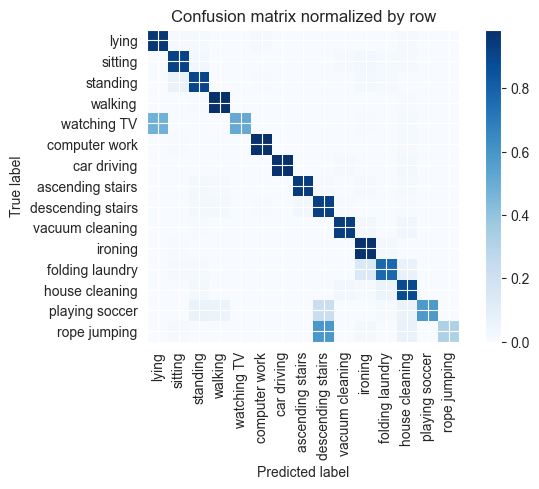

Training Epoch:  67%|██████▋   | 10/15 [10:35<05:19, 63.89s/it]

Overall accuracy: 0.901

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.988      0.980      0.984      0.135        598|	 house cleaning: 0.008,	sitting: 0.005,	
          ironing       0.879      0.975      0.924      0.109        483|	 folding laundry: 0.017,	sitting: 0.006,	
          walking       0.979      0.985      0.982      0.106        467|	 house cleaning: 0.004,	standing: 0.004,	
            lying       0.830      0.955      0.888      0.091        400|	 standing: 0.013,	house cleaning: 0.010,	
          sitting       0.899      0.914      0.907      0.082        362|	 ironing: 0.030,	standing: 0.025,	
         standing       0.884      0.901      0.892      0.080        354|	 sitting: 0.062,	ironing: 0.020,	
   house cleaning       0.838      0.884      0.861      0.078        346|	 folding laundry: 0.058,	vacuum cleaning: 0.023,	
  vacuum cleaning       0.953      0.933      0.943      0.078        3


train: 100%|██████████| 276/276 [00:54<00:00,  5.03batch/s, loss=4.22, accuracy=0.922]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:07<00:00,  8.85batch/s, loss=3.74]


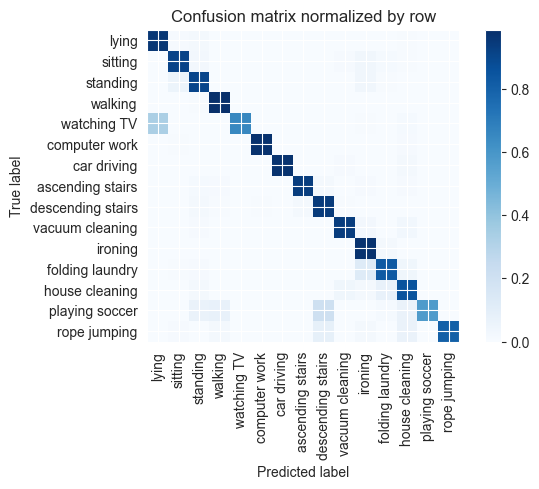

Training Epoch:  73%|███████▎  | 11/15 [11:39<04:15, 63.89s/it]

Overall accuracy: 0.919

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.978      0.987      0.136        601|	 house cleaning: 0.010,	sitting: 0.007,	
          ironing       0.874      0.975      0.922      0.110        484|	 folding laundry: 0.019,	house cleaning: 0.002,	
          walking       0.975      0.987      0.981      0.106        470|	 standing: 0.004,	house cleaning: 0.002,	
            lying       0.876      0.960      0.916      0.090        397|	 standing: 0.020,	sitting: 0.010,	
          sitting       0.914      0.914      0.914      0.082        360|	 ironing: 0.033,	standing: 0.025,	
         standing       0.882      0.904      0.893      0.080        354|	 sitting: 0.054,	ironing: 0.031,	
   house cleaning       0.860      0.855      0.857      0.078        344|	 folding laundry: 0.073,	vacuum cleaning: 0.035,	
  vacuum cleaning       0.944      0.936      0.940      0.078        3


train: 100%|██████████| 276/276 [00:54<00:00,  5.08batch/s, loss=3.86, accuracy=0.828]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:07<00:00,  9.07batch/s, loss=3.7] 


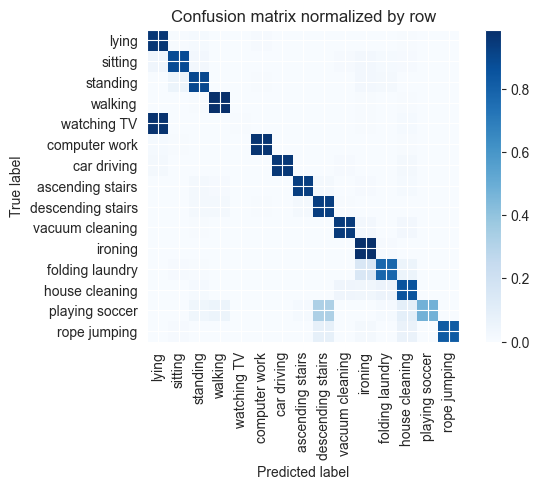

Training Epoch:  80%|████████  | 12/15 [12:42<03:11, 63.68s/it]

Overall accuracy: 0.887

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.988      0.965      0.976      0.136        601|	 lying: 0.015,	house cleaning: 0.007,	
          ironing       0.863      0.983      0.919      0.109        482|	 folding laundry: 0.008,	house cleaning: 0.002,	
          walking       0.979      0.987      0.983      0.106        470|	 house cleaning: 0.004,	ironing: 0.004,	
            lying       0.677      0.960      0.794      0.091        401|	 standing: 0.012,	computer work: 0.010,	
          sitting       0.911      0.881      0.895      0.082        360|	 lying: 0.039,	ironing: 0.025,	
         standing       0.895      0.892      0.894      0.080        353|	 sitting: 0.054,	ironing: 0.025,	
   house cleaning       0.849      0.853      0.851      0.079        348|	 folding laundry: 0.057,	vacuum cleaning: 0.040,	
  vacuum cleaning       0.939      0.942      0.940      0.078        3


train: 100%|██████████| 276/276 [00:55<00:00,  4.97batch/s, loss=3.22, accuracy=0.969]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:09<00:00,  7.49batch/s, loss=2.55]


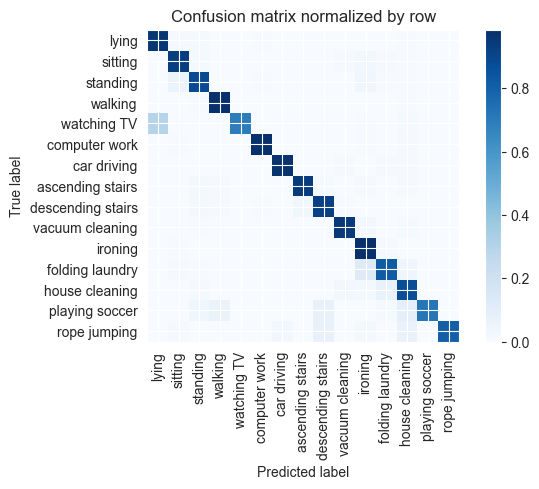

Training Epoch:  87%|████████▋ | 13/15 [13:48<02:08, 64.36s/it]

Overall accuracy: 0.925

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.990      0.978      0.984      0.135        597|	 house cleaning: 0.010,	ironing: 0.005,	
          ironing       0.868      0.983      0.922      0.109        483|	 folding laundry: 0.008,	sitting: 0.004,	
          walking       0.979      0.985      0.982      0.107        471|	 house cleaning: 0.004,	standing: 0.004,	
            lying       0.889      0.960      0.923      0.091        400|	 standing: 0.013,	sitting: 0.010,	
          sitting       0.906      0.931      0.918      0.082        362|	 ironing: 0.030,	standing: 0.014,	
         standing       0.908      0.887      0.897      0.080        354|	 sitting: 0.059,	ironing: 0.037,	
   house cleaning       0.866      0.871      0.868      0.079        348|	 folding laundry: 0.066,	vacuum cleaning: 0.026,	
  vacuum cleaning       0.950      0.950      0.950      0.078        343|	 ir


train: 100%|██████████| 276/276 [00:56<00:00,  4.93batch/s, loss=4.21, accuracy=0.922]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:07<00:00,  9.05batch/s, loss=2.79]


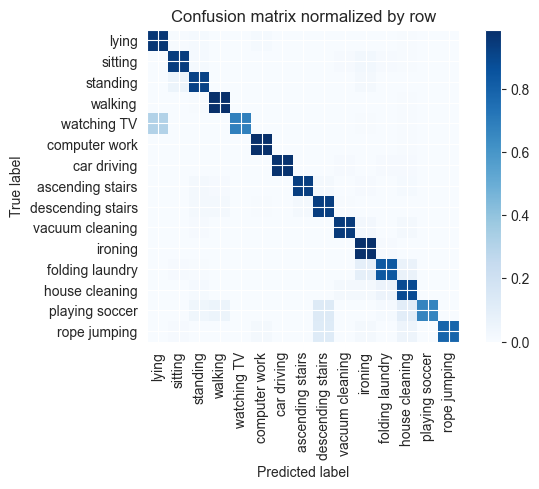

Training Epoch:  93%|█████████▎| 14/15 [14:53<01:04, 64.57s/it]

Overall accuracy: 0.929

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.985      0.985      0.985      0.136        600|	 house cleaning: 0.007,	sitting: 0.003,	
          ironing       0.896      0.985      0.939      0.109        481|	 folding laundry: 0.008,	house cleaning: 0.002,	
          walking       0.979      0.987      0.983      0.106        470|	 standing: 0.006,	house cleaning: 0.004,	
            lying       0.885      0.960      0.921      0.091        400|	 computer work: 0.013,	standing: 0.013,	
          sitting       0.923      0.934      0.929      0.082        362|	 ironing: 0.028,	standing: 0.014,	
         standing       0.905      0.918      0.911      0.080        352|	 sitting: 0.054,	ironing: 0.020,	
   house cleaning       0.863      0.885      0.874      0.079        348|	 folding laundry: 0.057,	vacuum cleaning: 0.023,	
  vacuum cleaning       0.956      0.942      0.949      0.078   


train: 100%|██████████| 276/276 [00:54<00:00,  5.04batch/s, loss=4.1, accuracy=0.953]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:07<00:00,  8.73batch/s, loss=3.01]


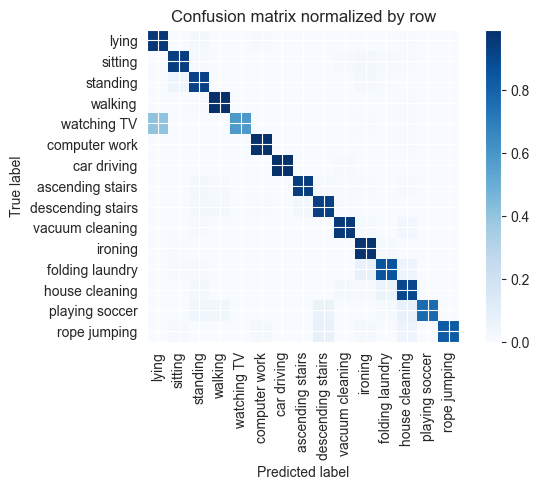

Overall accuracy: 0.932

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.987      0.985      0.986      0.136        599|	 house cleaning: 0.007,	folding laundry: 0.003,	
          ironing       0.913      0.979      0.945      0.109        483|	 folding laundry: 0.014,	sitting: 0.004,	
          walking       0.981      0.987      0.984      0.107        471|	 standing: 0.006,	house cleaning: 0.004,	
            lying       0.855      0.960      0.905      0.091        400|	 standing: 0.018,	computer work: 0.010,	
          sitting       0.934      0.939      0.936      0.082        360|	 ironing: 0.025,	folding laundry: 0.011,	
         standing       0.899      0.924      0.911      0.080        355|	 sitting: 0.042,	ironing: 0.023,	
   house cleaning       0.882      0.899      0.890      0.079        348|	 folding laundry: 0.052,	vacuum cleaning: 0.017,	
  vacuum cleaning       0.959      0.951      0.955      

unseen: 100%|██████████| 68/68 [00:07<00:00,  9.26batch/s, loss=6.59]


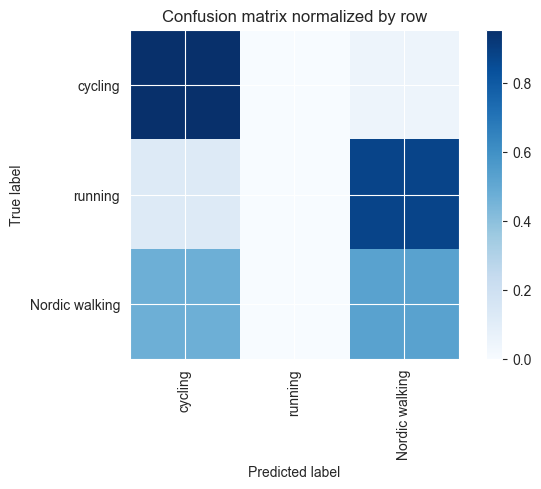

Overall accuracy: 0.570

                 precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

Nordic walking       0.518      0.529      0.523      0.419       1822|	 cycling: 0.471,	running: 0.000,	
       cycling       0.609      0.954      0.743      0.366       1592|	 Nordic walking: 0.046,	running: 0.000,	
       running       0.000      0.000      0.000      0.216        938|	 Nordic walking: 0.877,	cycling: 0.123,	

----------------------------------------------------------------------------------------------------
   avg / total       0.440      0.570      0.491        1.0       4352|	      

{'accuracy': 0.5700827205882353, 'precision': 0.3756304043908248, 'recall': 0.49401921793379633, 'f1': 0.42215803807175867}
================ Fold-4 ================
Unseen Classes : ['ironing', 'car driving', 'folding laundry']
per class count :  {'lying': 8, 'sitting': 8, 'standing': 8, 'walking': 8, 'running': 6, 'cycling': 7, 'Nordic walking': 7, 'watching TV': 1, '

Training Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

torch.Size([15, 512])



train: 100%|██████████| 283/283 [00:56<00:00,  5.05batch/s, loss=6.16, accuracy=0.828]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:07<00:00,  9.11batch/s, loss=6.95]


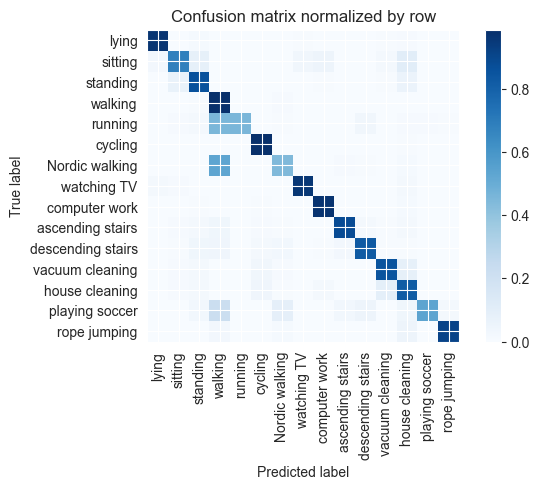

Training Epoch:   7%|▋         | 1/15 [01:04<15:07, 64.85s/it]

Overall accuracy: 0.831

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.956      0.970      0.963      0.135        606|	 house cleaning: 0.013,	cycling: 0.007,	
          walking       0.582      0.985      0.731      0.103        460|	 Nordic walking: 0.009,	standing: 0.004,	
   Nordic walking       0.856      0.440      0.581      0.084        377|	 walking: 0.531,	house cleaning: 0.013,	
   house cleaning       0.713      0.818      0.762      0.083        373|	 vacuum cleaning: 0.091,	cycling: 0.040,	
          sitting       0.857      0.682      0.759      0.079        352|	 house cleaning: 0.105,	standing: 0.082,	
  vacuum cleaning       0.859      0.849      0.854      0.078        351|	 house cleaning: 0.083,	cycling: 0.031,	
            lying       0.962      0.965      0.964      0.077        345|	 standing: 0.012,	house cleaning: 0.009,	
         standing       0.810      0.862      0.835      0.076    


train: 100%|██████████| 283/283 [00:55<00:00,  5.06batch/s, loss=6.21, accuracy=0.812]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:07<00:00,  9.03batch/s, loss=5.34]


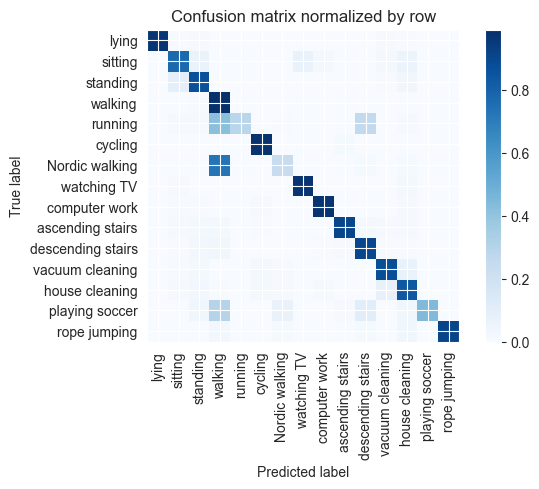

Training Epoch:  13%|█▎        | 2/15 [02:09<14:02, 64.84s/it]

Overall accuracy: 0.822

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.977      0.969      0.973      0.135        606|	 house cleaning: 0.010,	cycling: 0.010,	
          walking       0.536      0.991      0.696      0.104        466|	 standing: 0.004,	Nordic walking: 0.002,	
   Nordic walking       0.832      0.237      0.369      0.084        375|	 walking: 0.731,	house cleaning: 0.013,	
   house cleaning       0.790      0.837      0.813      0.082        369|	 vacuum cleaning: 0.076,	standing: 0.024,	
  vacuum cleaning       0.878      0.878      0.878      0.079        352|	 house cleaning: 0.068,	standing: 0.020,	
          sitting       0.839      0.772      0.804      0.078        351|	 watching TV: 0.068,	standing: 0.066,	
         standing       0.822      0.870      0.845      0.077        345|	 sitting: 0.090,	house cleaning: 0.032,	
            lying       1.000      0.968      0.984      0.076      


train: 100%|██████████| 283/283 [00:56<00:00,  5.00batch/s, loss=6.35, accuracy=0.875]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:07<00:00,  9.17batch/s, loss=6.51]


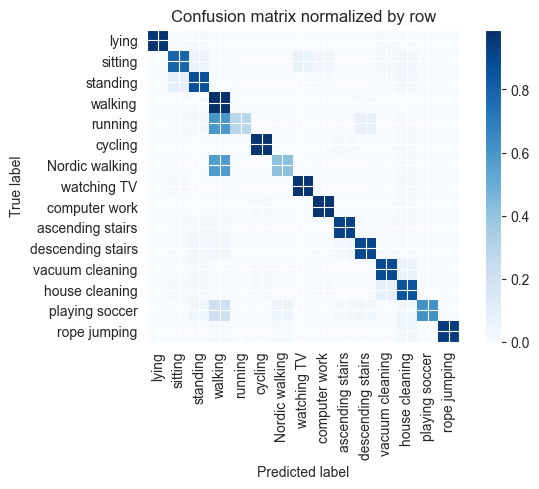

Training Epoch:  20%|██        | 3/15 [03:15<13:01, 65.09s/it]

Overall accuracy: 0.844

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.965      0.967      0.966      0.134        602|	 house cleaning: 0.015,	cycling: 0.008,	
          walking       0.562      0.989      0.717      0.104        465|	 descending stairs: 0.004,	standing: 0.004,	
   Nordic walking       0.934      0.412      0.572      0.084        376|	 walking: 0.569,	house cleaning: 0.013,	
   house cleaning       0.801      0.852      0.826      0.083        372|	 vacuum cleaning: 0.083,	standing: 0.022,	
  vacuum cleaning       0.874      0.886      0.880      0.078        351|	 house cleaning: 0.066,	standing: 0.020,	
          sitting       0.850      0.789      0.818      0.078        351|	 watching TV: 0.068,	standing: 0.057,	
         standing       0.833      0.867      0.849      0.077        345|	 sitting: 0.087,	house cleaning: 0.029,	
            lying       0.994      0.968      0.981      0.077   


train: 100%|██████████| 283/283 [00:56<00:00,  4.98batch/s, loss=5.8, accuracy=0.844]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:07<00:00,  8.94batch/s, loss=5.59]


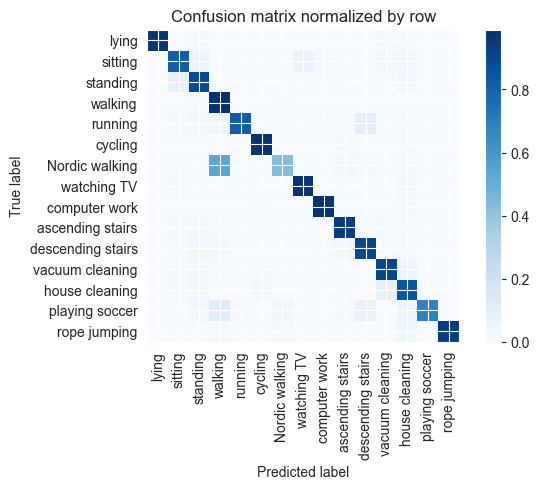

Training Epoch:  27%|██▋       | 4/15 [04:20<11:59, 65.37s/it]

Overall accuracy: 0.876

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.982      0.977      0.979      0.136        608|	 house cleaning: 0.012,	cycling: 0.005,	
          walking       0.664      0.989      0.794      0.103        463|	 Nordic walking: 0.004,	standing: 0.004,	
   Nordic walking       0.942      0.426      0.587      0.084        378|	 walking: 0.534,	ascending stairs: 0.016,	
   house cleaning       0.835      0.851      0.843      0.082        369|	 vacuum cleaning: 0.084,	standing: 0.022,	
          sitting       0.854      0.815      0.834      0.078        351|	 watching TV: 0.066,	standing: 0.057,	
  vacuum cleaning       0.871      0.906      0.888      0.078        350|	 house cleaning: 0.049,	standing: 0.020,	
         standing       0.838      0.887      0.862      0.077        344|	 sitting: 0.081,	house cleaning: 0.020,	
            lying       1.000      0.968      0.984      0.077    


train: 100%|██████████| 283/283 [00:56<00:00,  4.97batch/s, loss=6.59, accuracy=0.734]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:07<00:00,  9.19batch/s, loss=4.89]


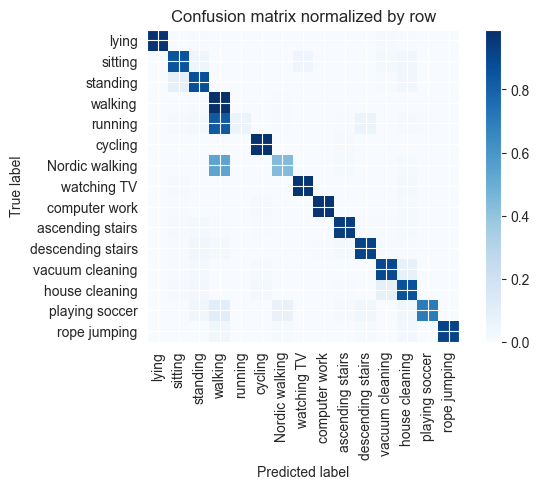

Training Epoch:  33%|███▎      | 5/15 [05:26<10:55, 65.52s/it]

Overall accuracy: 0.848

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.993      0.972      0.982      0.135        606|	 house cleaning: 0.012,	cycling: 0.008,	
          walking       0.552      0.989      0.708      0.104        465|	 Nordic walking: 0.004,	standing: 0.004,	
   Nordic walking       0.931      0.435      0.593      0.084        375|	 walking: 0.536,	house cleaning: 0.013,	
   house cleaning       0.804      0.864      0.833      0.082        369|	 vacuum cleaning: 0.081,	standing: 0.024,	
  vacuum cleaning       0.875      0.895      0.885      0.079        353|	 house cleaning: 0.071,	standing: 0.017,	
          sitting       0.862      0.852      0.857      0.079        352|	 watching TV: 0.045,	standing: 0.045,	
            lying       1.000      0.968      0.984      0.077        345|	 vacuum cleaning: 0.009,	house cleaning: 0.006,	
         standing       0.845      0.872      0.858      0.0


train: 100%|██████████| 283/283 [00:57<00:00,  4.94batch/s, loss=5.49, accuracy=0.812]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:08<00:00,  8.51batch/s, loss=3.62]


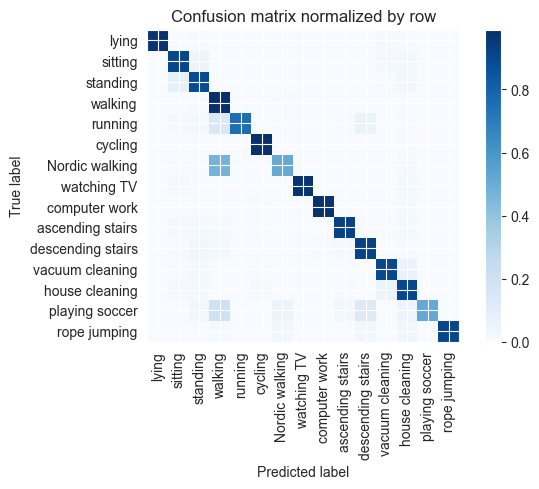

Training Epoch:  40%|████      | 6/15 [06:33<09:53, 65.91s/it]

Overall accuracy: 0.886

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.975      0.985      0.134        602|	 house cleaning: 0.013,	cycling: 0.005,	
          walking       0.662      0.989      0.793      0.104        466|	 Nordic walking: 0.004,	standing: 0.004,	
   Nordic walking       0.941      0.508      0.660      0.084        378|	 walking: 0.471,	house cleaning: 0.011,	
   house cleaning       0.818      0.898      0.856      0.083        371|	 vacuum cleaning: 0.059,	standing: 0.022,	
  vacuum cleaning       0.900      0.900      0.900      0.078        350|	 house cleaning: 0.063,	standing: 0.020,	
          sitting       0.873      0.903      0.887      0.078        349|	 standing: 0.049,	house cleaning: 0.026,	
         standing       0.845      0.884      0.864      0.077        346|	 sitting: 0.078,	house cleaning: 0.029,	
            lying       1.000      0.968      0.984      0.076   


train: 100%|██████████| 283/283 [00:57<00:00,  4.96batch/s, loss=4.87, accuracy=0.938]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:07<00:00,  9.09batch/s, loss=4.05]


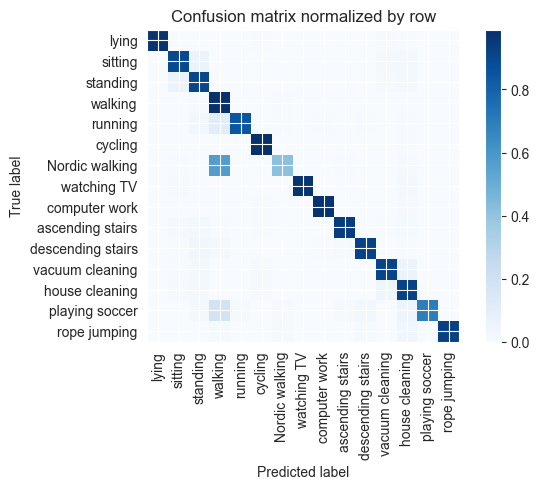

Training Epoch:  47%|████▋     | 7/15 [07:39<08:47, 65.88s/it]

Overall accuracy: 0.892

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.992      0.977      0.984      0.136        608|	 house cleaning: 0.012,	cycling: 0.005,	
          walking       0.641      0.989      0.778      0.104        464|	 standing: 0.006,	Nordic walking: 0.004,	
   Nordic walking       0.957      0.413      0.577      0.084        375|	 walking: 0.565,	house cleaning: 0.011,	
   house cleaning       0.842      0.919      0.879      0.083        371|	 vacuum cleaning: 0.040,	standing: 0.019,	
          sitting       0.893      0.895      0.894      0.079        353|	 standing: 0.057,	vacuum cleaning: 0.023,	
  vacuum cleaning       0.911      0.909      0.910      0.078        350|	 house cleaning: 0.057,	standing: 0.017,	
            lying       1.000      0.968      0.984      0.077        346|	 vacuum cleaning: 0.012,	house cleaning: 0.006,	
         standing       0.843      0.907      0.874     


train: 100%|██████████| 283/283 [00:58<00:00,  4.86batch/s, loss=5.88, accuracy=0.844]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:07<00:00,  8.91batch/s, loss=5.02]


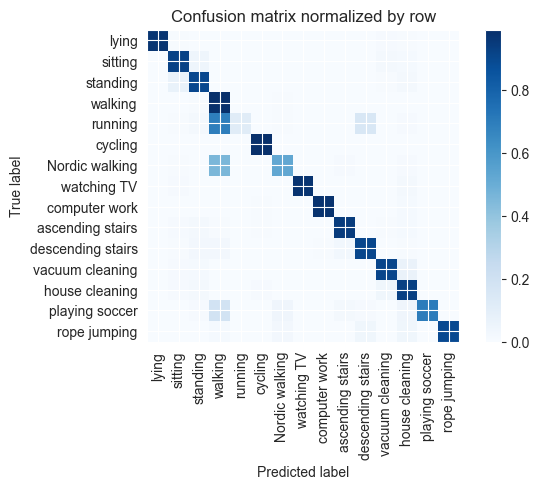

Training Epoch:  53%|█████▎    | 8/15 [08:46<07:44, 66.31s/it]

Overall accuracy: 0.871

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.977      0.986      0.135        603|	 house cleaning: 0.012,	cycling: 0.005,	
          walking       0.584      0.987      0.734      0.104        464|	 Nordic walking: 0.004,	standing: 0.004,	
   Nordic walking       0.947      0.523      0.674      0.084        377|	 walking: 0.454,	house cleaning: 0.011,	
   house cleaning       0.841      0.925      0.881      0.083        372|	 vacuum cleaning: 0.035,	standing: 0.019,	
          sitting       0.878      0.918      0.897      0.079        352|	 standing: 0.045,	vacuum cleaning: 0.020,	
  vacuum cleaning       0.924      0.905      0.915      0.078        349|	 house cleaning: 0.063,	standing: 0.014,	
         standing       0.866      0.899      0.882      0.077        346|	 sitting: 0.069,	house cleaning: 0.023,	
            lying       1.000      0.968      0.984      0.077  


train: 100%|██████████| 283/283 [00:57<00:00,  4.89batch/s, loss=5.04, accuracy=0.812]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:07<00:00,  8.84batch/s, loss=5.1] 


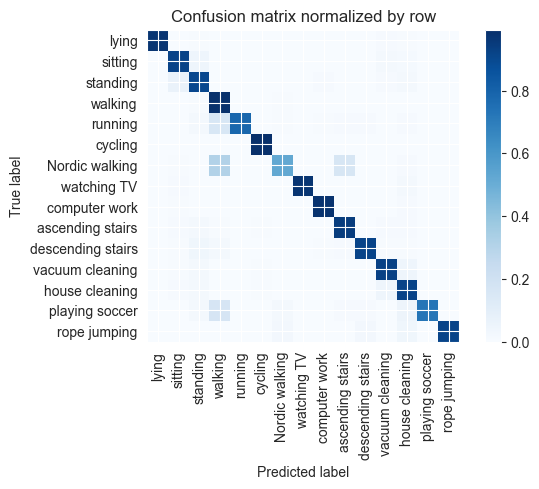

Training Epoch:  60%|██████    | 9/15 [09:53<06:38, 66.49s/it]

Overall accuracy: 0.902

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.988      0.980      0.984      0.134        600|	 house cleaning: 0.008,	sitting: 0.005,	
          walking       0.734      0.989      0.842      0.104        465|	 standing: 0.006,	Nordic walking: 0.004,	
   Nordic walking       0.966      0.524      0.679      0.084        378|	 walking: 0.307,	ascending stairs: 0.156,	
   house cleaning       0.864      0.916      0.889      0.082        369|	 vacuum cleaning: 0.046,	standing: 0.019,	
          sitting       0.890      0.918      0.904      0.079        354|	 standing: 0.045,	vacuum cleaning: 0.020,	
  vacuum cleaning       0.908      0.926      0.917      0.078        350|	 house cleaning: 0.043,	standing: 0.020,	
            lying       1.000      0.974      0.987      0.077        346|	 vacuum cleaning: 0.009,	house cleaning: 0.006,	
         standing       0.850      0.901      0.875   


train: 100%|██████████| 283/283 [00:58<00:00,  4.87batch/s, loss=4.7, accuracy=0.906]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:07<00:00,  9.12batch/s, loss=3.63]


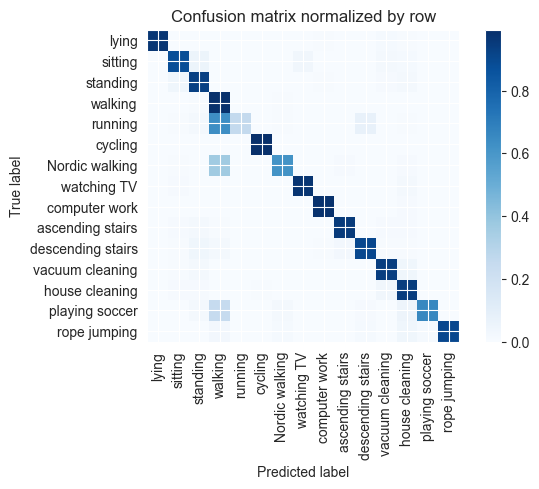

Training Epoch:  67%|██████▋   | 10/15 [11:00<05:33, 66.70s/it]

Overall accuracy: 0.888

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.992      0.983      0.988      0.135        606|	 house cleaning: 0.008,	cycling: 0.003,	
          walking       0.617      0.987      0.759      0.103        463|	 Nordic walking: 0.004,	standing: 0.004,	
   house cleaning       0.873      0.941      0.906      0.083        374|	 vacuum cleaning: 0.032,	standing: 0.011,	
   Nordic walking       0.970      0.614      0.752      0.083        373|	 walking: 0.362,	house cleaning: 0.008,	
          sitting       0.912      0.878      0.894      0.079        352|	 standing: 0.054,	watching TV: 0.034,	
  vacuum cleaning       0.916      0.937      0.926      0.078        349|	 house cleaning: 0.037,	standing: 0.017,	
         standing       0.864      0.928      0.895      0.078        348|	 sitting: 0.037,	house cleaning: 0.020,	
            lying       1.000      0.968      0.984      0.076      


train: 100%|██████████| 283/283 [00:58<00:00,  4.88batch/s, loss=4.15, accuracy=0.906]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:07<00:00,  8.97batch/s, loss=3.47]


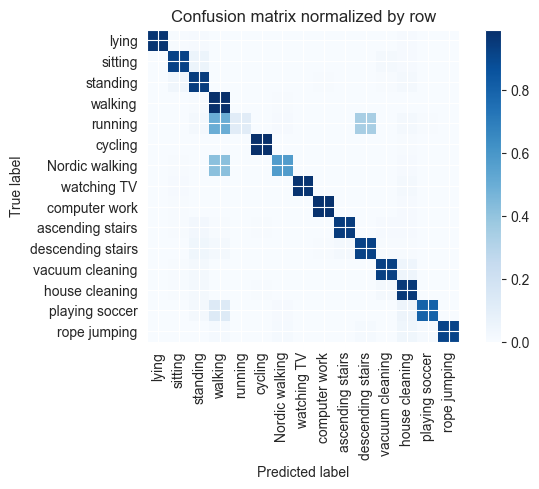

Training Epoch:  73%|███████▎  | 11/15 [12:07<04:27, 66.79s/it]

Overall accuracy: 0.886

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.993      0.980      0.987      0.135        603|	 house cleaning: 0.008,	sitting: 0.005,	
          walking       0.635      0.987      0.773      0.104        467|	 standing: 0.006,	Nordic walking: 0.004,	
   Nordic walking       0.973      0.569      0.718      0.084        378|	 walking: 0.415,	house cleaning: 0.008,	
   house cleaning       0.866      0.952      0.907      0.083        373|	 vacuum cleaning: 0.021,	standing: 0.016,	
          sitting       0.926      0.920      0.923      0.078        351|	 standing: 0.051,	vacuum cleaning: 0.020,	
  vacuum cleaning       0.939      0.926      0.932      0.078        349|	 house cleaning: 0.046,	standing: 0.020,	
         standing       0.849      0.939      0.892      0.077        347|	 sitting: 0.032,	house cleaning: 0.017,	
            lying       1.000      0.968      0.984      0.077  


train: 100%|██████████| 283/283 [00:57<00:00,  4.90batch/s, loss=3.68, accuracy=0.906]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:07<00:00,  8.90batch/s, loss=2.59]


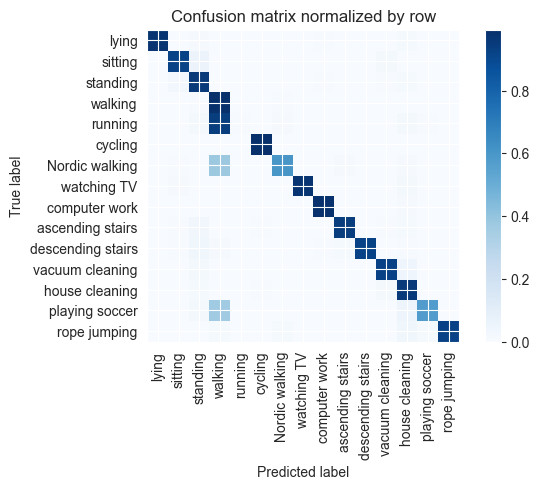

Training Epoch:  80%|████████  | 12/15 [13:14<03:20, 66.79s/it]

Overall accuracy: 0.882

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.992      0.985      0.988      0.135        605|	 house cleaning: 0.008,	playing soccer: 0.002,	
          walking       0.567      0.987      0.721      0.105        469|	 standing: 0.006,	Nordic walking: 0.004,	
   Nordic walking       0.978      0.601      0.744      0.083        373|	 walking: 0.375,	house cleaning: 0.011,	
   house cleaning       0.870      0.957      0.911      0.083        371|	 vacuum cleaning: 0.022,	standing: 0.013,	
          sitting       0.947      0.920      0.934      0.079        352|	 standing: 0.057,	vacuum cleaning: 0.020,	
  vacuum cleaning       0.947      0.926      0.936      0.078        350|	 house cleaning: 0.046,	standing: 0.023,	
            lying       1.000      0.974      0.987      0.077        343|	 house cleaning: 0.012,	standing: 0.009,	
         standing       0.845      0.953      0.896     


train: 100%|██████████| 283/283 [00:57<00:00,  4.88batch/s, loss=4.06, accuracy=0.891]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:07<00:00,  9.01batch/s, loss=4.69]


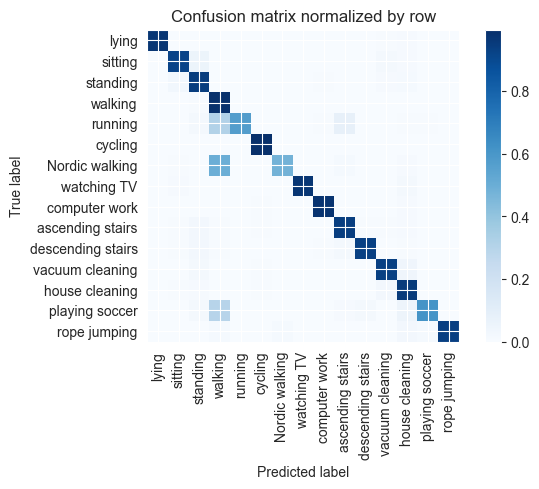

Training Epoch:  87%|████████▋ | 13/15 [14:21<02:13, 66.84s/it]

Overall accuracy: 0.896

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.992      0.980      0.986      0.135        607|	 house cleaning: 0.010,	cycling: 0.005,	
          walking       0.623      0.991      0.765      0.104        465|	 standing: 0.006,	ascending stairs: 0.002,	
   Nordic walking       0.994      0.477      0.645      0.084        375|	 walking: 0.496,	ascending stairs: 0.013,	
   house cleaning       0.880      0.954      0.915      0.082        368|	 vacuum cleaning: 0.027,	standing: 0.008,	
          sitting       0.939      0.921      0.930      0.079        353|	 standing: 0.051,	vacuum cleaning: 0.017,	
  vacuum cleaning       0.937      0.932      0.934      0.079        352|	 house cleaning: 0.040,	standing: 0.020,	
         standing       0.867      0.942      0.903      0.077        346|	 sitting: 0.029,	house cleaning: 0.014,	
            lying       1.000      0.971      0.985      0.0


train: 100%|██████████| 283/283 [00:59<00:00,  4.76batch/s, loss=3.7, accuracy=0.938]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:09<00:00,  7.48batch/s, loss=2.39]


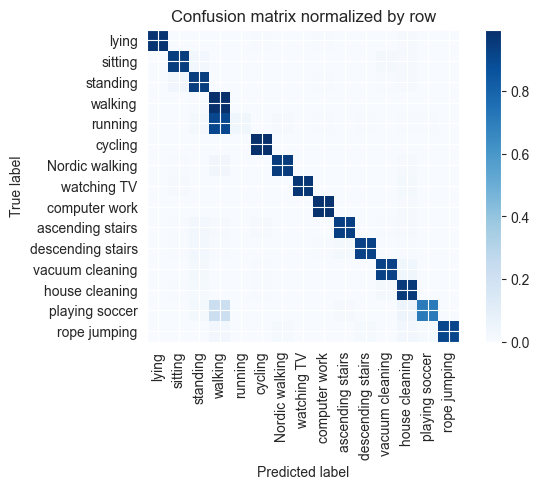

Training Epoch:  93%|█████████▎| 14/15 [15:31<01:07, 67.81s/it]

Overall accuracy: 0.917

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.990      0.983      0.987      0.135        606|	 house cleaning: 0.008,	cycling: 0.003,	
          walking       0.689      0.991      0.813      0.104        466|	 standing: 0.006,	ascending stairs: 0.002,	
   Nordic walking       0.992      0.947      0.969      0.084        376|	 walking: 0.035,	house cleaning: 0.008,	
   house cleaning       0.885      0.957      0.919      0.083        370|	 vacuum cleaning: 0.019,	standing: 0.014,	
  vacuum cleaning       0.950      0.929      0.939      0.078        351|	 house cleaning: 0.037,	standing: 0.023,	
          sitting       0.938      0.943      0.940      0.078        350|	 standing: 0.029,	vacuum cleaning: 0.017,	
         standing       0.877      0.945      0.910      0.077        347|	 sitting: 0.032,	house cleaning: 0.012,	
            lying       1.000      0.974      0.987      0.077


train: 100%|██████████| 283/283 [01:01<00:00,  4.60batch/s, loss=4.93, accuracy=0.859]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:08<00:00,  8.67batch/s, loss=2.8]


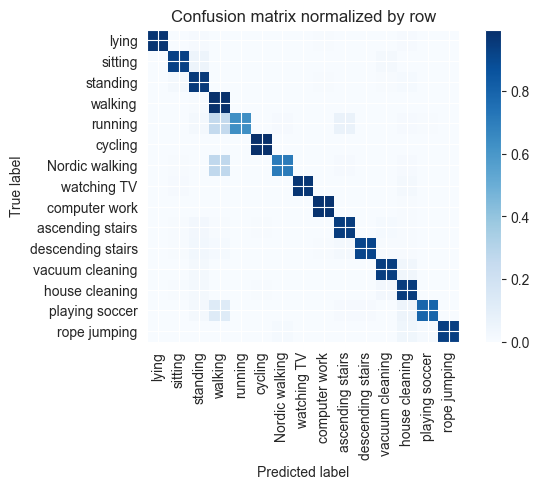

Overall accuracy: 0.923

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.992      0.983      0.987      0.133        596|	 house cleaning: 0.007,	cycling: 0.003,	
          walking       0.735      0.991      0.844      0.104        464|	 standing: 0.006,	ascending stairs: 0.002,	
   Nordic walking       0.989      0.706      0.824      0.084        377|	 walking: 0.268,	ascending stairs: 0.011,	
   house cleaning       0.893      0.946      0.919      0.083        371|	 vacuum cleaning: 0.027,	standing: 0.016,	
          sitting       0.945      0.929      0.937      0.078        351|	 standing: 0.048,	vacuum cleaning: 0.017,	
  vacuum cleaning       0.934      0.940      0.937      0.078        349|	 house cleaning: 0.032,	standing: 0.023,	
         standing       0.855      0.957      0.903      0.077        346|	 sitting: 0.017,	house cleaning: 0.014,	
            lying       1.000      0.974      0.987      0.0

unseen: 100%|██████████| 60/60 [00:06<00:00,  9.44batch/s, loss=2.51]


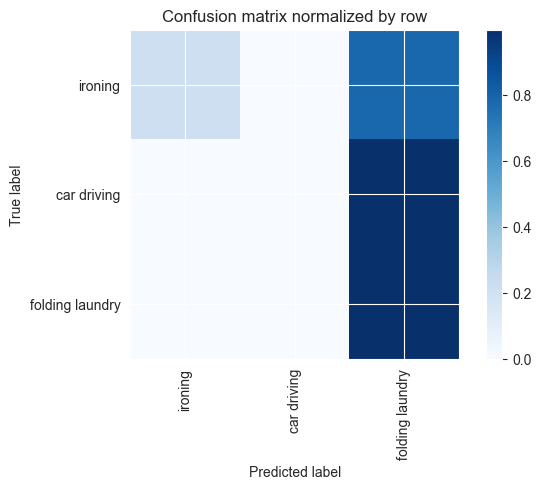

Overall accuracy: 0.382

                  precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

        ironing       0.990      0.214      0.352      0.607       2331|	 folding laundry: 0.786,	car driving: 0.000,	
folding laundry       0.290      0.997      0.450      0.253        972|	 ironing: 0.003,	car driving: 0.000,	
    car driving       0.000      0.000      0.000      0.140        537|	 folding laundry: 0.996,	ironing: 0.004,	

----------------------------------------------------------------------------------------------------
    avg / total       0.675      0.382      0.328        1.0       3840|	      

{'accuracy': 0.38229166666666664, 'precision': 0.4268489969928819, 'recall': 0.4036615981060425, 'f1': 0.2672963143096229}
============== Overall Unseen Classes Performance ==============


accuracy     0.398642
precision    0.374341
recall       0.367283
f1           0.309978
dtype: float64

================ Fold-0 ================
Unseen Classes : ['watching TV', 'house cleaning', 'standing', 'ascending stairs']
per class count :  {'lying': 8, 'sitting': 8, 'standing': 8, 'walking': 8, 'running': 6, 'cycling': 7, 'Nordic walking': 7, 'watching TV': 1, 'computer work': 4, 'car driving': 1, 'ascending stairs': 16, 'descending stairs': 17, 'vacuum cleaning': 8, 'ironing': 8, 'folding laundry': 4, 'house cleaning': 5, 'playing soccer': 2, 'rope jumping': 6}
<class 'list'> <class 'list'> <class 'numpy.ndarray'> <class 'numpy.ndarray'>
seen classes >  [0, 1, 3, 4, 5, 6, 8, 9, 11, 12, 13, 14, 16, 17]
unseen classes >  [7, 15, 2, 10]
Initiate IMU datasets ...


Training Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

torch.Size([14, 512])



train: 100%|██████████| 261/261 [00:28<00:00,  9.29batch/s, loss=9.77, accuracy=0.828]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.75batch/s, loss=5.25]


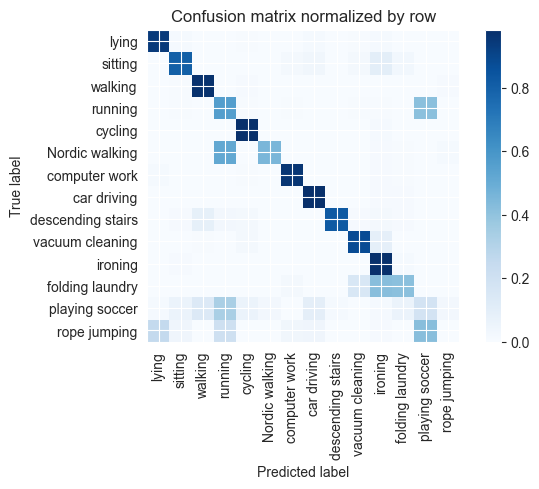

Training Epoch:   7%|▋         | 1/15 [00:32<07:30, 32.21s/it]

Overall accuracy: 0.815

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.973      0.958      0.965      0.142        591|	 lying: 0.015,	ironing: 0.008,	
          ironing       0.722      0.976      0.830      0.111        460|	 folding laundry: 0.013,	sitting: 0.009,	
          walking       0.936      0.971      0.953      0.108        450|	 rope jumping: 0.009,	cycling: 0.009,	
            lying       0.919      0.944      0.931      0.098        408|	 car driving: 0.015,	sitting: 0.015,	
          sitting       0.913      0.799      0.852      0.088        368|	 ironing: 0.098,	car driving: 0.033,	
  vacuum cleaning       0.875      0.878      0.877      0.085        352|	 ironing: 0.088,	cycling: 0.017,	
   Nordic walking       0.975      0.454      0.620      0.084        348|	 running: 0.514,	rope jumping: 0.014,	
          cycling       0.927      0.979      0.952      0.081        337|	 ironing: 0.015,	run


train: 100%|██████████| 261/261 [00:29<00:00,  8.85batch/s, loss=6.91, accuracy=0.828]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.86batch/s, loss=4.75]


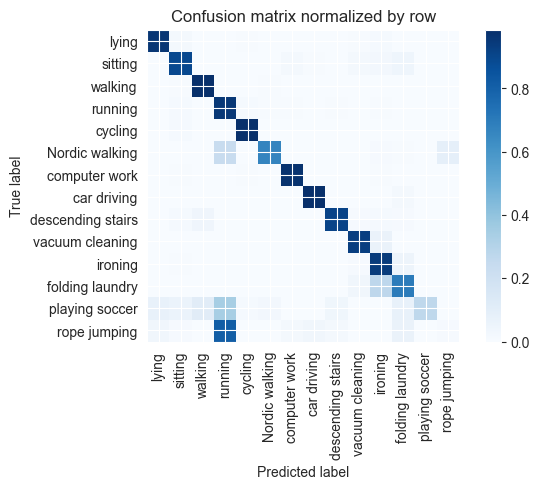

Training Epoch:  13%|█▎        | 2/15 [01:05<07:09, 33.06s/it]

Overall accuracy: 0.882

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.985      0.971      0.978      0.143        594|	 cycling: 0.007,	sitting: 0.007,	
          ironing       0.818      0.940      0.874      0.111        463|	 folding laundry: 0.048,	vacuum cleaning: 0.009,	
          walking       0.963      0.982      0.973      0.109        452|	 Nordic walking: 0.007,	sitting: 0.007,	
            lying       0.973      0.961      0.967      0.099        410|	 sitting: 0.017,	ironing: 0.012,	
          sitting       0.906      0.889      0.898      0.089        370|	 folding laundry: 0.046,	ironing: 0.024,	
  vacuum cleaning       0.934      0.931      0.933      0.084        349|	 ironing: 0.063,	Nordic walking: 0.003,	
   Nordic walking       0.970      0.664      0.788      0.082        342|	 running: 0.231,	rope jumping: 0.088,	
          cycling       0.974      0.985      0.979      0.081        338|	 


train: 100%|██████████| 261/261 [00:29<00:00,  8.79batch/s, loss=5.9, accuracy=0.812]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.73batch/s, loss=6.24]


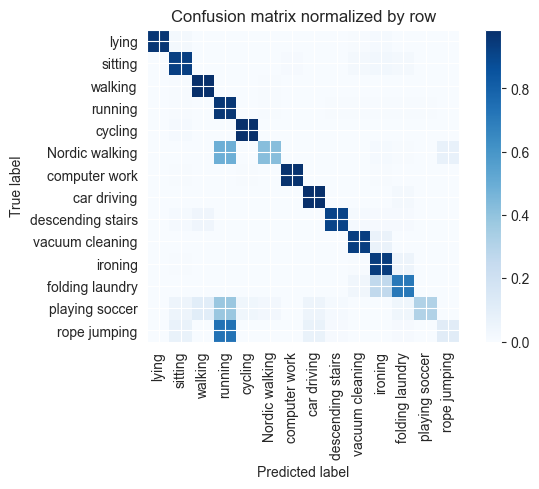

Training Epoch:  20%|██        | 3/15 [01:39<06:40, 33.41s/it]

Overall accuracy: 0.869

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.973      0.984      0.143        594|	 cycling: 0.007,	ironing: 0.005,	
          ironing       0.816      0.939      0.873      0.110        459|	 folding laundry: 0.048,	vacuum cleaning: 0.007,	
          walking       0.963      0.982      0.973      0.109        455|	 Nordic walking: 0.007,	sitting: 0.007,	
            lying       0.995      0.961      0.978      0.099        410|	 sitting: 0.020,	ironing: 0.012,	
          sitting       0.904      0.924      0.914      0.088        367|	 ironing: 0.027,	folding laundry: 0.022,	
  vacuum cleaning       0.931      0.931      0.931      0.084        348|	 ironing: 0.063,	Nordic walking: 0.003,	
   Nordic walking       0.954      0.422      0.585      0.083        346|	 running: 0.488,	rope jumping: 0.072,	
          cycling       0.977      0.985      0.981      0.081        339|	 


train: 100%|██████████| 261/261 [00:29<00:00,  8.78batch/s, loss=7.11, accuracy=0.938]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.40batch/s, loss=4.56]


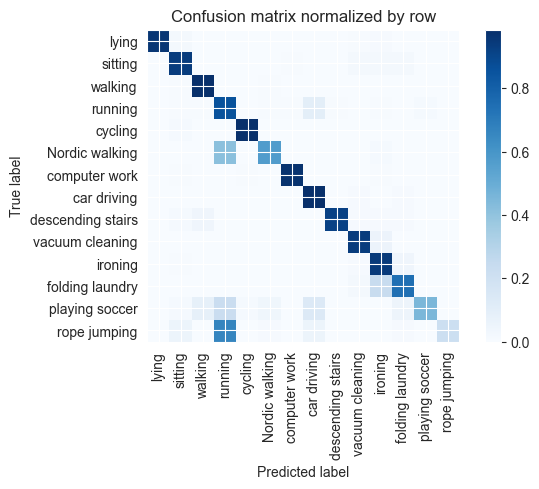

Training Epoch:  27%|██▋       | 4/15 [02:13<06:10, 33.66s/it]

Overall accuracy: 0.886

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.970      0.982      0.143        595|	 ironing: 0.007,	cycling: 0.007,	
          ironing       0.832      0.946      0.885      0.111        461|	 folding laundry: 0.039,	vacuum cleaning: 0.011,	
          walking       0.965      0.982      0.974      0.109        453|	 Nordic walking: 0.007,	sitting: 0.004,	
            lying       0.995      0.961      0.977      0.098        406|	 sitting: 0.017,	ironing: 0.010,	
          sitting       0.921      0.938      0.929      0.089        371|	 ironing: 0.022,	vacuum cleaning: 0.019,	
  vacuum cleaning       0.932      0.937      0.934      0.084        350|	 ironing: 0.057,	Nordic walking: 0.003,	
   Nordic walking       0.956      0.569      0.714      0.083        346|	 running: 0.413,	ironing: 0.012,	
          cycling       0.982      0.985      0.984      0.080        334|	 sitti


train: 100%|██████████| 261/261 [00:30<00:00,  8.55batch/s, loss=4.54, accuracy=0.891]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 16.75batch/s, loss=4.48]


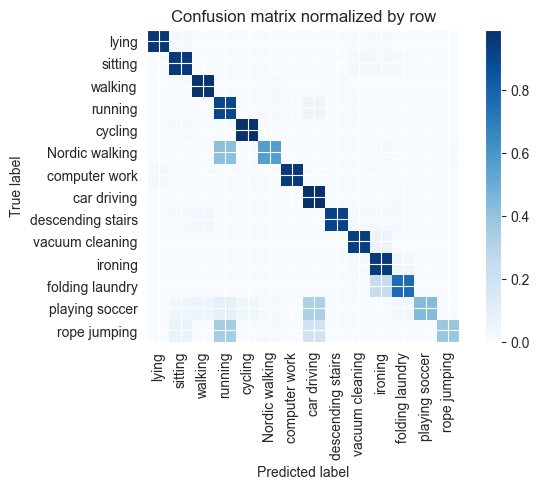

Training Epoch:  33%|███▎      | 5/15 [02:48<05:41, 34.12s/it]

Overall accuracy: 0.891

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.996      0.953      0.974      0.143        594|	 lying: 0.022,	cycling: 0.007,	
          ironing       0.835      0.952      0.890      0.111        461|	 folding laundry: 0.035,	vacuum cleaning: 0.009,	
          walking       0.978      0.978      0.978      0.109        454|	 Nordic walking: 0.009,	descending stairs: 0.004,	
            lying       0.968      0.961      0.965      0.099        410|	 sitting: 0.017,	ironing: 0.012,	
          sitting       0.919      0.951      0.935      0.088        368|	 ironing: 0.019,	vacuum cleaning: 0.019,	
  vacuum cleaning       0.940      0.940      0.940      0.084        349|	 ironing: 0.052,	folding laundry: 0.003,	
   Nordic walking       0.956      0.565      0.710      0.083        345|	 running: 0.412,	ironing: 0.014,	
          cycling       0.976      0.982      0.979      0.081        33


train: 100%|██████████| 261/261 [00:30<00:00,  8.58batch/s, loss=5.69, accuracy=0.859]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.66batch/s, loss=6.12]


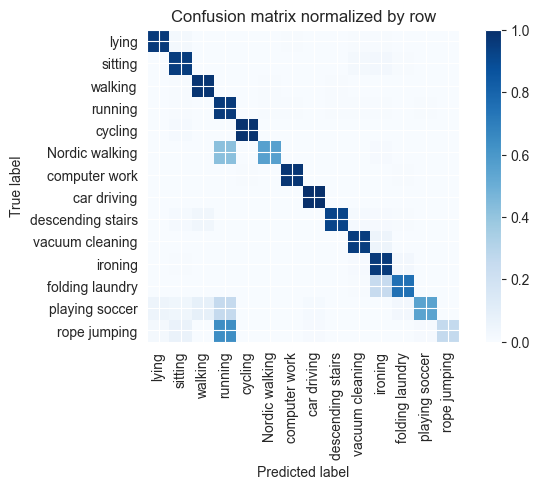

Training Epoch:  40%|████      | 6/15 [03:23<05:08, 34.26s/it]

Overall accuracy: 0.897

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.993      0.975      0.984      0.143        594|	 cycling: 0.007,	folding laundry: 0.005,	
          ironing       0.840      0.961      0.897      0.111        460|	 folding laundry: 0.026,	vacuum cleaning: 0.009,	
          walking       0.969      0.980      0.975      0.109        453|	 Nordic walking: 0.007,	descending stairs: 0.004,	
            lying       0.980      0.961      0.970      0.098        408|	 sitting: 0.020,	vacuum cleaning: 0.007,	
          sitting       0.919      0.949      0.934      0.089        371|	 ironing: 0.024,	vacuum cleaning: 0.019,	
  vacuum cleaning       0.938      0.946      0.942      0.084        351|	 ironing: 0.048,	Nordic walking: 0.003,	
   Nordic walking       0.975      0.562      0.713      0.083        345|	 running: 0.420,	ironing: 0.012,	
          cycling       0.982      0.985      0.984    


train: 100%|██████████| 261/261 [00:29<00:00,  8.72batch/s, loss=4.51, accuracy=0.984]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.14batch/s, loss=4.62]


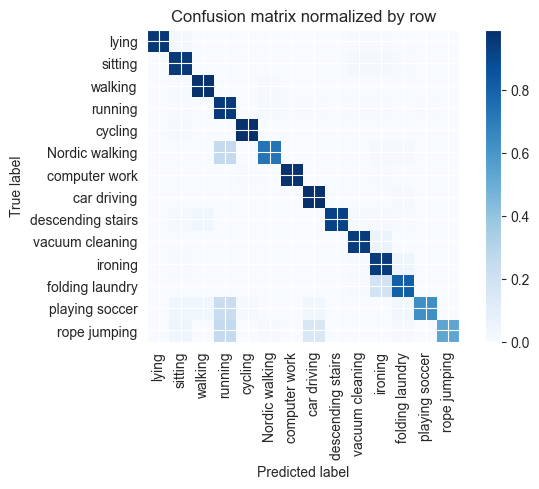

Training Epoch:  47%|████▋     | 7/15 [03:57<04:33, 34.23s/it]

Overall accuracy: 0.920

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.978      0.986      0.143        594|	 cycling: 0.007,	ironing: 0.005,	
          ironing       0.859      0.948      0.901      0.111        461|	 folding laundry: 0.041,	vacuum cleaning: 0.007,	
          walking       0.978      0.980      0.979      0.109        452|	 Nordic walking: 0.009,	sitting: 0.004,	
            lying       1.000      0.961      0.980      0.098        408|	 sitting: 0.022,	ironing: 0.005,	
          sitting       0.915      0.951      0.933      0.089        371|	 ironing: 0.022,	vacuum cleaning: 0.019,	
  vacuum cleaning       0.943      0.943      0.943      0.084        351|	 ironing: 0.051,	Nordic walking: 0.003,	
   Nordic walking       0.969      0.728      0.832      0.083        346|	 running: 0.251,	folding laundry: 0.009,	
          cycling       0.982      0.985      0.984      0.081        335


train: 100%|██████████| 261/261 [00:30<00:00,  8.68batch/s, loss=4.37, accuracy=0.938]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.18batch/s, loss=4]   


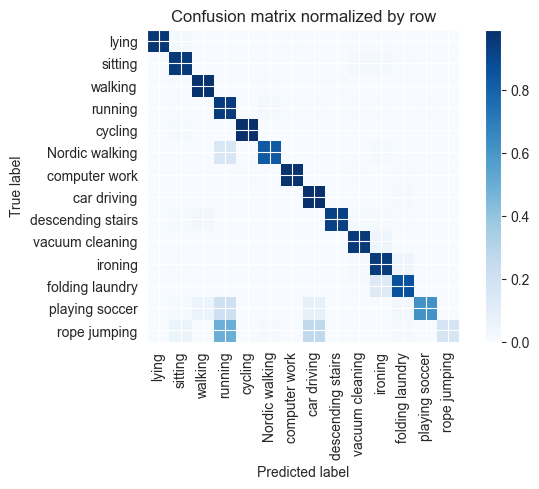

Training Epoch:  53%|█████▎    | 8/15 [04:31<03:59, 34.25s/it]

Overall accuracy: 0.923

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.993      0.976      0.985      0.142        592|	 folding laundry: 0.007,	cycling: 0.007,	
          ironing       0.884      0.948      0.915      0.111        460|	 folding laundry: 0.039,	vacuum cleaning: 0.009,	
          walking       0.976      0.980      0.978      0.109        454|	 Nordic walking: 0.007,	descending stairs: 0.004,	
            lying       1.000      0.961      0.980      0.099        410|	 sitting: 0.017,	vacuum cleaning: 0.007,	
          sitting       0.926      0.954      0.940      0.089        369|	 ironing: 0.019,	vacuum cleaning: 0.019,	
  vacuum cleaning       0.935      0.951      0.943      0.084        349|	 ironing: 0.040,	folding laundry: 0.003,	
   Nordic walking       0.976      0.830      0.897      0.083        347|	 running: 0.150,	ironing: 0.014,	
          cycling       0.982      0.985      0.984   


train: 100%|██████████| 261/261 [00:30<00:00,  8.65batch/s, loss=4.13, accuracy=0.891]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.27batch/s, loss=5.19]


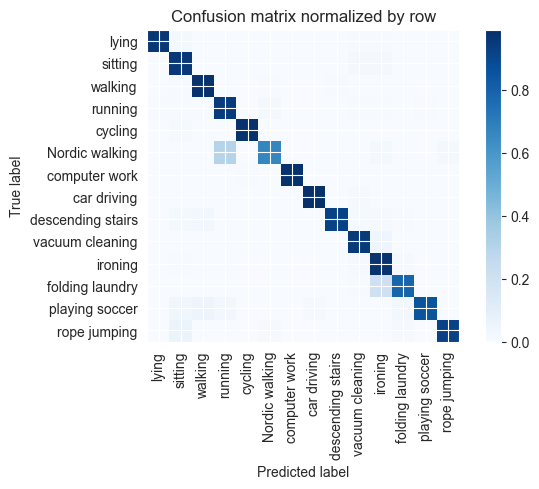

Training Epoch:  60%|██████    | 9/15 [05:06<03:25, 34.29s/it]

Overall accuracy: 0.932

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.997      0.983      0.990      0.142        590|	 cycling: 0.005,	vacuum cleaning: 0.003,	
          ironing       0.862      0.976      0.915      0.111        460|	 vacuum cleaning: 0.011,	folding laundry: 0.009,	
          walking       0.976      0.980      0.978      0.109        454|	 Nordic walking: 0.007,	descending stairs: 0.004,	
            lying       0.997      0.963      0.980      0.098        407|	 sitting: 0.022,	ironing: 0.005,	
          sitting       0.913      0.957      0.934      0.089        371|	 ironing: 0.019,	vacuum cleaning: 0.019,	
  vacuum cleaning       0.936      0.954      0.945      0.084        351|	 ironing: 0.040,	Nordic walking: 0.003,	
   Nordic walking       0.967      0.666      0.788      0.083        347|	 running: 0.297,	rope jumping: 0.017,	
          cycling       0.991      0.982      0.987      0


train: 100%|██████████| 261/261 [00:30<00:00,  8.60batch/s, loss=4.39, accuracy=0.922]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.34batch/s, loss=2.93]


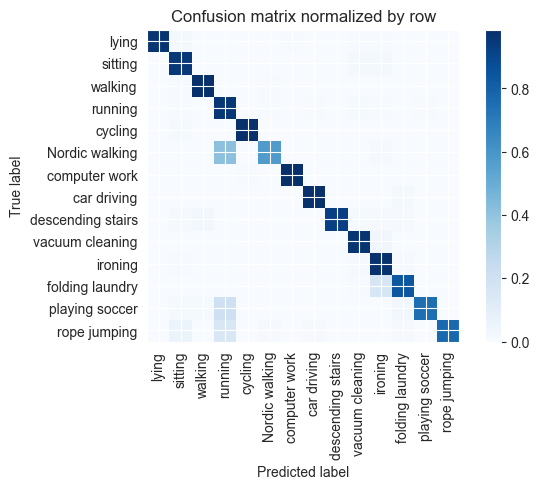

Training Epoch:  67%|██████▋   | 10/15 [05:40<02:51, 34.37s/it]

Overall accuracy: 0.922

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.980      0.987      0.142        591|	 cycling: 0.007,	folding laundry: 0.003,	
          ironing       0.884      0.976      0.928      0.111        460|	 vacuum cleaning: 0.011,	folding laundry: 0.009,	
          walking       0.984      0.984      0.984      0.108        451|	 Nordic walking: 0.004,	sitting: 0.004,	
            lying       1.000      0.963      0.981      0.099        410|	 sitting: 0.017,	vacuum cleaning: 0.007,	
          sitting       0.929      0.954      0.941      0.089        369|	 ironing: 0.022,	vacuum cleaning: 0.019,	
  vacuum cleaning       0.931      0.963      0.946      0.084        348|	 ironing: 0.032,	Nordic walking: 0.003,	
   Nordic walking       0.975      0.572      0.721      0.084        348|	 running: 0.411,	ironing: 0.009,	
          cycling       0.985      0.985      0.985      0.081   


train: 100%|██████████| 261/261 [00:30<00:00,  8.67batch/s, loss=4.24, accuracy=0.906]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.70batch/s, loss=3.16]


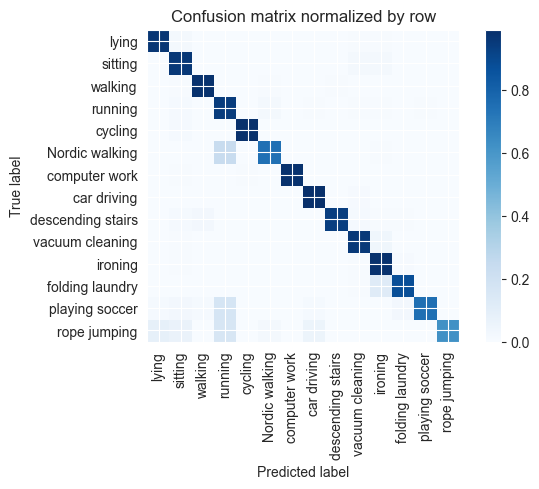

Training Epoch:  73%|███████▎  | 11/15 [06:14<02:17, 34.33s/it]

Overall accuracy: 0.935

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.997      0.983      0.990      0.142        591|	 cycling: 0.005,	sitting: 0.005,	
          ironing       0.898      0.980      0.938      0.111        460|	 folding laundry: 0.009,	vacuum cleaning: 0.007,	
          walking       0.987      0.980      0.983      0.109        453|	 Nordic walking: 0.007,	descending stairs: 0.004,	
            lying       0.978      0.966      0.972      0.099        410|	 sitting: 0.020,	ironing: 0.005,	
          sitting       0.907      0.959      0.932      0.088        367|	 ironing: 0.019,	vacuum cleaning: 0.016,	
  vacuum cleaning       0.943      0.954      0.949      0.084        349|	 ironing: 0.037,	sitting: 0.006,	
   Nordic walking       0.966      0.744      0.840      0.083        347|	 running: 0.239,	ironing: 0.006,	
          cycling       0.988      0.985      0.987      0.081        338|	 si


train: 100%|██████████| 261/261 [00:30<00:00,  8.63batch/s, loss=4.19, accuracy=0.953]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.33batch/s, loss=1.84]


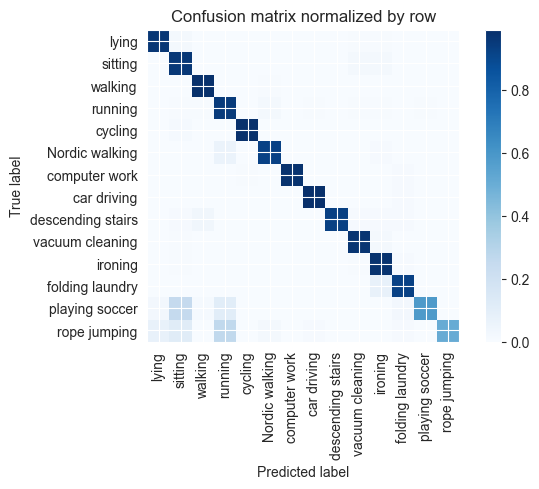

Training Epoch:  80%|████████  | 12/15 [06:49<01:43, 34.36s/it]

Overall accuracy: 0.946

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.997      0.976      0.986      0.142        592|	 folding laundry: 0.008,	cycling: 0.005,	
          ironing       0.916      0.978      0.946      0.110        459|	 folding laundry: 0.011,	vacuum cleaning: 0.007,	
          walking       0.980      0.984      0.982      0.108        451|	 Nordic walking: 0.007,	ironing: 0.002,	
            lying       0.978      0.963      0.970      0.098        409|	 sitting: 0.020,	vacuum cleaning: 0.007,	
          sitting       0.870      0.960      0.913      0.089        371|	 ironing: 0.019,	vacuum cleaning: 0.016,	
  vacuum cleaning       0.947      0.969      0.958      0.084        351|	 ironing: 0.023,	sitting: 0.006,	
   Nordic walking       0.973      0.925      0.948      0.083        347|	 running: 0.061,	ironing: 0.012,	
          cycling       0.991      0.985      0.988      0.081        33


train: 100%|██████████| 261/261 [00:30<00:00,  8.61batch/s, loss=7.17, accuracy=0.938]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.41batch/s, loss=3.58]


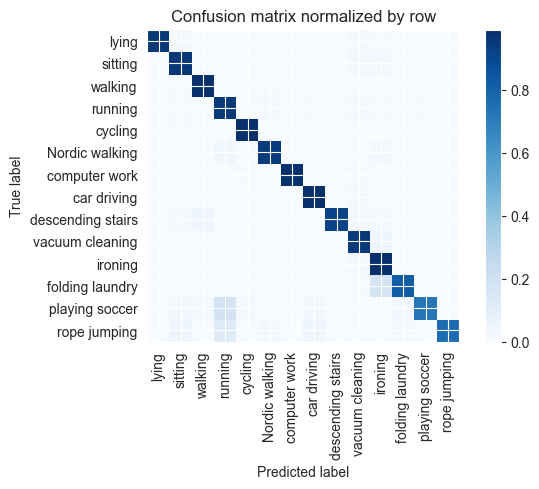

Training Epoch:  87%|████████▋ | 13/15 [07:23<01:08, 34.40s/it]

Overall accuracy: 0.952

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.997      0.983      0.990      0.143        596|	 vacuum cleaning: 0.005,	cycling: 0.005,	
          ironing       0.867      0.987      0.923      0.110        456|	 vacuum cleaning: 0.009,	folding laundry: 0.002,	
          walking       0.980      0.985      0.982      0.109        454|	 Nordic walking: 0.007,	sitting: 0.004,	
            lying       1.000      0.961      0.980      0.099        411|	 sitting: 0.019,	vacuum cleaning: 0.010,	
          sitting       0.937      0.960      0.948      0.089        371|	 vacuum cleaning: 0.019,	ironing: 0.016,	
  vacuum cleaning       0.922      0.951      0.937      0.084        350|	 ironing: 0.043,	Nordic walking: 0.003,	
   Nordic walking       0.976      0.945      0.960      0.083        344|	 running: 0.035,	ironing: 0.017,	
          cycling       0.985      0.988      0.987      0.081   


train: 100%|██████████| 261/261 [00:30<00:00,  8.58batch/s, loss=4.59, accuracy=0.938]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 16.95batch/s, loss=2.99]


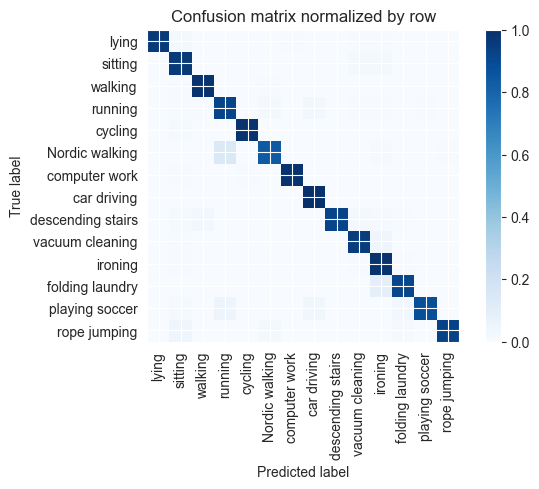

Training Epoch:  93%|█████████▎| 14/15 [07:58<00:34, 34.50s/it]

Overall accuracy: 0.954

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.985      0.990      0.142        591|	 cycling: 0.005,	sitting: 0.005,	
          ironing       0.902      0.985      0.941      0.110        457|	 vacuum cleaning: 0.007,	folding laundry: 0.004,	
          walking       0.985      0.985      0.985      0.109        452|	 Nordic walking: 0.004,	sitting: 0.004,	
            lying       1.000      0.964      0.981      0.099        411|	 sitting: 0.022,	ironing: 0.005,	
          sitting       0.917      0.959      0.938      0.089        370|	 ironing: 0.019,	vacuum cleaning: 0.016,	
  vacuum cleaning       0.948      0.951      0.950      0.084        348|	 ironing: 0.040,	sitting: 0.006,	
   Nordic walking       0.977      0.839      0.902      0.083        347|	 running: 0.138,	ironing: 0.012,	
          cycling       0.988      0.985      0.987      0.081        337|	 sitting: 0.0


train: 100%|██████████| 261/261 [00:30<00:00,  8.63batch/s, loss=4.15, accuracy=0.938]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.20batch/s, loss=4.76]


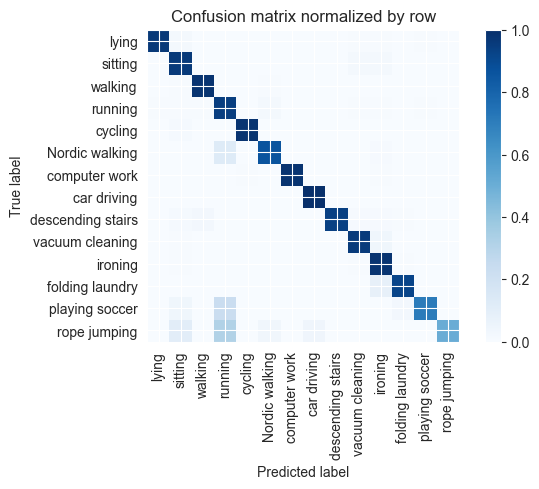

Overall accuracy: 0.944

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.997      0.981      0.989      0.143        594|	 ironing: 0.007,	cycling: 0.005,	
          ironing       0.904      0.983      0.942      0.111        461|	 folding laundry: 0.007,	vacuum cleaning: 0.007,	
          walking       0.987      0.982      0.985      0.109        453|	 Nordic walking: 0.007,	sitting: 0.004,	
            lying       0.997      0.963      0.980      0.098        407|	 sitting: 0.020,	playing soccer: 0.005,	
          sitting       0.905      0.959      0.931      0.088        366|	 ironing: 0.019,	vacuum cleaning: 0.016,	
  vacuum cleaning       0.949      0.954      0.952      0.084        350|	 ironing: 0.037,	sitting: 0.006,	
   Nordic walking       0.971      0.862      0.913      0.083        347|	 running: 0.124,	ironing: 0.009,	
          cycling       0.991      0.982      0.987      0.081        339|	 sitti

unseen: 100%|██████████| 87/87 [00:05<00:00, 17.24batch/s, loss=4.83]


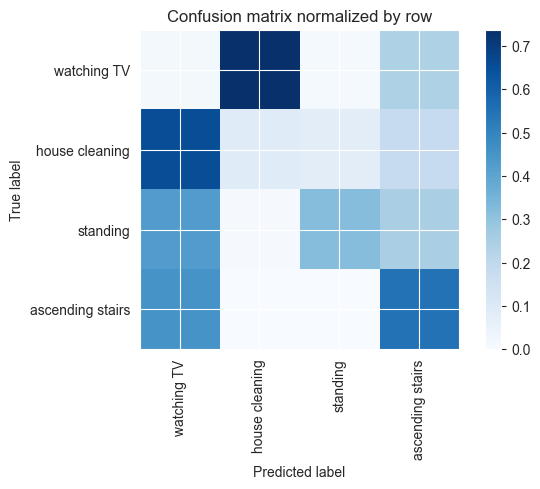

Overall accuracy: 0.242

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

        standing       0.793      0.317      0.453      0.330       1837|	 watching TV: 0.425,	ascending stairs: 0.250,	
  house cleaning       0.207      0.089      0.125      0.328       1829|	 watching TV: 0.652,	ascending stairs: 0.182,	
ascending stairs       0.373      0.547      0.444      0.193       1076|	 watching TV: 0.450,	standing: 0.003,	
     watching TV       0.005      0.015      0.007      0.148        826|	 house cleaning: 0.737,	ascending stairs: 0.237,	

----------------------------------------------------------------------------------------------------
     avg / total       0.403      0.242      0.277        1.0       5568|	      

{'accuracy': 0.24173850574712644, 'precision': 0.3445958589511703, 'recall': 0.24196656394045205, 'f1': 0.2571667613622803}
================ Fold-1 ================
Unseen Classes : ['walking', 'rope jumping', 'sitting',

Training Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

torch.Size([14, 512])



train: 100%|██████████| 262/262 [00:29<00:00,  8.78batch/s, loss=6.75, accuracy=0.75]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.89batch/s, loss=6.18]


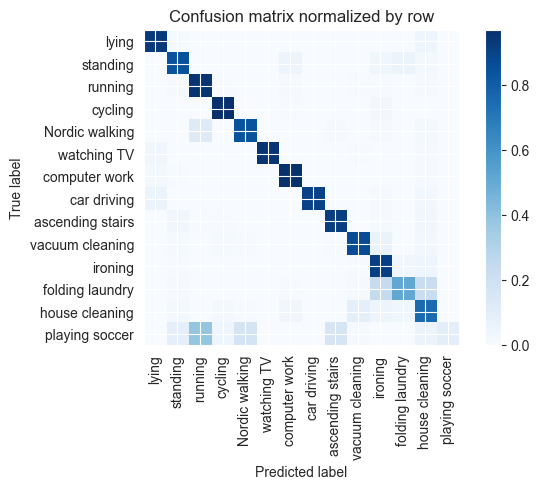

Training Epoch:   7%|▋         | 1/15 [00:33<07:55, 33.99s/it]

Overall accuracy: 0.863

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.942      0.964      0.953      0.145        604|	 lying: 0.017,	house cleaning: 0.010,	
         ironing       0.785      0.913      0.844      0.111        460|	 house cleaning: 0.043,	folding laundry: 0.033,	
        standing       0.886      0.845      0.865      0.093        387|	 folding laundry: 0.052,	computer work: 0.049,	
  house cleaning       0.685      0.753      0.718      0.087        361|	 vacuum cleaning: 0.089,	ironing: 0.047,	
  Nordic walking       0.938      0.838      0.885      0.086        359|	 running: 0.120,	house cleaning: 0.017,	
           lying       0.935      0.935      0.935      0.082        341|	 house cleaning: 0.044,	standing: 0.012,	
         cycling       0.951      0.970      0.960      0.081        337|	 ironing: 0.024,	computer work: 0.006,	
 vacuum cleaning       0.878      0.867      0.872      0.080   


train: 100%|██████████| 262/262 [00:30<00:00,  8.65batch/s, loss=6.84, accuracy=0.859]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.52batch/s, loss=6.44]


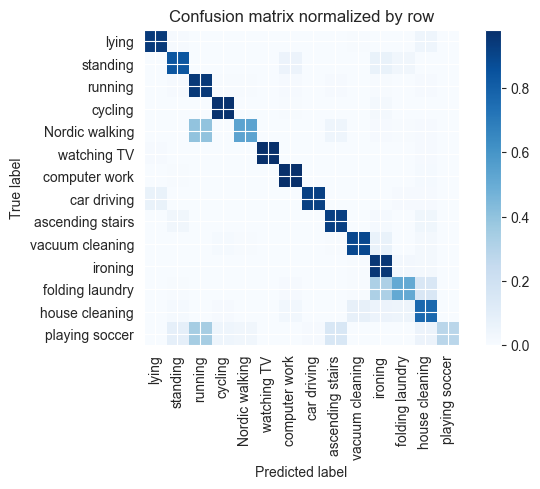

Training Epoch:  13%|█▎        | 2/15 [01:08<07:25, 34.28s/it]

Overall accuracy: 0.851

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.940      0.980      0.959      0.145        604|	 house cleaning: 0.012,	standing: 0.005,	
         ironing       0.755      0.950      0.841      0.111        463|	 folding laundry: 0.024,	house cleaning: 0.019,	
        standing       0.910      0.837      0.872      0.093        387|	 ironing: 0.067,	computer work: 0.057,	
  house cleaning       0.761      0.767      0.764      0.088        365|	 vacuum cleaning: 0.077,	ironing: 0.055,	
  Nordic walking       0.969      0.532      0.687      0.085        355|	 running: 0.394,	ascending stairs: 0.045,	
           lying       0.970      0.938      0.954      0.081        339|	 house cleaning: 0.044,	standing: 0.009,	
 vacuum cleaning       0.897      0.889      0.893      0.080        334|	 ironing: 0.066,	house cleaning: 0.018,	
         cycling       0.964      0.970      0.967      0.080     


train: 100%|██████████| 262/262 [00:30<00:00,  8.64batch/s, loss=6.57, accuracy=0.844]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.18batch/s, loss=5.53]


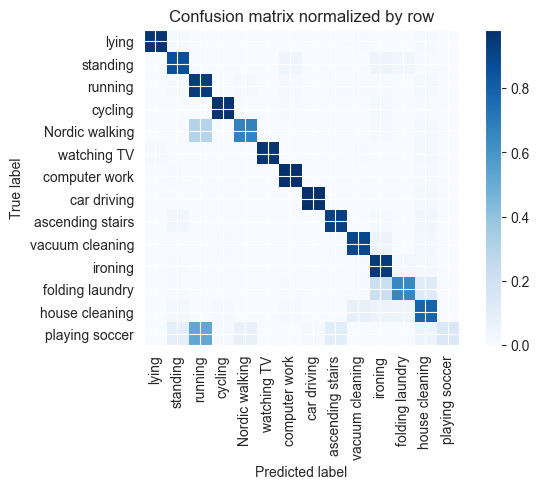

Training Epoch:  20%|██        | 3/15 [01:43<06:52, 34.41s/it]

Overall accuracy: 0.874

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.960      0.980      0.970      0.145        605|	 house cleaning: 0.008,	standing: 0.005,	
         ironing       0.793      0.946      0.863      0.111        461|	 folding laundry: 0.026,	house cleaning: 0.020,	
        standing       0.902      0.865      0.883      0.092        384|	 ironing: 0.047,	computer work: 0.044,	
  house cleaning       0.773      0.784      0.779      0.087        361|	 vacuum cleaning: 0.078,	ironing: 0.055,	
  Nordic walking       0.964      0.670      0.791      0.085        355|	 running: 0.296,	house cleaning: 0.020,	
           lying       0.991      0.965      0.978      0.082        342|	 standing: 0.015,	house cleaning: 0.012,	
         cycling       0.979      0.967      0.973      0.081        336|	 ironing: 0.021,	house cleaning: 0.006,	
 vacuum cleaning       0.893      0.901      0.897      0.080       


train: 100%|██████████| 262/262 [00:31<00:00,  8.28batch/s, loss=6.19, accuracy=0.875]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.49batch/s, loss=5.18]


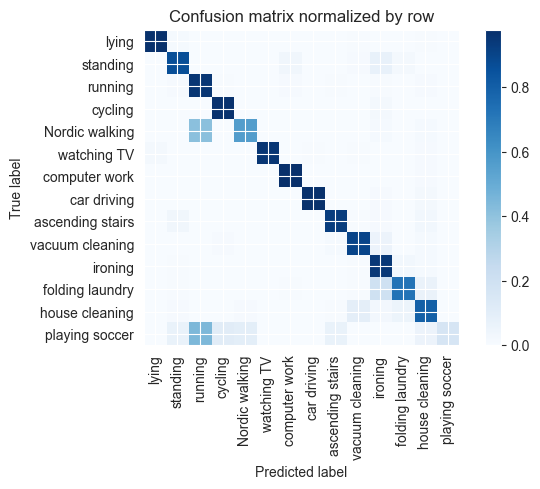

Training Epoch:  27%|██▋       | 4/15 [02:18<06:24, 34.96s/it]

Overall accuracy: 0.871

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.972      0.978      0.975      0.145        604|	 house cleaning: 0.010,	folding laundry: 0.003,	
         ironing       0.799      0.946      0.866      0.111        461|	 folding laundry: 0.030,	house cleaning: 0.013,	
        standing       0.915      0.868      0.891      0.093        385|	 ironing: 0.073,	computer work: 0.031,	
  house cleaning       0.840      0.798      0.818      0.087        361|	 vacuum cleaning: 0.094,	folding laundry: 0.053,	
  Nordic walking       0.939      0.559      0.701      0.086        358|	 running: 0.411,	house cleaning: 0.014,	
           lying       0.985      0.971      0.978      0.083        344|	 standing: 0.015,	house cleaning: 0.006,	
         cycling       0.953      0.970      0.962      0.081        336|	 ironing: 0.021,	house cleaning: 0.003,	
 vacuum cleaning       0.865      0.901      0.882   


train: 100%|██████████| 262/262 [00:30<00:00,  8.64batch/s, loss=5.15, accuracy=0.875]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.59batch/s, loss=4.69]


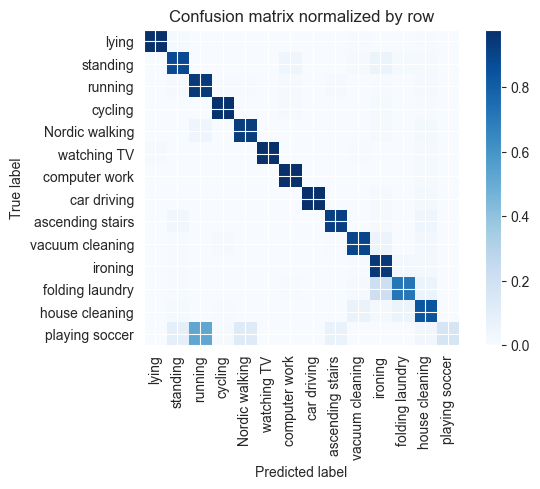

Training Epoch:  33%|███▎      | 5/15 [02:53<05:47, 34.79s/it]

Overall accuracy: 0.906

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.964      0.978      0.971      0.145        604|	 house cleaning: 0.013,	standing: 0.003,	
         ironing       0.812      0.947      0.875      0.110        457|	 folding laundry: 0.028,	house cleaning: 0.015,	
        standing       0.907      0.881      0.894      0.093        387|	 ironing: 0.052,	computer work: 0.039,	
  house cleaning       0.822      0.837      0.829      0.087        363|	 vacuum cleaning: 0.063,	folding laundry: 0.052,	
  Nordic walking       0.965      0.927      0.946      0.086        356|	 running: 0.042,	house cleaning: 0.017,	
           lying       0.991      0.971      0.981      0.082        343|	 standing: 0.015,	house cleaning: 0.006,	
         cycling       0.979      0.971      0.975      0.081        339|	 ironing: 0.015,	computer work: 0.009,	
 vacuum cleaning       0.901      0.895      0.898      0.080


train: 100%|██████████| 262/262 [00:30<00:00,  8.53batch/s, loss=5.02, accuracy=0.953]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.32batch/s, loss=4.76]


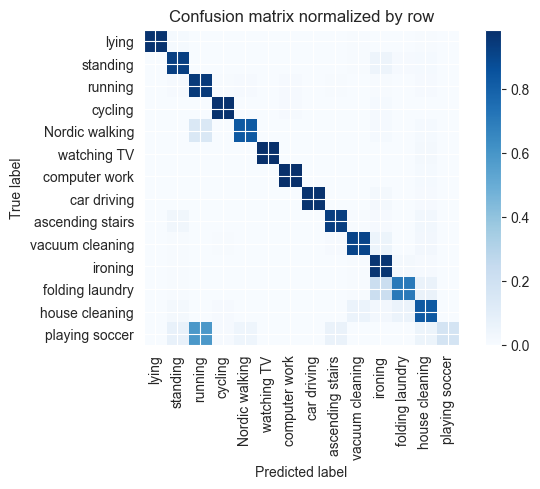

Training Epoch:  40%|████      | 6/15 [03:28<05:13, 34.85s/it]

Overall accuracy: 0.903

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.990      0.980      0.985      0.145        605|	 house cleaning: 0.012,	standing: 0.003,	
         ironing       0.810      0.961      0.879      0.111        460|	 folding laundry: 0.022,	house cleaning: 0.009,	
        standing       0.911      0.922      0.917      0.093        387|	 ironing: 0.049,	house cleaning: 0.013,	
  house cleaning       0.831      0.829      0.830      0.087        362|	 folding laundry: 0.058,	vacuum cleaning: 0.058,	
  Nordic walking       0.980      0.827      0.897      0.086        359|	 running: 0.142,	house cleaning: 0.014,	
           lying       0.997      0.971      0.984      0.082        341|	 standing: 0.015,	house cleaning: 0.006,	
         cycling       0.979      0.973      0.976      0.081        335|	 ironing: 0.015,	computer work: 0.009,	
 vacuum cleaning       0.912      0.903      0.907      0.08


train: 100%|██████████| 262/262 [00:30<00:00,  8.67batch/s, loss=4.49, accuracy=0.906]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.30batch/s, loss=4.54]


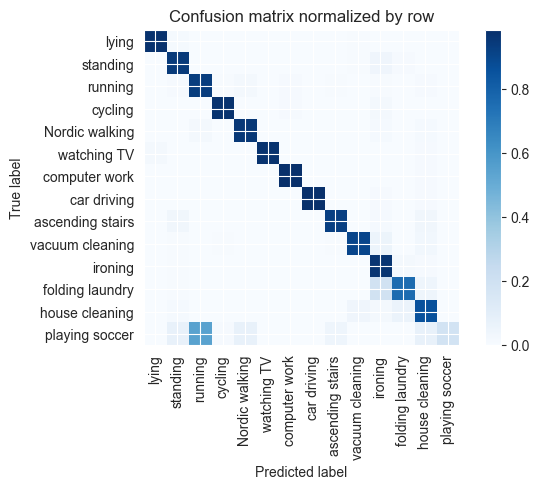

Training Epoch:  47%|████▋     | 7/15 [04:02<04:37, 34.72s/it]

Overall accuracy: 0.921

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.990      0.983      0.987      0.145        605|	 house cleaning: 0.010,	standing: 0.003,	
         ironing       0.824      0.963      0.888      0.111        461|	 folding laundry: 0.020,	house cleaning: 0.009,	
        standing       0.912      0.943      0.927      0.092        384|	 ironing: 0.042,	folding laundry: 0.008,	
  house cleaning       0.850      0.860      0.855      0.087        363|	 folding laundry: 0.058,	vacuum cleaning: 0.039,	
  Nordic walking       0.968      0.949      0.959      0.086        356|	 running: 0.020,	house cleaning: 0.014,	
           lying       0.988      0.974      0.981      0.082        343|	 standing: 0.015,	vacuum cleaning: 0.006,	
         cycling       0.985      0.970      0.978      0.081        338|	 ironing: 0.018,	computer work: 0.009,	
 vacuum cleaning       0.940      0.900      0.920      0.


train: 100%|██████████| 262/262 [00:30<00:00,  8.67batch/s, loss=4.47, accuracy=0.844]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.30batch/s, loss=3.39]


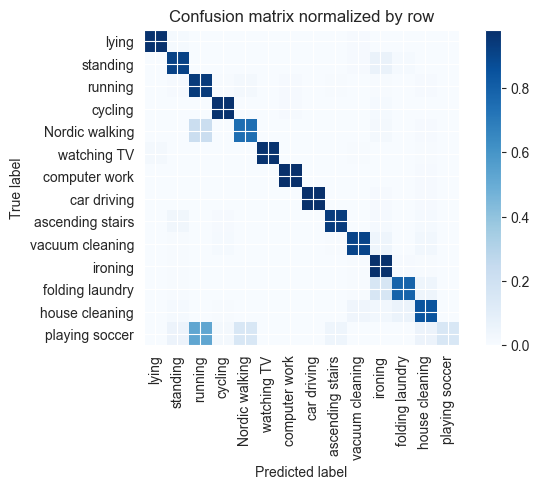

Training Epoch:  53%|█████▎    | 8/15 [04:37<04:02, 34.63s/it]

Overall accuracy: 0.902

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.988      0.980      0.984      0.146        608|	 house cleaning: 0.010,	standing: 0.003,	
         ironing       0.820      0.974      0.890      0.110        459|	 folding laundry: 0.011,	vacuum cleaning: 0.007,	
        standing       0.916      0.911      0.914      0.092        383|	 ironing: 0.063,	folding laundry: 0.013,	
  house cleaning       0.874      0.845      0.859      0.087        361|	 folding laundry: 0.058,	vacuum cleaning: 0.042,	
  Nordic walking       0.937      0.747      0.831      0.086        356|	 running: 0.222,	ironing: 0.017,	
           lying       0.982      0.971      0.976      0.082        342|	 standing: 0.015,	vacuum cleaning: 0.009,	
         cycling       0.968      0.973      0.971      0.081        339|	 ironing: 0.015,	computer work: 0.009,	
 vacuum cleaning       0.920      0.901      0.910      0.080   


train: 100%|██████████| 262/262 [00:30<00:00,  8.66batch/s, loss=3.72, accuracy=0.969]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.06batch/s, loss=4.21]


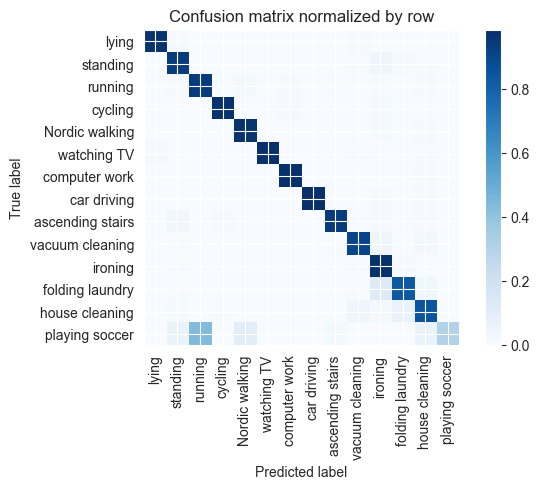

Training Epoch:  60%|██████    | 9/15 [05:11<03:27, 34.59s/it]

Overall accuracy: 0.930

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.987      0.983      0.985      0.145        605|	 house cleaning: 0.010,	standing: 0.003,	
         ironing       0.856      0.976      0.912      0.112        464|	 folding laundry: 0.013,	vacuum cleaning: 0.004,	
        standing       0.916      0.938      0.927      0.092        384|	 ironing: 0.042,	folding laundry: 0.008,	
  house cleaning       0.873      0.842      0.857      0.087        360|	 folding laundry: 0.067,	vacuum cleaning: 0.044,	
  Nordic walking       0.961      0.969      0.965      0.085        354|	 ironing: 0.014,	house cleaning: 0.011,	
           lying       0.991      0.971      0.981      0.083        344|	 standing: 0.015,	vacuum cleaning: 0.009,	
         cycling       0.982      0.973      0.978      0.081        335|	 ironing: 0.015,	computer work: 0.009,	
 vacuum cleaning       0.920      0.907      0.914      0


train: 100%|██████████| 262/262 [00:30<00:00,  8.56batch/s, loss=3.52, accuracy=0.922]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.22batch/s, loss=3.5] 


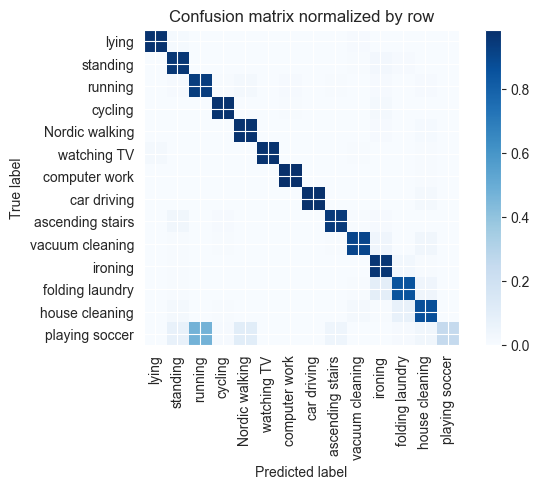

Training Epoch:  67%|██████▋   | 10/15 [05:46<02:53, 34.67s/it]

Overall accuracy: 0.931

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.988      0.985      0.987      0.146        607|	 house cleaning: 0.007,	standing: 0.003,	
         ironing       0.886      0.959      0.921      0.111        461|	 folding laundry: 0.028,	standing: 0.007,	
        standing       0.908      0.955      0.931      0.092        381|	 ironing: 0.026,	folding laundry: 0.008,	
  house cleaning       0.885      0.868      0.877      0.087        364|	 folding laundry: 0.077,	vacuum cleaning: 0.022,	
  Nordic walking       0.961      0.972      0.967      0.086        358|	 house cleaning: 0.014,	ironing: 0.008,	
           lying       0.988      0.971      0.979      0.082        342|	 standing: 0.015,	vacuum cleaning: 0.009,	
         cycling       0.976      0.970      0.973      0.081        336|	 ironing: 0.018,	computer work: 0.006,	
 vacuum cleaning       0.947      0.901      0.923      0.080   


train: 100%|██████████| 262/262 [00:30<00:00,  8.58batch/s, loss=4.72, accuracy=0.922]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.18batch/s, loss=3.61]


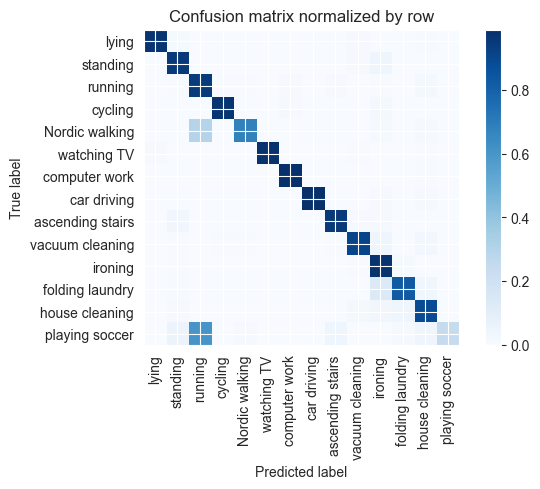

Training Epoch:  73%|███████▎  | 11/15 [06:21<02:18, 34.74s/it]

Overall accuracy: 0.908

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.988      0.987      0.988      0.145        605|	 house cleaning: 0.007,	folding laundry: 0.002,	
         ironing       0.844      0.974      0.905      0.111        462|	 folding laundry: 0.013,	vacuum cleaning: 0.006,	
        standing       0.928      0.945      0.936      0.092        382|	 ironing: 0.042,	vacuum cleaning: 0.008,	
  house cleaning       0.896      0.882      0.889      0.087        363|	 folding laundry: 0.044,	ironing: 0.033,	
  Nordic walking       0.984      0.677      0.802      0.086        359|	 running: 0.295,	ironing: 0.014,	
           lying       0.991      0.971      0.981      0.082        340|	 standing: 0.012,	vacuum cleaning: 0.009,	
         cycling       0.988      0.971      0.979      0.081        339|	 ironing: 0.018,	computer work: 0.009,	
 vacuum cleaning       0.938      0.907      0.922      0.080    


train: 100%|██████████| 262/262 [00:30<00:00,  8.68batch/s, loss=4.52, accuracy=0.938]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.05batch/s, loss=2.94]


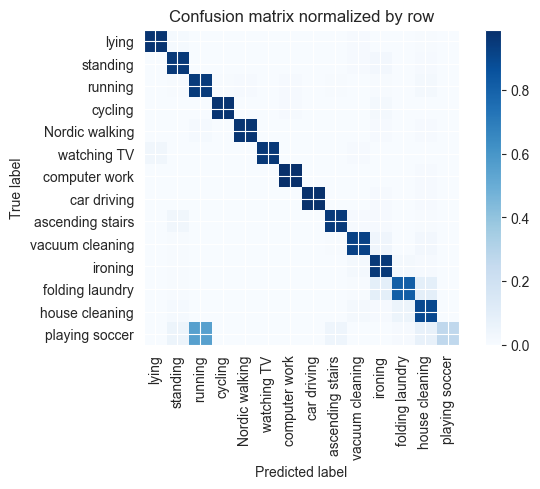

Training Epoch:  80%|████████  | 12/15 [06:55<01:43, 34.65s/it]

Overall accuracy: 0.931

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.987      0.987      0.987      0.146        606|	 house cleaning: 0.010,	standing: 0.002,	
         ironing       0.883      0.950      0.915      0.111        460|	 folding laundry: 0.020,	vacuum cleaning: 0.017,	
        standing       0.926      0.951      0.938      0.092        384|	 ironing: 0.026,	vacuum cleaning: 0.010,	
  house cleaning       0.852      0.892      0.872      0.087        362|	 folding laundry: 0.052,	vacuum cleaning: 0.022,	
  Nordic walking       0.991      0.964      0.977      0.086        358|	 running: 0.014,	ironing: 0.011,	
           lying       0.979      0.971      0.975      0.082        340|	 standing: 0.012,	vacuum cleaning: 0.009,	
         cycling       0.994      0.970      0.982      0.081        336|	 ironing: 0.018,	computer work: 0.009,	
 vacuum cleaning       0.916      0.919      0.918      0.080   


train: 100%|██████████| 262/262 [00:30<00:00,  8.57batch/s, loss=5.98, accuracy=0.859]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.01batch/s, loss=2.79]


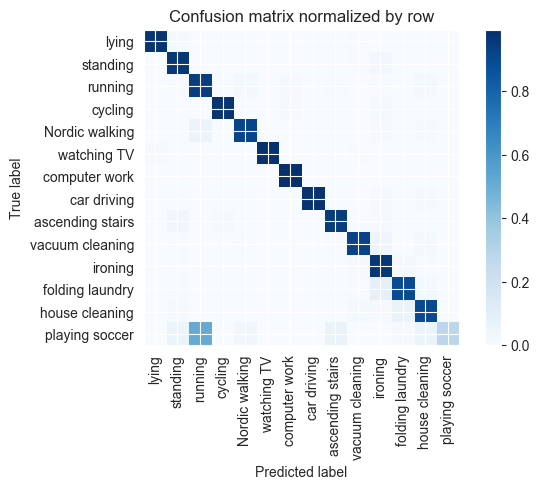

Training Epoch:  87%|████████▋ | 13/15 [07:30<01:09, 34.71s/it]

Overall accuracy: 0.936

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.989      0.993      0.991      0.146        606|	 house cleaning: 0.003,	standing: 0.002,	
         ironing       0.893      0.963      0.927      0.111        461|	 folding laundry: 0.017,	vacuum cleaning: 0.009,	
        standing       0.925      0.966      0.945      0.092        384|	 ironing: 0.023,	vacuum cleaning: 0.005,	
  house cleaning       0.913      0.893      0.903      0.087        364|	 folding laundry: 0.063,	vacuum cleaning: 0.016,	
  Nordic walking       0.976      0.912      0.943      0.085        354|	 running: 0.059,	house cleaning: 0.011,	
           lying       0.991      0.977      0.984      0.082        341|	 standing: 0.012,	vacuum cleaning: 0.006,	
         cycling       0.988      0.970      0.979      0.081        337|	 ironing: 0.015,	computer work: 0.009,	
 vacuum cleaning       0.947      0.919      0.933      0


train: 100%|██████████| 262/262 [00:31<00:00,  8.37batch/s, loss=5.29, accuracy=0.922]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 17.46batch/s, loss=3.08]


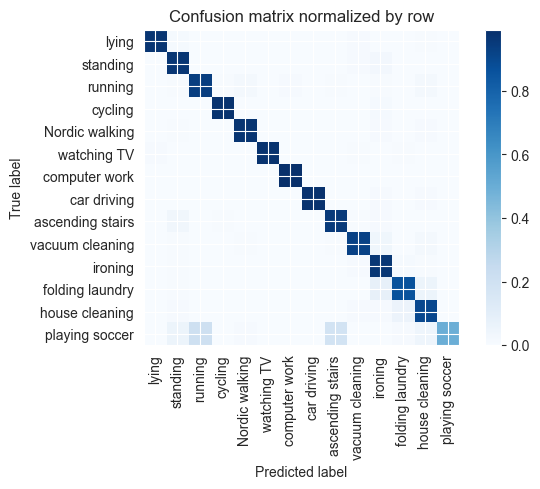

Training Epoch:  93%|█████████▎| 14/15 [08:06<00:34, 34.95s/it]

Overall accuracy: 0.946

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.992      0.992      0.992      0.146        606|	 folding laundry: 0.003,	house cleaning: 0.002,	
         ironing       0.895      0.963      0.928      0.110        459|	 folding laundry: 0.015,	vacuum cleaning: 0.011,	
        standing       0.925      0.966      0.945      0.092        383|	 ironing: 0.023,	vacuum cleaning: 0.008,	
  Nordic walking       0.983      0.972      0.978      0.087        361|	 house cleaning: 0.011,	ironing: 0.008,	
  house cleaning       0.902      0.902      0.902      0.086        358|	 folding laundry: 0.056,	ironing: 0.011,	
           lying       0.991      0.971      0.981      0.082        342|	 standing: 0.012,	vacuum cleaning: 0.009,	
         cycling       0.991      0.976      0.984      0.081        339|	 ironing: 0.015,	house cleaning: 0.003,	
 vacuum cleaning       0.945      0.925      0.935      0


train: 100%|██████████| 262/262 [00:31<00:00,  8.39batch/s, loss=4.03, accuracy=0.938]


torch.Size([14, 512])



seen: 100%|██████████| 65/65 [00:03<00:00, 16.97batch/s, loss=3.55]


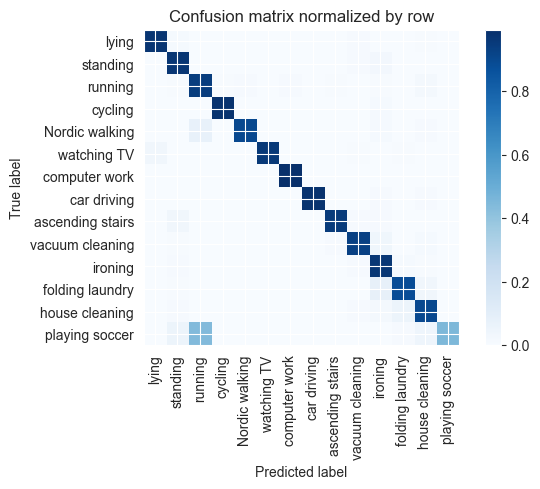

Overall accuracy: 0.940

                   precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

   computer work       0.992      0.993      0.993      0.146        607|	 house cleaning: 0.002,	folding laundry: 0.002,	
         ironing       0.889      0.965      0.925      0.111        463|	 folding laundry: 0.013,	vacuum cleaning: 0.009,	
        standing       0.926      0.969      0.947      0.093        385|	 ironing: 0.023,	vacuum cleaning: 0.008,	
  house cleaning       0.918      0.900      0.909      0.087        361|	 folding laundry: 0.053,	ironing: 0.017,	
  Nordic walking       0.991      0.900      0.943      0.086        359|	 running: 0.072,	ironing: 0.014,	
           lying       0.979      0.971      0.975      0.082        340|	 standing: 0.012,	vacuum cleaning: 0.009,	
         cycling       0.994      0.979      0.986      0.081        335|	 ironing: 0.015,	house cleaning: 0.003,	
 vacuum cleaning       0.948      0.928      0.938      0.080   

unseen: 100%|██████████| 86/86 [00:04<00:00, 18.44batch/s, loss=3.61]


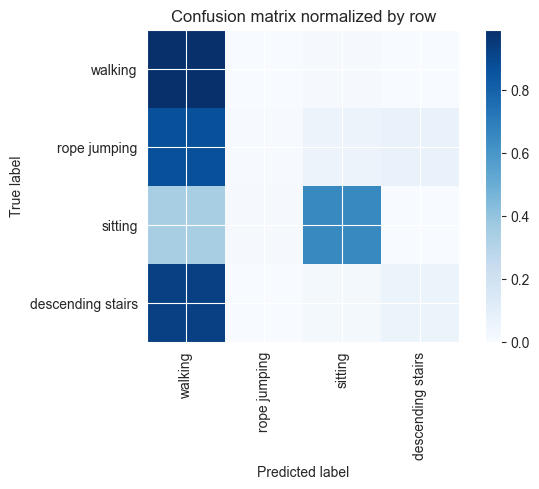

Overall accuracy: 0.639

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          walking       0.551      0.992      0.708      0.422       2320|	 sitting: 0.008,	descending stairs: 0.000,	
          sitting       0.949      0.652      0.773      0.325       1789|	 walking: 0.339,	rope jumping: 0.009,	
descending stairs       0.608      0.051      0.094      0.171        939|	 walking: 0.929,	sitting: 0.020,	
     rope jumping       0.158      0.007      0.013      0.083        456|	 walking: 0.871,	descending stairs: 0.068,	sitting: 0.055,	

----------------------------------------------------------------------------------------------------
      avg / total       0.657      0.639      0.567        1.0       5504|	      

{'accuracy': 0.6393531976744186, 'precision': 0.5663189771205702, 'recall': 0.42545680868807767, 'f1': 0.3971184425700375}
================ Fold-2 ================
Unseen Classes : ['playing soccer', 'lying', 'vacuum cle

Training Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

torch.Size([14, 512])



train: 100%|██████████| 242/242 [00:27<00:00,  8.69batch/s, loss=7.38, accuracy=0.781]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 17.25batch/s, loss=8.06]


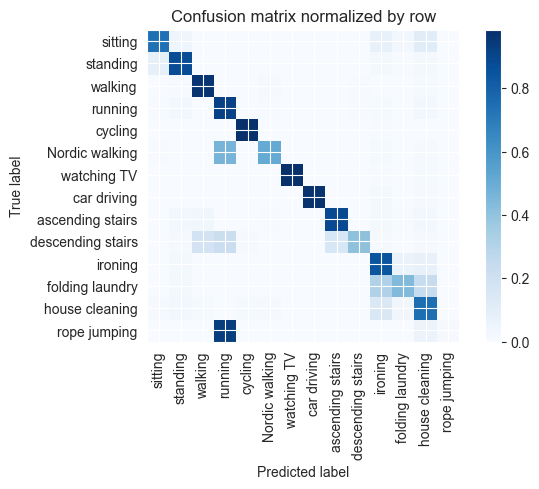

Training Epoch:   7%|▋         | 1/15 [00:31<07:25, 31.79s/it]

Overall accuracy: 0.776

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.718      0.843      0.775      0.126        485|	 house cleaning: 0.076,	folding laundry: 0.064,	
          walking       0.906      0.963      0.933      0.120        459|	 house cleaning: 0.015,	Nordic walking: 0.011,	
   Nordic walking       0.946      0.508      0.661      0.099        382|	 running: 0.463,	ironing: 0.013,	
   house cleaning       0.634      0.747      0.686      0.094        360|	 ironing: 0.142,	folding laundry: 0.033,	
         standing       0.856      0.873      0.864      0.092        354|	 sitting: 0.082,	ironing: 0.023,	
          sitting       0.875      0.738      0.801      0.089        340|	 house cleaning: 0.112,	ironing: 0.076,	
          cycling       0.978      0.984      0.981      0.083        317|	 ironing: 0.006,	house cleaning: 0.003,	
 ascending stairs       0.872      0.888      0.880      0.056      


train: 100%|██████████| 242/242 [00:28<00:00,  8.45batch/s, loss=7.39, accuracy=0.734]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 17.48batch/s, loss=5.85]


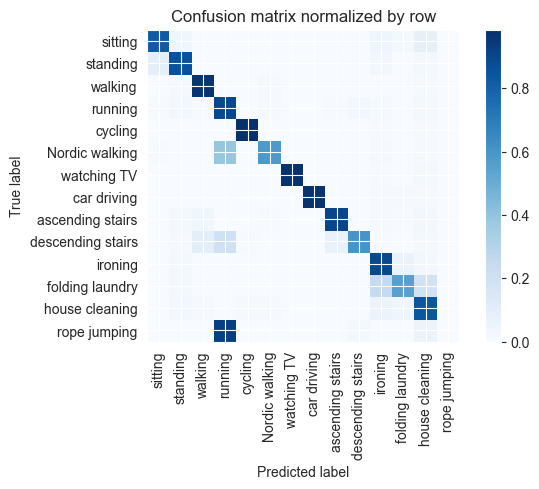

Training Epoch:  13%|█▎        | 2/15 [01:04<06:59, 32.24s/it]

Overall accuracy: 0.818

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.806      0.890      0.846      0.125        480|	 folding laundry: 0.062,	house cleaning: 0.029,	
          walking       0.934      0.965      0.949      0.119        456|	 house cleaning: 0.013,	Nordic walking: 0.009,	
   Nordic walking       0.953      0.583      0.724      0.100        384|	 running: 0.388,	house cleaning: 0.010,	
   house cleaning       0.722      0.841      0.777      0.093        359|	 ironing: 0.056,	folding laundry: 0.039,	
         standing       0.858      0.858      0.858      0.093        358|	 sitting: 0.092,	ironing: 0.028,	
          sitting       0.881      0.825      0.852      0.089        342|	 house cleaning: 0.079,	ironing: 0.041,	
          cycling       0.987      0.984      0.986      0.083        319|	 house cleaning: 0.009,	ironing: 0.006,	
 ascending stairs       0.937      0.902      0.919      0.05


train: 100%|██████████| 242/242 [00:28<00:00,  8.59batch/s, loss=6.98, accuracy=0.781]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 17.33batch/s, loss=5.06]


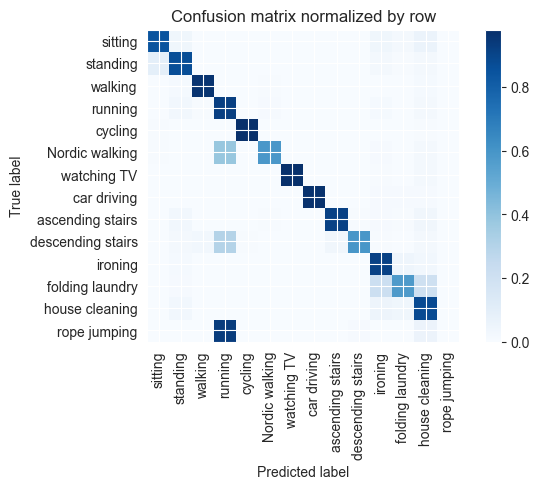

Training Epoch:  20%|██        | 3/15 [01:36<06:26, 32.19s/it]

Overall accuracy: 0.831

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.834      0.913      0.872      0.126        483|	 folding laundry: 0.043,	house cleaning: 0.027,	
          walking       0.984      0.963      0.973      0.119        457|	 house cleaning: 0.015,	standing: 0.013,	
   Nordic walking       0.966      0.589      0.732      0.099        382|	 running: 0.380,	house cleaning: 0.016,	
   house cleaning       0.736      0.878      0.801      0.094        362|	 ironing: 0.047,	folding laundry: 0.036,	
         standing       0.855      0.867      0.861      0.094        360|	 sitting: 0.089,	ironing: 0.022,	
          sitting       0.884      0.845      0.864      0.089        343|	 house cleaning: 0.061,	ironing: 0.035,	
          cycling       0.997      0.981      0.989      0.082        315|	 house cleaning: 0.006,	sitting: 0.006,	
 ascending stairs       0.970      0.915      0.942      0.055     


train: 100%|██████████| 242/242 [00:28<00:00,  8.50batch/s, loss=6.83, accuracy=0.859]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 17.44batch/s, loss=6.53]


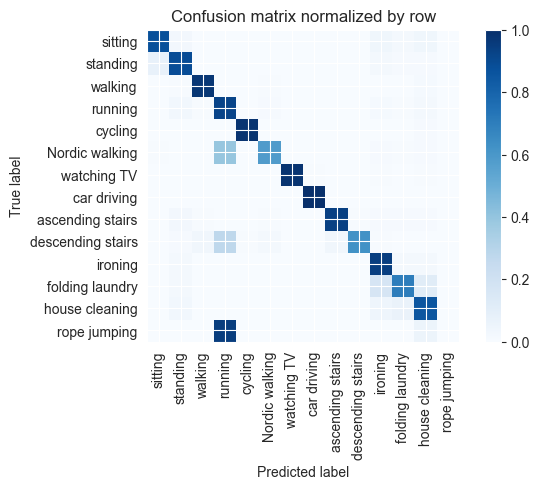

Training Epoch:  27%|██▋       | 4/15 [02:08<05:54, 32.27s/it]

Overall accuracy: 0.845

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.854      0.942      0.896      0.126        484|	 folding laundry: 0.023,	house cleaning: 0.017,	
          walking       0.980      0.969      0.975      0.119        458|	 house cleaning: 0.015,	Nordic walking: 0.007,	
   Nordic walking       0.957      0.578      0.721      0.100        384|	 running: 0.391,	house cleaning: 0.010,	
   house cleaning       0.812      0.852      0.831      0.095        364|	 folding laundry: 0.066,	ironing: 0.047,	
         standing       0.873      0.888      0.880      0.093        356|	 sitting: 0.076,	ironing: 0.017,	
          sitting       0.902      0.878      0.890      0.088        337|	 house cleaning: 0.039,	ironing: 0.039,	
          cycling       0.994      0.981      0.987      0.082        313|	 house cleaning: 0.010,	ironing: 0.003,	
 ascending stairs       0.971      0.934      0.952      0.05


train: 100%|██████████| 242/242 [00:29<00:00,  8.33batch/s, loss=5.51, accuracy=0.859]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 16.84batch/s, loss=5.45]


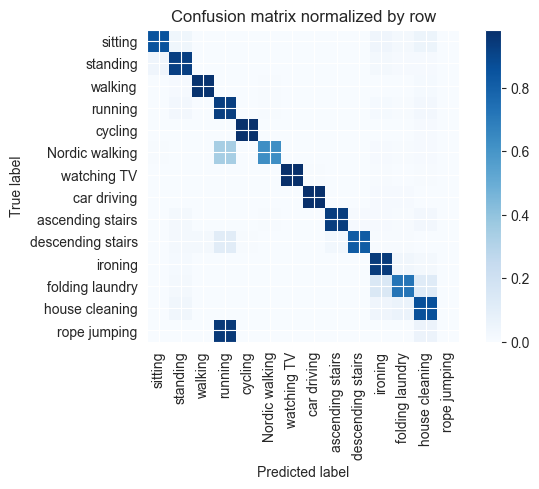

Training Epoch:  33%|███▎      | 5/15 [02:41<05:25, 32.56s/it]

Overall accuracy: 0.860

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.860      0.936      0.897      0.127        486|	 folding laundry: 0.031,	house cleaning: 0.016,	
          walking       0.991      0.967      0.979      0.120        461|	 house cleaning: 0.013,	standing: 0.011,	
   Nordic walking       0.980      0.629      0.766      0.100        385|	 running: 0.340,	house cleaning: 0.010,	
   house cleaning       0.800      0.860      0.829      0.095        363|	 folding laundry: 0.061,	ironing: 0.041,	
         standing       0.864      0.921      0.892      0.092        353|	 sitting: 0.040,	ironing: 0.020,	
          sitting       0.938      0.850      0.892      0.088        339|	 house cleaning: 0.050,	ironing: 0.041,	
          cycling       0.994      0.978      0.986      0.082        313|	 house cleaning: 0.010,	folding laundry: 0.003,	
 ascending stairs       0.975      0.930      0.952      0.


train: 100%|██████████| 242/242 [00:28<00:00,  8.52batch/s, loss=8.05, accuracy=0.891]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 17.44batch/s, loss=4.94]


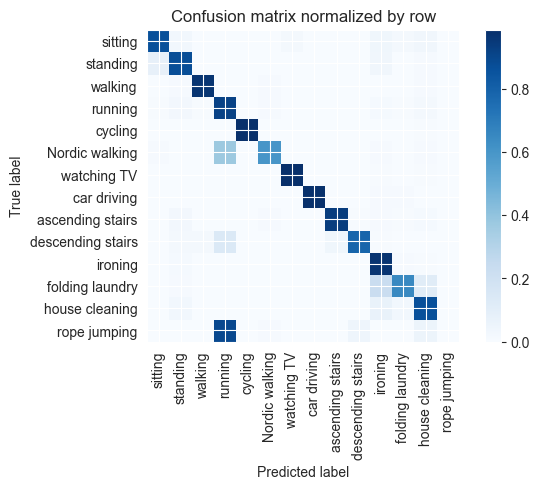

Training Epoch:  40%|████      | 6/15 [03:14<04:52, 32.47s/it]

Overall accuracy: 0.855

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.822      0.969      0.889      0.125        481|	 standing: 0.012,	folding laundry: 0.010,	
          walking       0.991      0.967      0.979      0.120        460|	 standing: 0.011,	house cleaning: 0.009,	
   Nordic walking       0.955      0.601      0.738      0.101        386|	 running: 0.373,	house cleaning: 0.008,	
   house cleaning       0.840      0.867      0.853      0.094        362|	 ironing: 0.066,	folding laundry: 0.030,	
         standing       0.868      0.873      0.871      0.092        355|	 sitting: 0.079,	ironing: 0.034,	
          sitting       0.894      0.868      0.881      0.089        340|	 ironing: 0.035,	house cleaning: 0.032,	
          cycling       1.000      0.984      0.992      0.083        319|	 house cleaning: 0.006,	ironing: 0.003,	
 ascending stairs       0.967      0.935      0.951      0.056        216


train: 100%|██████████| 242/242 [00:28<00:00,  8.41batch/s, loss=4.3, accuracy=0.859]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 17.25batch/s, loss=5.34]


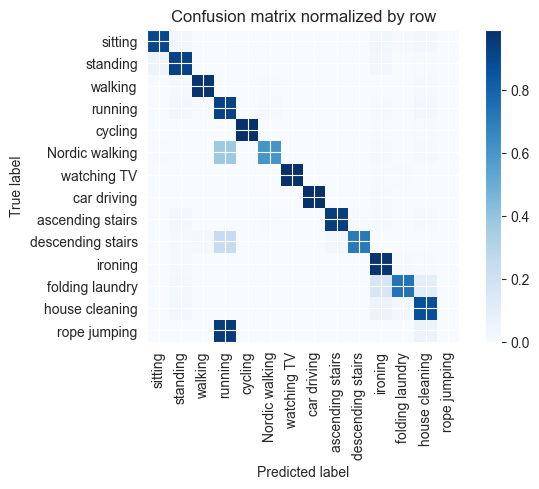

Training Epoch:  47%|████▋     | 7/15 [03:47<04:20, 32.61s/it]

Overall accuracy: 0.864

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.846      0.969      0.903      0.126        482|	 standing: 0.015,	folding laundry: 0.010,	
          walking       0.987      0.967      0.977      0.120        459|	 house cleaning: 0.015,	standing: 0.009,	
   Nordic walking       0.966      0.601      0.741      0.100        383|	 running: 0.368,	house cleaning: 0.013,	
   house cleaning       0.847      0.873      0.859      0.094        361|	 ironing: 0.055,	folding laundry: 0.030,	
         standing       0.872      0.921      0.896      0.093        356|	 sitting: 0.048,	ironing: 0.025,	
          sitting       0.936      0.898      0.917      0.089        343|	 ironing: 0.038,	standing: 0.029,	
          cycling       1.000      0.984      0.992      0.083        317|	 house cleaning: 0.006,	ironing: 0.006,	
 ascending stairs       0.975      0.938      0.956      0.055        210|	 sta


train: 100%|██████████| 242/242 [00:29<00:00,  8.21batch/s, loss=4.07, accuracy=0.938]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 17.04batch/s, loss=4.96]


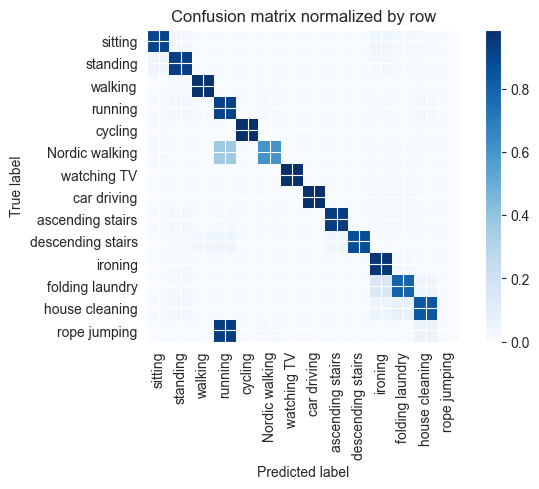

Training Epoch:  53%|█████▎    | 8/15 [04:20<03:50, 32.87s/it]

Overall accuracy: 0.873

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.861      0.965      0.910      0.125        480|	 folding laundry: 0.017,	standing: 0.015,	
          walking       0.985      0.974      0.979      0.119        458|	 standing: 0.009,	house cleaning: 0.007,	
   Nordic walking       0.963      0.608      0.745      0.100        385|	 running: 0.366,	sitting: 0.008,	
   house cleaning       0.907      0.839      0.872      0.094        361|	 folding laundry: 0.075,	ironing: 0.047,	
         standing       0.878      0.927      0.902      0.093        356|	 sitting: 0.042,	ironing: 0.020,	
          sitting       0.925      0.909      0.917      0.089        341|	 ironing: 0.038,	standing: 0.026,	
          cycling       1.000      0.984      0.992      0.082        315|	 house cleaning: 0.006,	sitting: 0.006,	
 ascending stairs       0.967      0.940      0.953      0.056        215|	 standing: 


train: 100%|██████████| 242/242 [00:28<00:00,  8.35batch/s, loss=5.79, accuracy=0.875]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 17.81batch/s, loss=2.86]


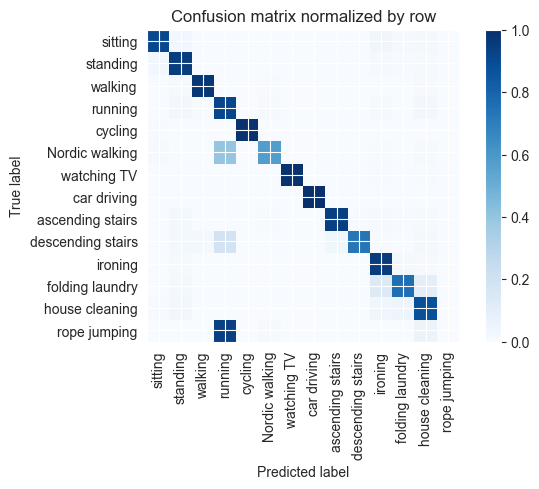

Training Epoch:  60%|██████    | 9/15 [04:53<03:17, 32.94s/it]

Overall accuracy: 0.865

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.876      0.950      0.911      0.124        477|	 folding laundry: 0.023,	standing: 0.015,	
          walking       0.989      0.972      0.980      0.120        461|	 house cleaning: 0.011,	standing: 0.009,	
   Nordic walking       0.969      0.574      0.721      0.099        380|	 running: 0.397,	house cleaning: 0.013,	
   house cleaning       0.841      0.878      0.859      0.094        361|	 folding laundry: 0.047,	ironing: 0.039,	
         standing       0.876      0.947      0.910      0.093        357|	 sitting: 0.028,	house cleaning: 0.011,	
          sitting       0.945      0.906      0.925      0.089        342|	 ironing: 0.035,	standing: 0.029,	
          cycling       1.000      0.987      0.994      0.083        317|	 sitting: 0.006,	house cleaning: 0.003,	
 ascending stairs       0.966      0.939      0.953      0.056        21


train: 100%|██████████| 242/242 [00:28<00:00,  8.62batch/s, loss=4.07, accuracy=0.891]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 17.54batch/s, loss=3.46]


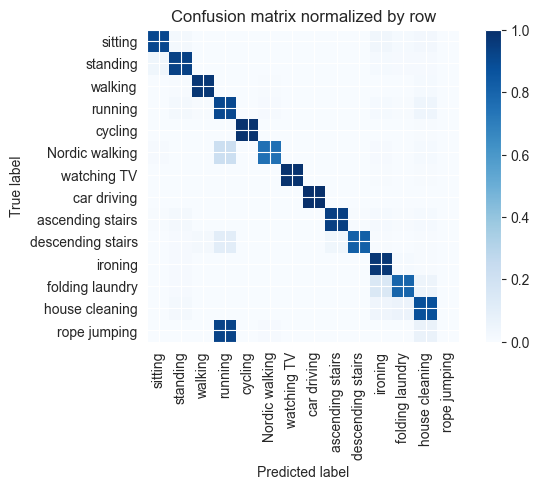

Training Epoch:  67%|██████▋   | 10/15 [05:25<02:43, 32.64s/it]

Overall accuracy: 0.890

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.870      0.971      0.918      0.126        483|	 folding laundry: 0.012,	standing: 0.010,	
          walking       0.989      0.972      0.980      0.120        460|	 house cleaning: 0.013,	Nordic walking: 0.007,	
   Nordic walking       0.976      0.753      0.850      0.099        380|	 running: 0.216,	house cleaning: 0.013,	
   house cleaning       0.850      0.876      0.863      0.094        362|	 folding laundry: 0.058,	ironing: 0.041,	
         standing       0.905      0.930      0.917      0.093        358|	 sitting: 0.036,	ironing: 0.014,	
          sitting       0.942      0.909      0.925      0.089        341|	 ironing: 0.032,	house cleaning: 0.026,	
          cycling       1.000      0.987      0.994      0.083        317|	 house cleaning: 0.006,	ironing: 0.003,	
 ascending stairs       0.967      0.940      0.953      0.056     


train: 100%|██████████| 242/242 [00:28<00:00,  8.55batch/s, loss=4.55, accuracy=0.812]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 17.34batch/s, loss=2.6] 


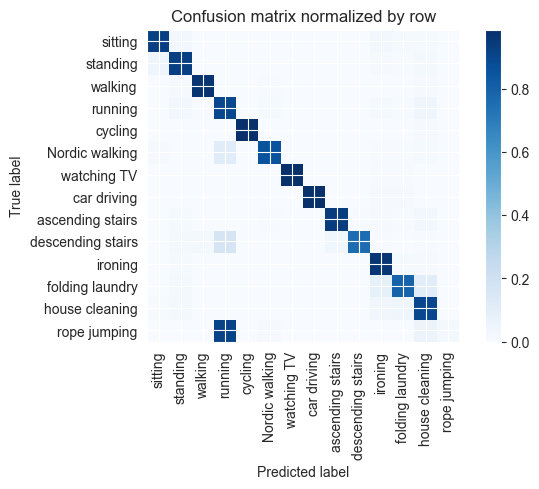

Training Epoch:  73%|███████▎  | 11/15 [05:57<02:10, 32.52s/it]

Overall accuracy: 0.898

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.903      0.961      0.931      0.126        484|	 folding laundry: 0.014,	standing: 0.014,	
          walking       0.991      0.972      0.981      0.119        458|	 house cleaning: 0.011,	standing: 0.009,	
   Nordic walking       0.976      0.854      0.911      0.100        383|	 running: 0.115,	house cleaning: 0.013,	
   house cleaning       0.829      0.898      0.862      0.094        361|	 folding laundry: 0.042,	ironing: 0.033,	
         standing       0.887      0.927      0.906      0.092        355|	 sitting: 0.039,	house cleaning: 0.020,	
          sitting       0.938      0.927      0.933      0.090        344|	 standing: 0.026,	ironing: 0.023,	
          cycling       1.000      0.984      0.992      0.083        319|	 house cleaning: 0.009,	ironing: 0.003,	
 ascending stairs       0.966      0.938      0.952      0.055        21


train: 100%|██████████| 242/242 [00:28<00:00,  8.59batch/s, loss=5.21, accuracy=0.938]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 17.90batch/s, loss=3.79]


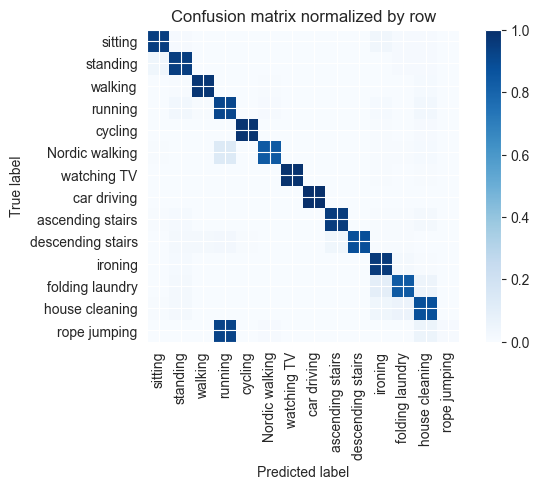

Training Epoch:  80%|████████  | 12/15 [06:29<01:37, 32.36s/it]

Overall accuracy: 0.907

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.896      0.959      0.926      0.126        484|	 folding laundry: 0.019,	standing: 0.014,	
          walking       0.989      0.974      0.981      0.120        460|	 house cleaning: 0.013,	standing: 0.007,	
   Nordic walking       0.985      0.836      0.904      0.100        385|	 running: 0.132,	house cleaning: 0.016,	
   house cleaning       0.865      0.877      0.871      0.093        359|	 folding laundry: 0.058,	ironing: 0.039,	
         standing       0.905      0.943      0.924      0.092        352|	 sitting: 0.037,	house cleaning: 0.009,	
          sitting       0.945      0.942      0.943      0.090        344|	 ironing: 0.032,	house cleaning: 0.009,	
          cycling       0.997      0.984      0.990      0.083        317|	 house cleaning: 0.009,	ironing: 0.006,	
 ascending stairs       0.967      0.953      0.960      0.055    


train: 100%|██████████| 242/242 [00:28<00:00,  8.49batch/s, loss=7, accuracy=0.922]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 16.98batch/s, loss=2.14]


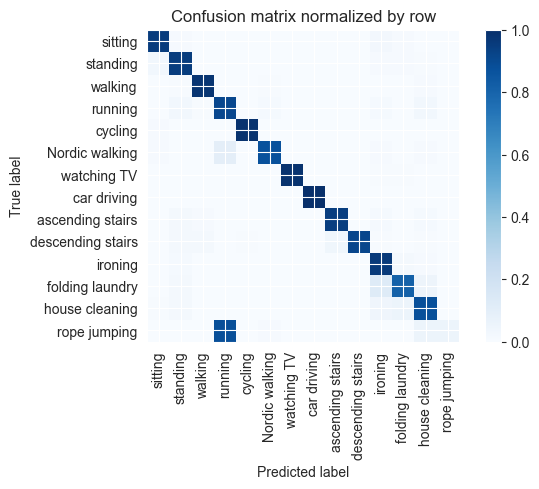

Training Epoch:  87%|████████▋ | 13/15 [07:02<01:04, 32.41s/it]

Overall accuracy: 0.913

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.881      0.958      0.918      0.125        480|	 folding laundry: 0.019,	standing: 0.013,	
          walking       0.985      0.978      0.981      0.120        459|	 house cleaning: 0.011,	Nordic walking: 0.004,	
   Nordic walking       0.982      0.874      0.925      0.099        382|	 running: 0.094,	house cleaning: 0.010,	
   house cleaning       0.885      0.875      0.880      0.094        361|	 folding laundry: 0.053,	ironing: 0.042,	
         standing       0.904      0.947      0.925      0.093        357|	 sitting: 0.028,	ironing: 0.011,	
          sitting       0.945      0.950      0.948      0.089        342|	 ironing: 0.026,	standing: 0.012,	
          cycling       0.994      0.987      0.991      0.083        318|	 sitting: 0.009,	house cleaning: 0.003,	
 ascending stairs       0.967      0.944      0.955      0.056        214


train: 100%|██████████| 242/242 [00:28<00:00,  8.52batch/s, loss=3.54, accuracy=0.938]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 17.60batch/s, loss=4.71]


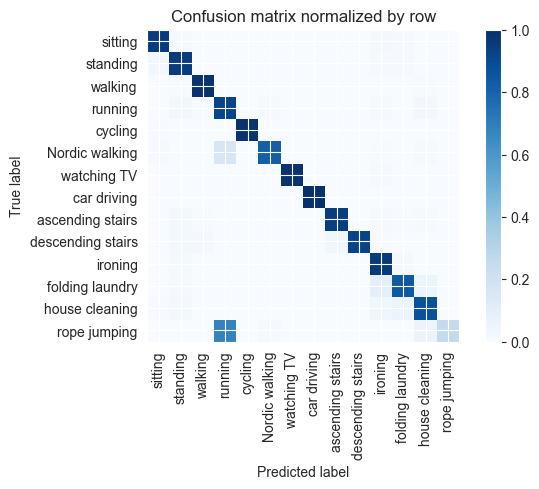

Training Epoch:  93%|█████████▎| 14/15 [07:34<00:32, 32.45s/it]

Overall accuracy: 0.917

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.897      0.964      0.929      0.124        478|	 folding laundry: 0.019,	standing: 0.013,	
          walking       0.987      0.985      0.986      0.120        459|	 standing: 0.007,	house cleaning: 0.004,	
   Nordic walking       0.987      0.813      0.891      0.099        379|	 running: 0.158,	house cleaning: 0.011,	
   house cleaning       0.903      0.871      0.886      0.095        363|	 folding laundry: 0.061,	ironing: 0.039,	
         standing       0.904      0.952      0.927      0.093        356|	 sitting: 0.025,	ironing: 0.011,	
          sitting       0.951      0.956      0.953      0.089        343|	 ironing: 0.023,	folding laundry: 0.009,	
          cycling       0.997      0.987      0.992      0.083        318|	 sitting: 0.006,	house cleaning: 0.003,	
 ascending stairs       0.967      0.949      0.958      0.056        21


train: 100%|██████████| 242/242 [00:29<00:00,  8.27batch/s, loss=4.51, accuracy=0.891]


torch.Size([14, 512])



seen: 100%|██████████| 60/60 [00:03<00:00, 15.48batch/s, loss=2.81]


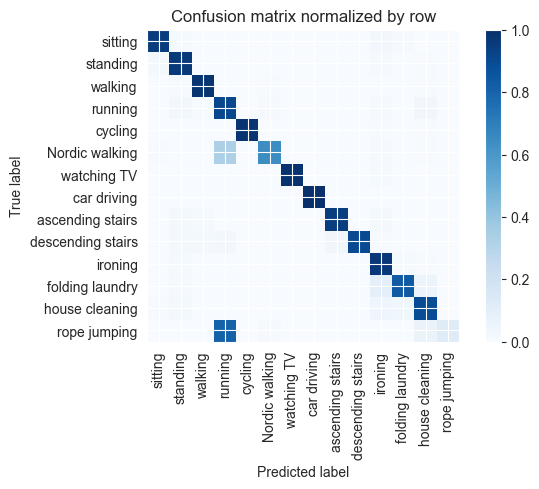

Overall accuracy: 0.896

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

          ironing       0.884      0.967      0.924      0.125        481|	 folding laundry: 0.012,	standing: 0.012,	
          walking       0.983      0.983      0.983      0.120        459|	 standing: 0.007,	house cleaning: 0.004,	
   Nordic walking       0.980      0.642      0.776      0.101        386|	 running: 0.326,	ironing: 0.010,	
   house cleaning       0.897      0.887      0.892      0.094        362|	 ironing: 0.044,	folding laundry: 0.039,	
         standing       0.901      0.958      0.929      0.092        353|	 sitting: 0.023,	ironing: 0.011,	
          sitting       0.959      0.953      0.956      0.089        341|	 ironing: 0.023,	standing: 0.012,	
          cycling       0.997      0.984      0.990      0.083        317|	 house cleaning: 0.006,	ironing: 0.006,	
 ascending stairs       0.971      0.949      0.960      0.056        214|	 ironing: 0

unseen: 100%|██████████| 111/111 [00:06<00:00, 17.86batch/s, loss=3.57]


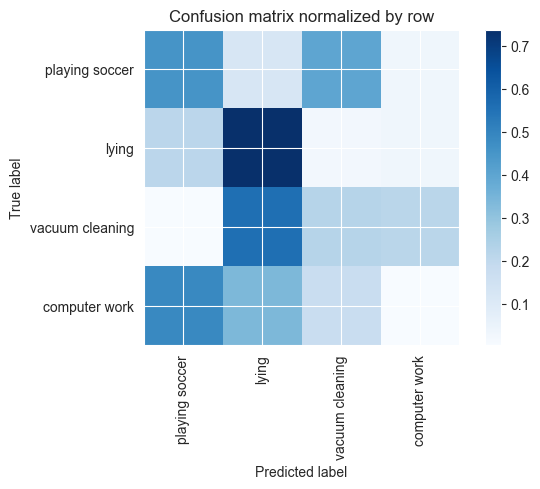

Overall accuracy: 0.279

                  precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

  computer work       0.025      0.004      0.006      0.431       3065|	 playing soccer: 0.486,	lying: 0.337,	vacuum cleaning: 0.173,	
          lying       0.404      0.737      0.522      0.264       1878|	 playing soccer: 0.210,	computer work: 0.030,	
vacuum cleaning       0.335      0.223      0.268      0.240       1704|	 lying: 0.559,	computer work: 0.214,	
 playing soccer       0.099      0.453      0.162      0.064        457|	 vacuum cleaning: 0.396,	lying: 0.120,	

----------------------------------------------------------------------------------------------------
    avg / total       0.204      0.279      0.215        1.0       7104|	      

{'accuracy': 0.27899774774774777, 'precision': 0.21566111832906254, 'recall': 0.3541254641482938, 'f1': 0.23949918834314363}
================ Fold-3 ================
Unseen Classes : ['cycling', 'running', 'Nordic walking

Training Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

torch.Size([15, 512])



train: 100%|██████████| 276/276 [00:32<00:00,  8.62batch/s, loss=7.55, accuracy=0.75]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:03<00:00, 17.42batch/s, loss=7.72]


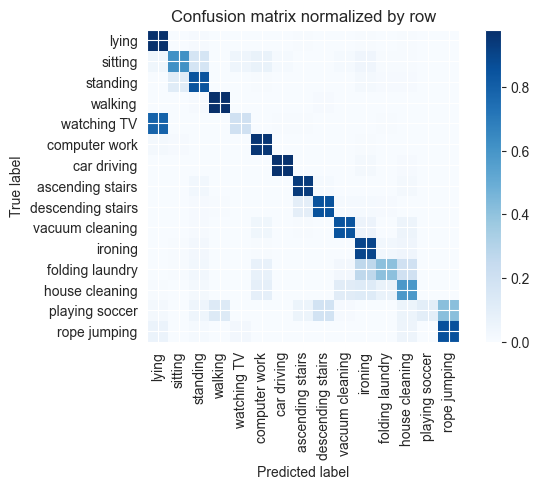

Training Epoch:   7%|▋         | 1/15 [00:36<08:31, 36.50s/it]

Overall accuracy: 0.797

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.860      0.954      0.905      0.128        567|	 lying: 0.023,	sitting: 0.011,	
          walking       0.972      0.980      0.976      0.112        493|	 descending stairs: 0.008,	standing: 0.008,	
          ironing       0.728      0.897      0.804      0.103        456|	 house cleaning: 0.039,	folding laundry: 0.029,	
   house cleaning       0.706      0.582      0.638      0.090        397|	 ironing: 0.121,	vacuum cleaning: 0.111,	
         standing       0.753      0.845      0.797      0.088        387|	 sitting: 0.111,	ironing: 0.021,	
            lying       0.699      0.974      0.814      0.086        379|	 standing: 0.008,	house cleaning: 0.005,	
  vacuum cleaning       0.835      0.844      0.839      0.080        353|	 ironing: 0.054,	house cleaning: 0.048,	
          sitting       0.792      0.613      0.691      0.076        33


train: 100%|██████████| 276/276 [00:32<00:00,  8.48batch/s, loss=6.47, accuracy=0.875]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:03<00:00, 18.07batch/s, loss=4.51]


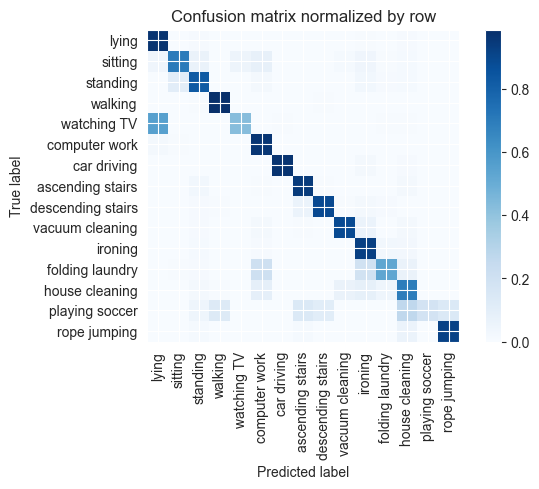

Training Epoch:  13%|█▎        | 2/15 [01:13<07:57, 36.72s/it]

Overall accuracy: 0.839

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.822      0.963      0.887      0.128        567|	 lying: 0.018,	sitting: 0.005,	
          walking       0.970      0.988      0.979      0.111        490|	 descending stairs: 0.004,	standing: 0.004,	
          ironing       0.767      0.925      0.839      0.103        456|	 folding laundry: 0.029,	house cleaning: 0.024,	
   house cleaning       0.768      0.691      0.728      0.090        398|	 computer work: 0.085,	ironing: 0.083,	
         standing       0.842      0.829      0.835      0.087        385|	 sitting: 0.101,	ironing: 0.029,	
            lying       0.767      0.971      0.857      0.086        379|	 house cleaning: 0.011,	standing: 0.008,	
  vacuum cleaning       0.908      0.885      0.896      0.081        356|	 ironing: 0.059,	house cleaning: 0.022,	
          sitting       0.839      0.699      0.763      0.076        336|


train: 100%|██████████| 276/276 [00:32<00:00,  8.56batch/s, loss=8.12, accuracy=0.906]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:03<00:00, 17.51batch/s, loss=6.26]


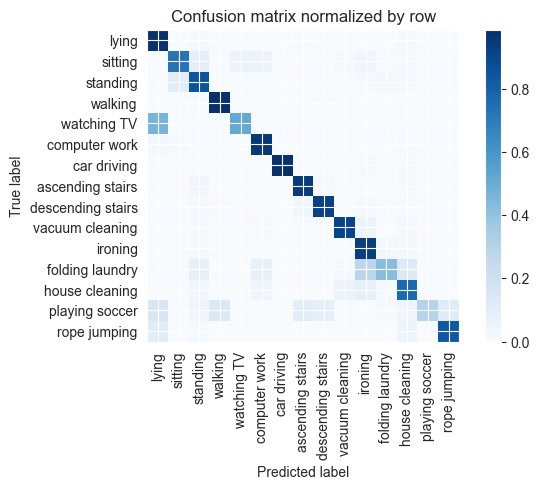

Training Epoch:  20%|██        | 3/15 [01:50<07:21, 36.76s/it]

Overall accuracy: 0.852

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.902      0.953      0.926      0.129        569|	 lying: 0.023,	sitting: 0.011,	
          walking       0.970      0.986      0.978      0.111        492|	 standing: 0.006,	descending stairs: 0.004,	
          ironing       0.760      0.934      0.838      0.103        455|	 folding laundry: 0.024,	house cleaning: 0.022,	
   house cleaning       0.818      0.767      0.792      0.090        399|	 ironing: 0.083,	vacuum cleaning: 0.060,	
         standing       0.787      0.847      0.816      0.087        385|	 sitting: 0.109,	folding laundry: 0.018,	
            lying       0.770      0.974      0.860      0.086        379|	 house cleaning: 0.008,	standing: 0.008,	
  vacuum cleaning       0.910      0.905      0.908      0.081        358|	 ironing: 0.053,	house cleaning: 0.017,	
          sitting       0.822      0.726      0.771      0.076  


train: 100%|██████████| 276/276 [00:32<00:00,  8.43batch/s, loss=5.85, accuracy=0.875]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:03<00:00, 17.40batch/s, loss=4.98]


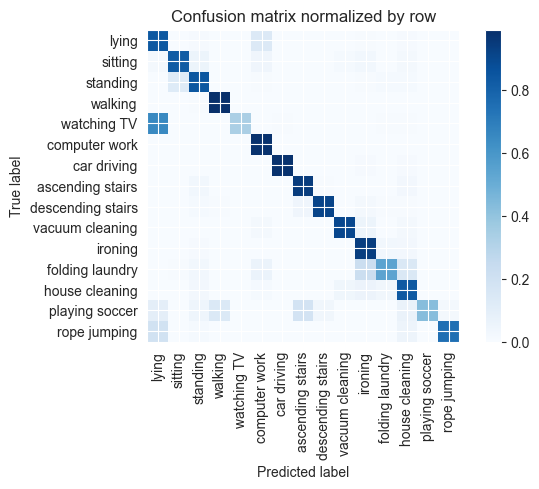

Training Epoch:  27%|██▋       | 4/15 [02:27<06:46, 36.95s/it]

Overall accuracy: 0.856

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.861      0.981      0.917      0.129        568|	 house cleaning: 0.004,	standing: 0.004,	
          walking       0.970      0.990      0.980      0.112        494|	 standing: 0.006,	ironing: 0.002,	
          ironing       0.799      0.934      0.861      0.103        456|	 folding laundry: 0.029,	house cleaning: 0.024,	
   house cleaning       0.800      0.834      0.817      0.090        398|	 ironing: 0.058,	vacuum cleaning: 0.035,	
         standing       0.842      0.842      0.842      0.087        386|	 sitting: 0.122,	house cleaning: 0.013,	
            lying       0.700      0.839      0.764      0.086        379|	 computer work: 0.135,	house cleaning: 0.008,	
  vacuum cleaning       0.947      0.899      0.922      0.080        355|	 ironing: 0.054,	house cleaning: 0.023,	
          sitting       0.838      0.823      0.831      0.0


train: 100%|██████████| 276/276 [00:33<00:00,  8.34batch/s, loss=5.39, accuracy=0.844]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:03<00:00, 17.41batch/s, loss=4.9] 


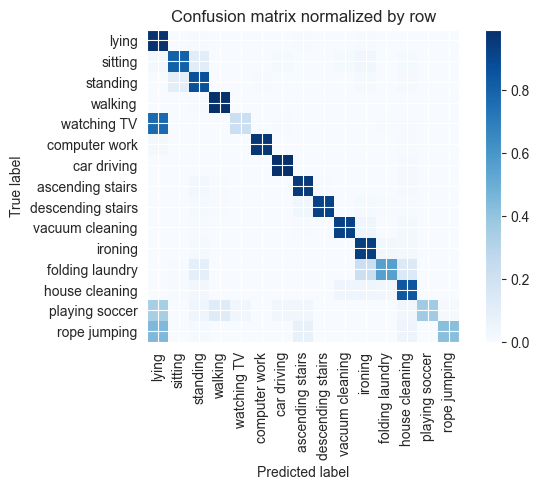

Training Epoch:  33%|███▎      | 5/15 [03:04<06:11, 37.16s/it]

Overall accuracy: 0.861

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.963      0.978      0.128        565|	 lying: 0.018,	house cleaning: 0.007,	
          walking       0.972      0.992      0.982      0.111        491|	 standing: 0.004,	ironing: 0.002,	
          ironing       0.813      0.939      0.871      0.104        458|	 folding laundry: 0.028,	house cleaning: 0.017,	
   house cleaning       0.832      0.842      0.837      0.090        399|	 vacuum cleaning: 0.045,	ironing: 0.043,	
         standing       0.787      0.870      0.827      0.087        386|	 sitting: 0.098,	ironing: 0.013,	
            lying       0.642      0.979      0.775      0.086        379|	 ironing: 0.005,	ascending stairs: 0.005,	
  vacuum cleaning       0.932      0.924      0.928      0.081        357|	 ironing: 0.045,	house cleaning: 0.020,	
          sitting       0.859      0.803      0.830      0.076        335|


train: 100%|██████████| 276/276 [00:32<00:00,  8.37batch/s, loss=5.6, accuracy=0.891]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:03<00:00, 17.25batch/s, loss=5.74]


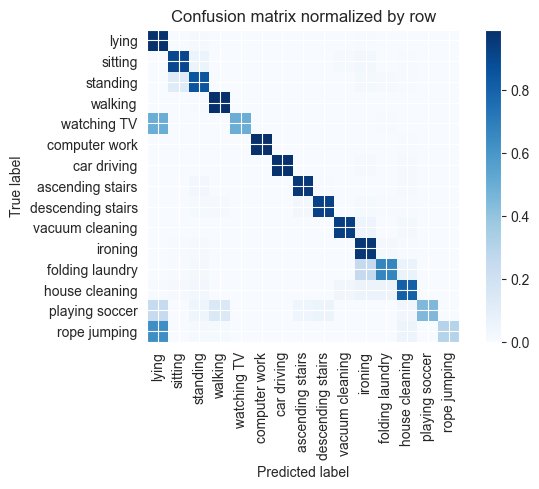

Training Epoch:  40%|████      | 6/15 [03:42<05:35, 37.26s/it]

Overall accuracy: 0.883

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.996      0.986      0.991      0.128        567|	 house cleaning: 0.005,	standing: 0.004,	
          walking       0.966      0.990      0.978      0.111        492|	 standing: 0.006,	ironing: 0.002,	
          ironing       0.797      0.961      0.871      0.103        457|	 folding laundry: 0.018,	standing: 0.011,	
   house cleaning       0.890      0.807      0.846      0.090        399|	 folding laundry: 0.058,	ironing: 0.058,	
         standing       0.842      0.850      0.846      0.086        381|	 sitting: 0.118,	ironing: 0.016,	
            lying       0.703      0.979      0.818      0.086        380|	 standing: 0.011,	ironing: 0.005,	
  vacuum cleaning       0.946      0.930      0.938      0.081        357|	 ironing: 0.048,	house cleaning: 0.017,	
          sitting       0.847      0.898      0.872      0.076        334|	 standing:


train: 100%|██████████| 276/276 [00:32<00:00,  8.41batch/s, loss=4.68, accuracy=0.828]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:03<00:00, 17.37batch/s, loss=5.15]


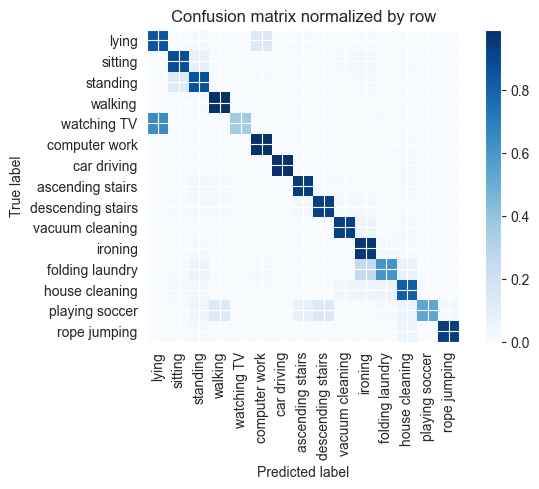

Training Epoch:  47%|████▋     | 7/15 [04:19<04:58, 37.27s/it]

Overall accuracy: 0.877

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.909      0.986      0.946      0.129        568|	 house cleaning: 0.005,	sitting: 0.004,	
          walking       0.966      0.990      0.978      0.111        492|	 standing: 0.006,	ironing: 0.002,	
          ironing       0.799      0.965      0.874      0.102        452|	 folding laundry: 0.015,	standing: 0.009,	
   house cleaning       0.887      0.812      0.848      0.090        398|	 folding laundry: 0.055,	ironing: 0.048,	
         standing       0.825      0.860      0.842      0.087        385|	 sitting: 0.122,	ironing: 0.010,	
            lying       0.759      0.847      0.800      0.086        379|	 computer work: 0.129,	standing: 0.008,	
  vacuum cleaning       0.933      0.930      0.931      0.081        358|	 ironing: 0.053,	house cleaning: 0.014,	
          sitting       0.833      0.878      0.855      0.076        335|	 stan


train: 100%|██████████| 276/276 [00:33<00:00,  8.28batch/s, loss=5, accuracy=0.906]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:03<00:00, 17.42batch/s, loss=4.99]


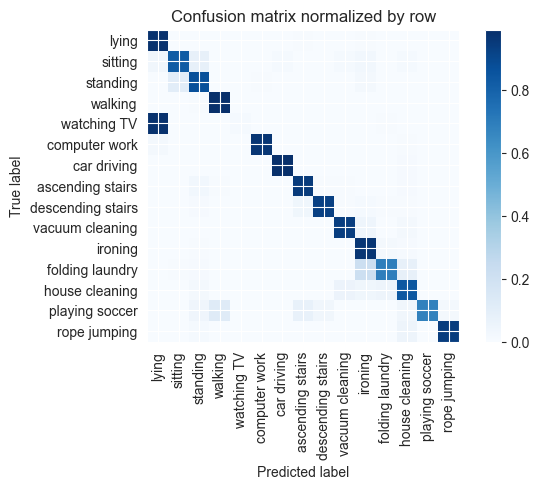

Training Epoch:  53%|█████▎    | 8/15 [04:57<04:22, 37.46s/it]

Overall accuracy: 0.881

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.966      0.980      0.128        564|	 lying: 0.021,	house cleaning: 0.005,	
          walking       0.976      0.990      0.983      0.112        493|	 standing: 0.006,	ironing: 0.002,	
          ironing       0.821      0.965      0.887      0.103        456|	 folding laundry: 0.018,	house cleaning: 0.009,	
   house cleaning       0.876      0.836      0.856      0.090        397|	 vacuum cleaning: 0.055,	folding laundry: 0.048,	
         standing       0.848      0.868      0.858      0.088        387|	 sitting: 0.101,	ironing: 0.018,	
            lying       0.677      0.982      0.801      0.086        380|	 ironing: 0.005,	ascending stairs: 0.005,	
  vacuum cleaning       0.915      0.933      0.924      0.081        356|	 ironing: 0.045,	house cleaning: 0.020,	
          sitting       0.865      0.821      0.843      0.076    


train: 100%|██████████| 276/276 [00:32<00:00,  8.38batch/s, loss=4.81, accuracy=0.891]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:03<00:00, 17.38batch/s, loss=3.94]


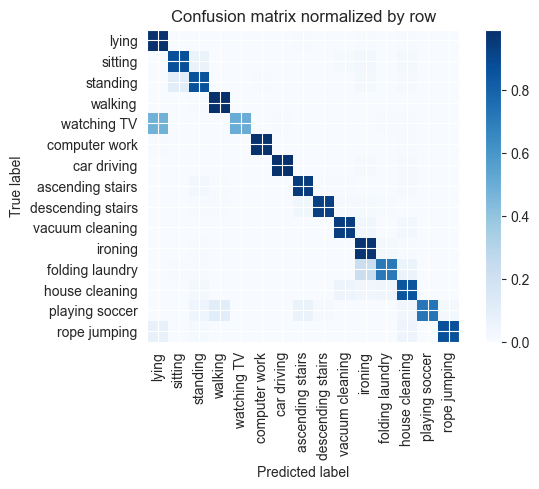

Training Epoch:  60%|██████    | 9/15 [05:34<03:44, 37.43s/it]

Overall accuracy: 0.905

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.981      0.988      0.128        566|	 lying: 0.007,	house cleaning: 0.005,	
          walking       0.974      0.990      0.982      0.112        493|	 standing: 0.006,	folding laundry: 0.002,	
          ironing       0.826      0.969      0.892      0.103        457|	 folding laundry: 0.020,	house cleaning: 0.004,	
   house cleaning       0.873      0.849      0.861      0.090        398|	 vacuum cleaning: 0.048,	folding laundry: 0.045,	
         standing       0.864      0.859      0.862      0.087        384|	 sitting: 0.107,	ironing: 0.016,	
            lying       0.813      0.982      0.889      0.086        380|	 house cleaning: 0.005,	ironing: 0.005,	
  vacuum cleaning       0.918      0.933      0.925      0.081        358|	 ironing: 0.036,	house cleaning: 0.028,	
          sitting       0.872      0.872      0.872      0.0


train: 100%|██████████| 276/276 [00:32<00:00,  8.45batch/s, loss=4.14, accuracy=0.922]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:04<00:00, 16.87batch/s, loss=2.63]


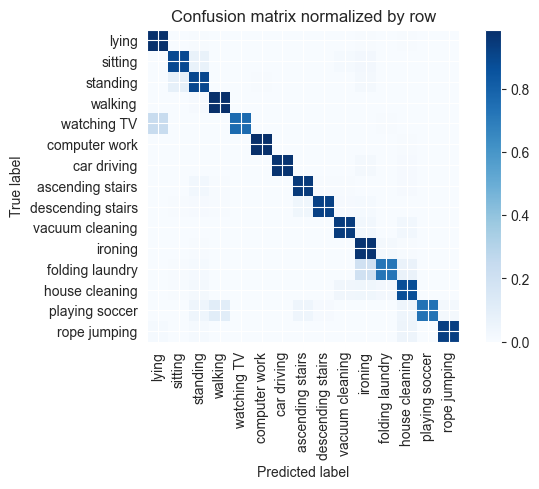

Training Epoch:  67%|██████▋   | 10/15 [06:12<03:06, 37.37s/it]

Overall accuracy: 0.923

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.988      0.991      0.128        567|	 house cleaning: 0.005,	standing: 0.004,	
          walking       0.974      0.988      0.981      0.111        490|	 standing: 0.008,	ironing: 0.002,	
          ironing       0.837      0.969      0.899      0.103        457|	 folding laundry: 0.018,	house cleaning: 0.007,	
   house cleaning       0.889      0.873      0.881      0.089        395|	 ironing: 0.035,	vacuum cleaning: 0.033,	
         standing       0.855      0.897      0.875      0.088        387|	 sitting: 0.083,	ironing: 0.016,	
            lying       0.907      0.981      0.943      0.085        377|	 house cleaning: 0.005,	ironing: 0.005,	
  vacuum cleaning       0.941      0.939      0.940      0.081        358|	 ironing: 0.031,	house cleaning: 0.028,	
          sitting       0.885      0.890      0.887      0.076        336


train: 100%|██████████| 276/276 [00:32<00:00,  8.43batch/s, loss=4.3, accuracy=0.906]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:04<00:00, 16.89batch/s, loss=3.63]


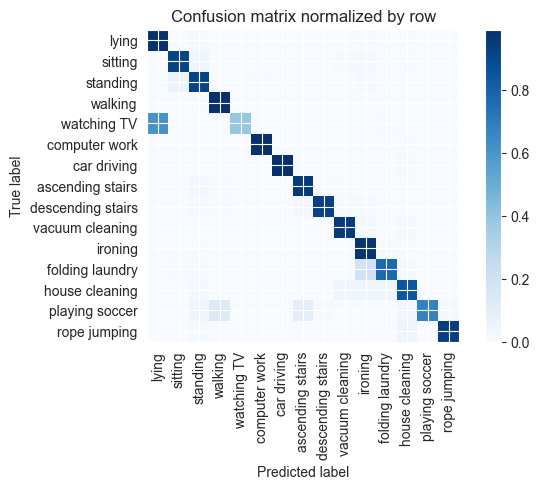

Training Epoch:  73%|███████▎  | 11/15 [06:49<02:29, 37.36s/it]

Overall accuracy: 0.915

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.988      0.991      0.128        567|	 house cleaning: 0.007,	vacuum cleaning: 0.002,	
          walking       0.970      0.990      0.980      0.112        493|	 standing: 0.006,	folding laundry: 0.002,	
          ironing       0.842      0.971      0.902      0.103        454|	 folding laundry: 0.015,	standing: 0.007,	
   house cleaning       0.918      0.847      0.881      0.090        398|	 vacuum cleaning: 0.043,	folding laundry: 0.040,	
         standing       0.874      0.915      0.894      0.087        386|	 sitting: 0.062,	ironing: 0.013,	
            lying       0.793      0.981      0.877      0.086        378|	 standing: 0.008,	house cleaning: 0.005,	
  vacuum cleaning       0.929      0.950      0.939      0.081        358|	 ironing: 0.031,	house cleaning: 0.017,	
          sitting       0.919      0.913      0.916    


train: 100%|██████████| 276/276 [00:32<00:00,  8.46batch/s, loss=4.32, accuracy=0.922]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:04<00:00, 16.27batch/s, loss=5.03]


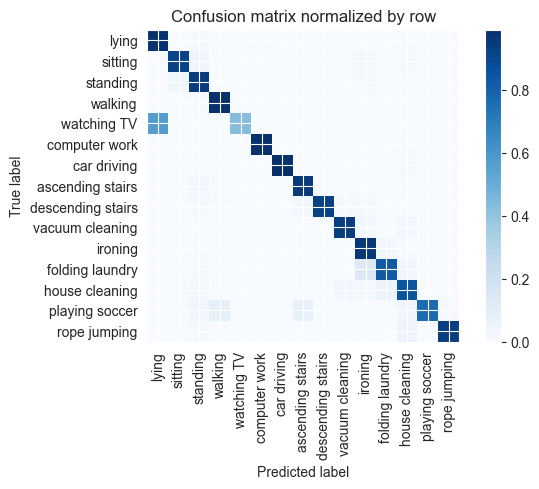

Training Epoch:  80%|████████  | 12/15 [07:27<01:52, 37.45s/it]

Overall accuracy: 0.922

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.989      0.989      0.989      0.129        568|	 house cleaning: 0.005,	vacuum cleaning: 0.002,	
          walking       0.978      0.992      0.985      0.112        493|	 standing: 0.004,	folding laundry: 0.002,	
          ironing       0.882      0.963      0.920      0.103        456|	 folding laundry: 0.029,	house cleaning: 0.004,	
   house cleaning       0.897      0.854      0.875      0.090        397|	 folding laundry: 0.058,	vacuum cleaning: 0.030,	
         standing       0.888      0.943      0.915      0.087        386|	 sitting: 0.036,	ironing: 0.010,	
            lying       0.804      0.979      0.883      0.085        377|	 standing: 0.008,	house cleaning: 0.005,	
  vacuum cleaning       0.946      0.938      0.942      0.081        357|	 house cleaning: 0.031,	ironing: 0.028,	
          sitting       0.944      0.916      0.9


train: 100%|██████████| 276/276 [00:32<00:00,  8.55batch/s, loss=5.09, accuracy=0.844]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:04<00:00, 16.90batch/s, loss=2.84]


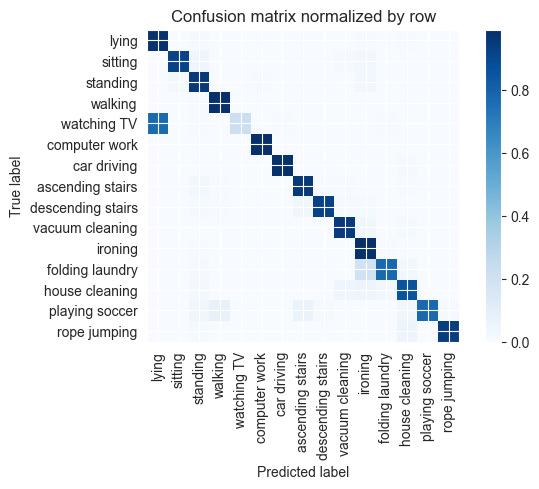

Training Epoch:  87%|████████▋ | 13/15 [08:04<01:14, 37.28s/it]

Overall accuracy: 0.915

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.989      0.992      0.128        567|	 house cleaning: 0.004,	sitting: 0.004,	
          walking       0.980      0.990      0.985      0.112        493|	 standing: 0.006,	folding laundry: 0.002,	
          ironing       0.826      0.989      0.900      0.103        455|	 folding laundry: 0.007,	standing: 0.004,	
   house cleaning       0.929      0.852      0.889      0.090        399|	 ironing: 0.050,	vacuum cleaning: 0.043,	
         standing       0.884      0.948      0.915      0.087        386|	 ironing: 0.023,	sitting: 0.018,	
            lying       0.751      0.979      0.850      0.086        378|	 standing: 0.008,	house cleaning: 0.005,	
  vacuum cleaning       0.931      0.946      0.939      0.080        355|	 ironing: 0.037,	house cleaning: 0.014,	
          sitting       0.972      0.914      0.942      0.076        3


train: 100%|██████████| 276/276 [00:33<00:00,  8.35batch/s, loss=3.83, accuracy=0.938]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:04<00:00, 17.21batch/s, loss=3.02]


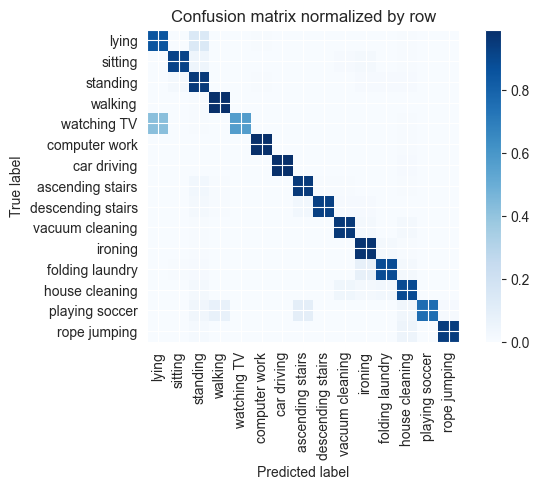

Training Epoch:  93%|█████████▎| 14/15 [08:41<00:37, 37.40s/it]

Overall accuracy: 0.924

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.991      0.989      0.990      0.129        568|	 house cleaning: 0.005,	vacuum cleaning: 0.002,	
          walking       0.980      0.990      0.985      0.111        490|	 standing: 0.006,	folding laundry: 0.002,	
          ironing       0.912      0.971      0.941      0.103        456|	 folding laundry: 0.020,	house cleaning: 0.004,	
   house cleaning       0.912      0.887      0.900      0.090        399|	 vacuum cleaning: 0.038,	folding laundry: 0.030,	
         standing       0.785      0.951      0.860      0.087        385|	 sitting: 0.021,	house cleaning: 0.008,	
            lying       0.827      0.849      0.838      0.085        377|	 standing: 0.138,	house cleaning: 0.005,	
  vacuum cleaning       0.940      0.955      0.947      0.081        358|	 house cleaning: 0.022,	ironing: 0.017,	
          sitting       0.968      0.916  


train: 100%|██████████| 276/276 [00:32<00:00,  8.37batch/s, loss=3.85, accuracy=0.922]


torch.Size([15, 512])



seen: 100%|██████████| 69/69 [00:04<00:00, 16.83batch/s, loss=1.99]


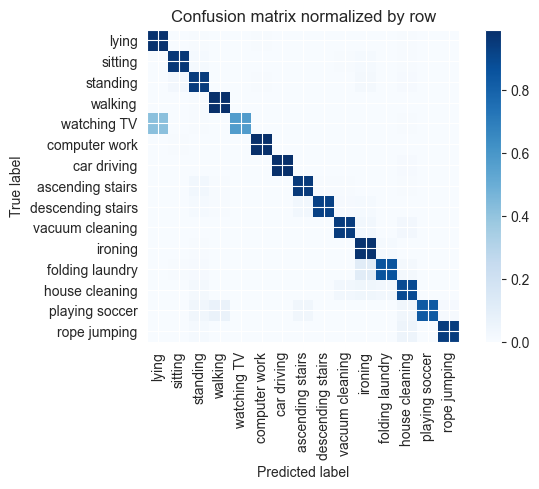

Overall accuracy: 0.939

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.993      0.991      0.992      0.129        568|	 sitting: 0.005,	house cleaning: 0.004,	
          walking       0.984      0.990      0.987      0.111        492|	 standing: 0.006,	folding laundry: 0.002,	
          ironing       0.882      0.978      0.927      0.103        457|	 folding laundry: 0.015,	standing: 0.004,	
   house cleaning       0.914      0.889      0.901      0.090        396|	 ironing: 0.035,	folding laundry: 0.028,	
         standing       0.908      0.943      0.925      0.088        387|	 sitting: 0.026,	ironing: 0.016,	
            lying       0.850      0.982      0.911      0.086        380|	 house cleaning: 0.005,	computer work: 0.005,	
  vacuum cleaning       0.952      0.944      0.948      0.080        354|	 ironing: 0.028,	house cleaning: 0.025,	
          sitting       0.958      0.958      0.958      0.076    

unseen: 100%|██████████| 68/68 [00:04<00:00, 16.46batch/s, loss=3.9] 


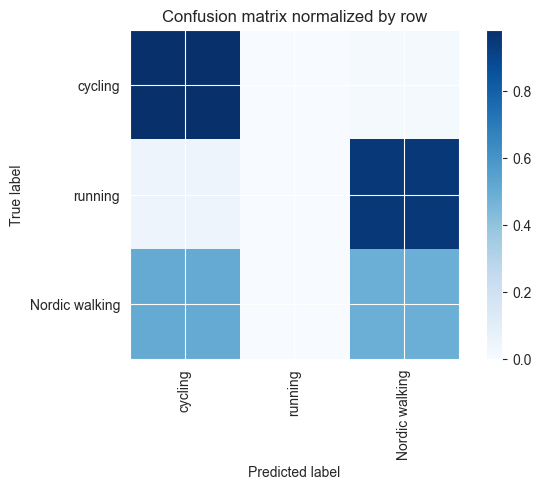

Overall accuracy: 0.565

                 precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

Nordic walking       0.495      0.490      0.493      0.420       1829|	 cycling: 0.510,	running: 0.000,	
       cycling       0.615      0.984      0.757      0.365       1588|	 Nordic walking: 0.014,	running: 0.002,	
       running       0.000      0.000      0.000      0.215        935|	 Nordic walking: 0.952,	cycling: 0.048,	

----------------------------------------------------------------------------------------------------
   avg / total       0.433      0.565      0.483        1.0       4352|	      

{'accuracy': 0.5647977941176471, 'precision': 0.3700873004473115, 'recall': 0.4911707957301412, 'f1': 0.41645376182784927}
================ Fold-4 ================
Unseen Classes : ['ironing', 'car driving', 'folding laundry']
per class count :  {'lying': 8, 'sitting': 8, 'standing': 8, 'walking': 8, 'running': 6, 'cycling': 7, 'Nordic walking': 7, 'watching TV': 1, 'c

Training Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

torch.Size([15, 512])



train: 100%|██████████| 283/283 [00:33<00:00,  8.51batch/s, loss=7.18, accuracy=0.797]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:03<00:00, 17.57batch/s, loss=6.31]


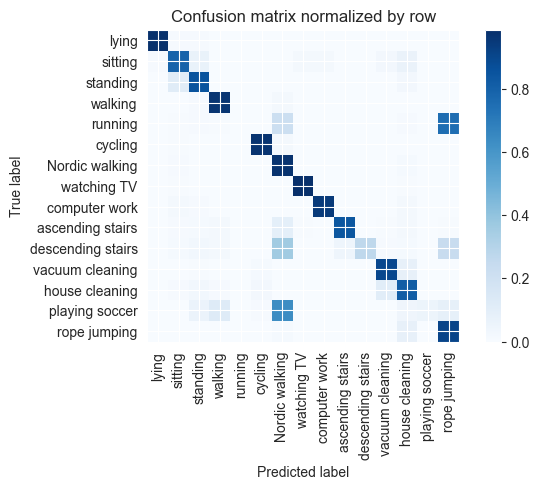

Training Epoch:   7%|▋         | 1/15 [00:37<08:48, 37.78s/it]

Overall accuracy: 0.826

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.988      0.946      0.966      0.133        594|	 sitting: 0.022,	house cleaning: 0.019,	
          walking       0.945      0.966      0.955      0.099        442|	 Nordic walking: 0.020,	standing: 0.011,	
         standing       0.830      0.854      0.842      0.085        383|	 sitting: 0.115,	house cleaning: 0.026,	
            lying       0.992      0.981      0.987      0.084        377|	 standing: 0.008,	sitting: 0.008,	
   house cleaning       0.759      0.816      0.786      0.083        374|	 vacuum cleaning: 0.107,	standing: 0.029,	
   Nordic walking       0.624      0.975      0.761      0.081        362|	 house cleaning: 0.014,	sitting: 0.011,	
          sitting       0.784      0.793      0.788      0.080        357|	 standing: 0.067,	house cleaning: 0.064,	
  vacuum cleaning       0.846      0.897      0.871      0.074        33


train: 100%|██████████| 283/283 [00:34<00:00,  8.32batch/s, loss=5.62, accuracy=0.875]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:03<00:00, 17.63batch/s, loss=4.6]


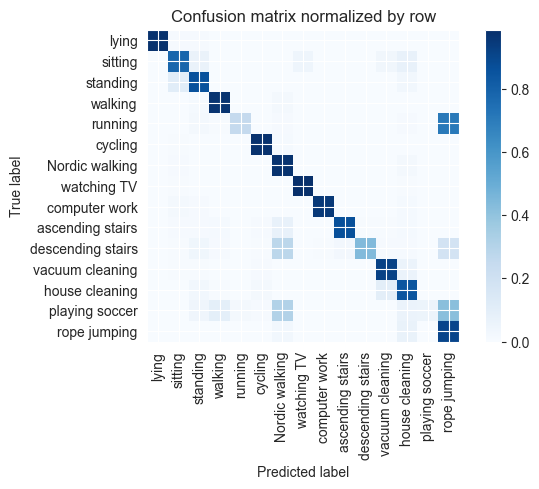

Training Epoch:  13%|█▎        | 2/15 [01:16<08:16, 38.20s/it]

Overall accuracy: 0.850

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.998      0.951      0.974      0.132        592|	 sitting: 0.020,	house cleaning: 0.015,	
          walking       0.962      0.969      0.965      0.099        445|	 Nordic walking: 0.016,	standing: 0.013,	
         standing       0.830      0.861      0.845      0.085        380|	 sitting: 0.108,	house cleaning: 0.029,	
            lying       1.000      0.979      0.989      0.084        375|	 standing: 0.011,	sitting: 0.008,	
   house cleaning       0.772      0.845      0.807      0.083        373|	 vacuum cleaning: 0.097,	standing: 0.029,	
   Nordic walking       0.751      0.975      0.849      0.081        365|	 house cleaning: 0.016,	sitting: 0.008,	
          sitting       0.802      0.781      0.791      0.079        352|	 house cleaning: 0.074,	standing: 0.065,	
  vacuum cleaning       0.855      0.916      0.884      0.075        33


train: 100%|██████████| 283/283 [00:34<00:00,  8.10batch/s, loss=6.87, accuracy=0.766]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:04<00:00, 14.99batch/s, loss=5.22]


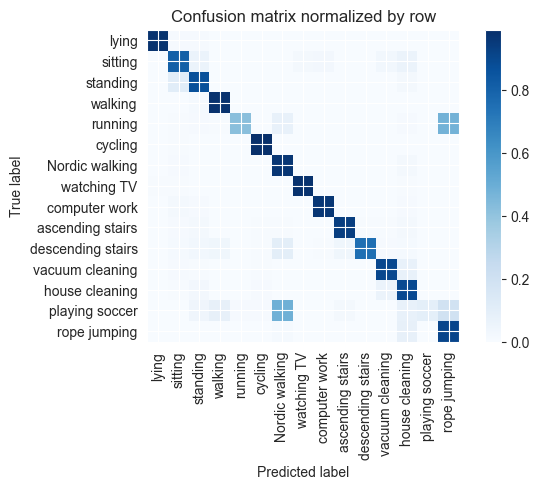

Training Epoch:  20%|██        | 3/15 [01:56<07:48, 39.06s/it]

Overall accuracy: 0.883

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.981      0.960      0.970      0.133        597|	 sitting: 0.018,	house cleaning: 0.008,	
          walking       0.960      0.980      0.970      0.100        446|	 standing: 0.013,	house cleaning: 0.002,	
         standing       0.837      0.867      0.852      0.086        384|	 sitting: 0.107,	house cleaning: 0.021,	
            lying       0.997      0.979      0.988      0.083        373|	 standing: 0.011,	sitting: 0.008,	
   house cleaning       0.779      0.892      0.832      0.083        371|	 vacuum cleaning: 0.059,	standing: 0.027,	
   Nordic walking       0.804      0.964      0.877      0.081        361|	 house cleaning: 0.022,	sitting: 0.011,	
          sitting       0.798      0.807      0.803      0.080        358|	 house cleaning: 0.061,	standing: 0.061,	
  vacuum cleaning       0.889      0.900      0.895      0.074        33


train: 100%|██████████| 283/283 [00:33<00:00,  8.54batch/s, loss=5.02, accuracy=0.875]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:04<00:00, 15.98batch/s, loss=5.26]


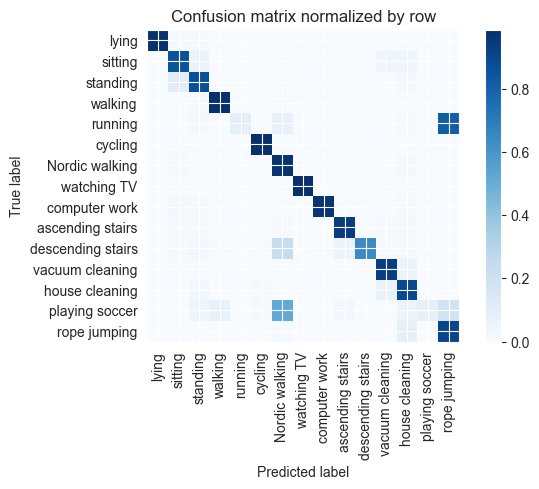

Training Epoch:  27%|██▋       | 4/15 [02:34<07:05, 38.70s/it]

Overall accuracy: 0.873

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.998      0.961      0.979      0.133        595|	 sitting: 0.017,	house cleaning: 0.008,	
          walking       0.980      0.982      0.981      0.099        444|	 standing: 0.011,	Nordic walking: 0.005,	
         standing       0.843      0.871      0.857      0.085        381|	 sitting: 0.108,	house cleaning: 0.018,	
            lying       1.000      0.976      0.988      0.084        378|	 standing: 0.011,	sitting: 0.008,	
   house cleaning       0.816      0.894      0.853      0.084        376|	 vacuum cleaning: 0.066,	standing: 0.024,	
   Nordic walking       0.755      0.973      0.850      0.081        364|	 house cleaning: 0.019,	sitting: 0.008,	
          sitting       0.820      0.854      0.837      0.080        357|	 standing: 0.062,	house cleaning: 0.039,	
  vacuum cleaning       0.873      0.931      0.901      0.074        33


train: 100%|██████████| 283/283 [00:34<00:00,  8.25batch/s, loss=4.72, accuracy=0.922]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:04<00:00, 17.04batch/s, loss=5.06]


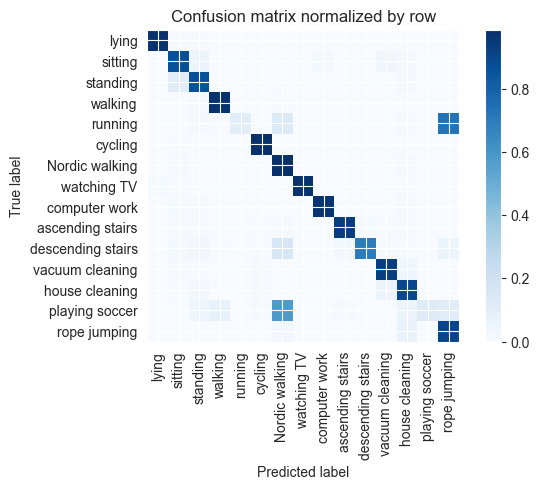

Training Epoch:  33%|███▎      | 5/15 [03:13<06:27, 38.78s/it]

Overall accuracy: 0.878

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.988      0.965      0.976      0.133        597|	 sitting: 0.012,	house cleaning: 0.010,	
          walking       0.980      0.977      0.979      0.099        443|	 standing: 0.011,	Nordic walking: 0.005,	
         standing       0.847      0.867      0.857      0.086        384|	 sitting: 0.112,	house cleaning: 0.018,	
            lying       0.995      0.979      0.987      0.085        379|	 standing: 0.011,	sitting: 0.008,	
   house cleaning       0.859      0.896      0.877      0.083        374|	 vacuum cleaning: 0.056,	standing: 0.027,	
   Nordic walking       0.749      0.981      0.850      0.081        363|	 sitting: 0.011,	house cleaning: 0.008,	
          sitting       0.817      0.869      0.842      0.080        359|	 standing: 0.053,	vacuum cleaning: 0.033,	
  vacuum cleaning       0.884      0.933      0.908      0.073        3


train: 100%|██████████| 283/283 [00:34<00:00,  8.18batch/s, loss=4.59, accuracy=0.828]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:04<00:00, 17.32batch/s, loss=5.62]


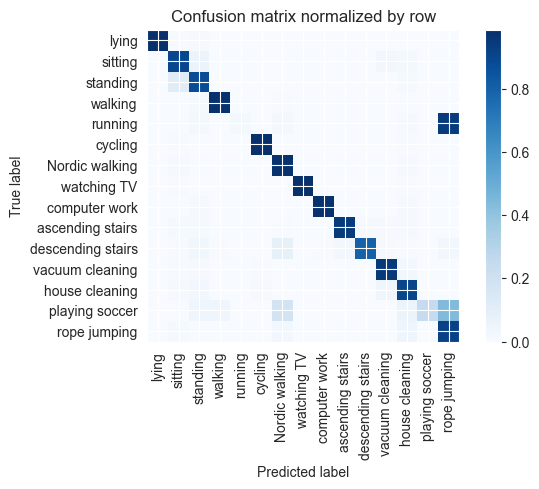

Training Epoch:  40%|████      | 6/15 [03:52<05:50, 38.90s/it]

Overall accuracy: 0.888

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.998      0.978      0.988      0.132        592|	 house cleaning: 0.008,	standing: 0.008,	
          walking       0.986      0.978      0.982      0.099        445|	 standing: 0.013,	Nordic walking: 0.004,	
         standing       0.839      0.876      0.857      0.086        386|	 sitting: 0.109,	house cleaning: 0.013,	
            lying       1.000      0.982      0.991      0.085        379|	 standing: 0.011,	sitting: 0.005,	
   house cleaning       0.881      0.902      0.891      0.084        376|	 vacuum cleaning: 0.045,	standing: 0.027,	
   Nordic walking       0.892      0.975      0.932      0.081        365|	 house cleaning: 0.011,	sitting: 0.011,	
          sitting       0.839      0.894      0.866      0.080        360|	 standing: 0.056,	vacuum cleaning: 0.031,	
  vacuum cleaning       0.893      0.945      0.919      0.073        


train: 100%|██████████| 283/283 [00:33<00:00,  8.34batch/s, loss=5.84, accuracy=0.953]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:03<00:00, 17.58batch/s, loss=3.45]


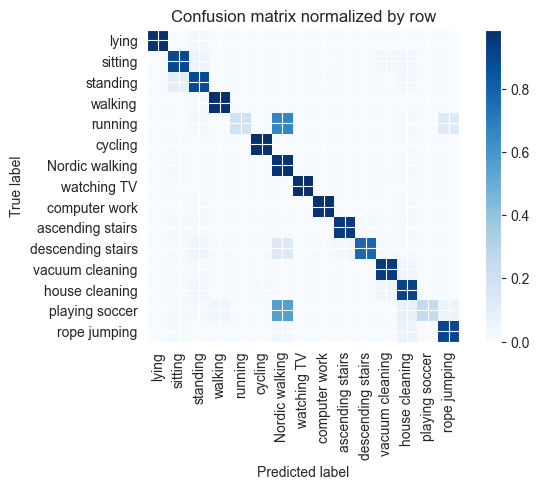

Training Epoch:  47%|████▋     | 7/15 [04:31<05:09, 38.75s/it]

Overall accuracy: 0.895

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.993      0.978      0.986      0.132        591|	 house cleaning: 0.008,	standing: 0.008,	
          walking       0.986      0.982      0.984      0.099        445|	 standing: 0.013,	descending stairs: 0.002,	
         standing       0.846      0.882      0.864      0.085        381|	 sitting: 0.094,	house cleaning: 0.016,	
            lying       1.000      0.979      0.989      0.084        378|	 standing: 0.016,	cycling: 0.003,	
   house cleaning       0.855      0.912      0.883      0.084        375|	 vacuum cleaning: 0.043,	standing: 0.024,	
   Nordic walking       0.626      0.975      0.762      0.080        360|	 house cleaning: 0.014,	sitting: 0.008,	
          sitting       0.860      0.894      0.877      0.080        358|	 standing: 0.047,	vacuum cleaning: 0.028,	
  vacuum cleaning       0.910      0.943      0.926      0.074     


train: 100%|██████████| 283/283 [00:34<00:00,  8.14batch/s, loss=4.33, accuracy=0.844]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:04<00:00, 17.22batch/s, loss=3.25]


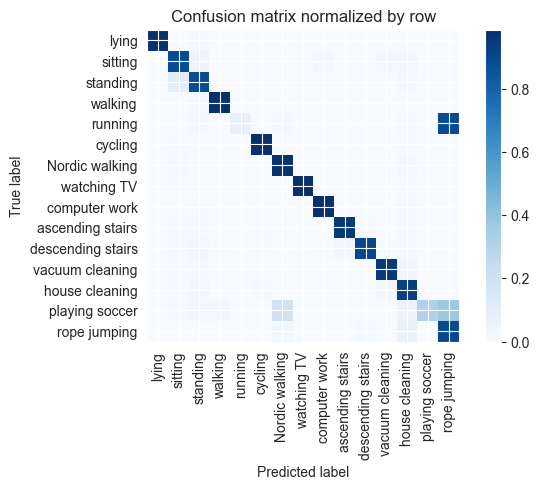

Training Epoch:  53%|█████▎    | 8/15 [05:10<04:32, 38.92s/it]

Overall accuracy: 0.898

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.983      0.981      0.982      0.132        591|	 house cleaning: 0.008,	standing: 0.007,	
          walking       0.989      0.982      0.985      0.100        448|	 standing: 0.013,	house cleaning: 0.002,	
         standing       0.851      0.875      0.863      0.086        385|	 sitting: 0.099,	house cleaning: 0.018,	
            lying       1.000      0.979      0.989      0.084        376|	 standing: 0.013,	computer work: 0.003,	
   house cleaning       0.853      0.928      0.889      0.084        375|	 vacuum cleaning: 0.029,	standing: 0.027,	
   Nordic walking       0.931      0.975      0.953      0.081        362|	 house cleaning: 0.017,	sitting: 0.008,	
          sitting       0.852      0.880      0.866      0.080        359|	 standing: 0.047,	vacuum cleaning: 0.028,	
  vacuum cleaning       0.931      0.948      0.939      0.073  


train: 100%|██████████| 283/283 [00:34<00:00,  8.28batch/s, loss=4.76, accuracy=0.812]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:04<00:00, 17.23batch/s, loss=3.28]


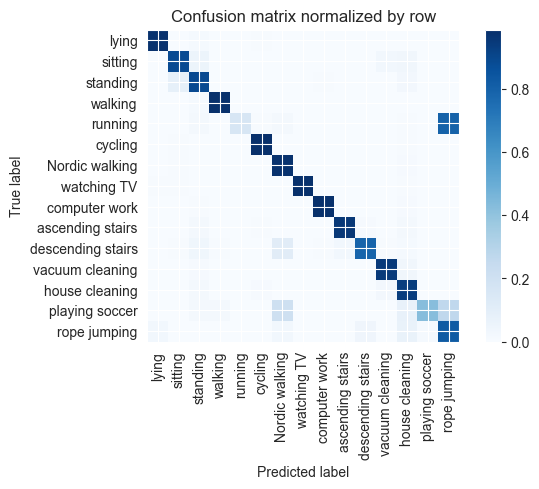

Training Epoch:  60%|██████    | 9/15 [05:49<03:53, 38.88s/it]

Overall accuracy: 0.901

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.983      0.989      0.131        589|	 house cleaning: 0.008,	standing: 0.007,	
          walking       0.991      0.982      0.987      0.100        449|	 standing: 0.013,	house cleaning: 0.002,	
         standing       0.848      0.890      0.868      0.085        381|	 sitting: 0.081,	house cleaning: 0.024,	
            lying       0.992      0.979      0.985      0.085        379|	 standing: 0.013,	cycling: 0.005,	
   house cleaning       0.845      0.936      0.888      0.083        373|	 vacuum cleaning: 0.024,	standing: 0.021,	
   Nordic walking       0.880      0.978      0.926      0.082        367|	 house cleaning: 0.011,	sitting: 0.005,	
          sitting       0.887      0.887      0.887      0.079        353|	 standing: 0.051,	house cleaning: 0.031,	
  vacuum cleaning       0.939      0.948      0.943      0.073        3


train: 100%|██████████| 283/283 [00:34<00:00,  8.15batch/s, loss=6.68, accuracy=0.922]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:03<00:00, 17.67batch/s, loss=3.19]


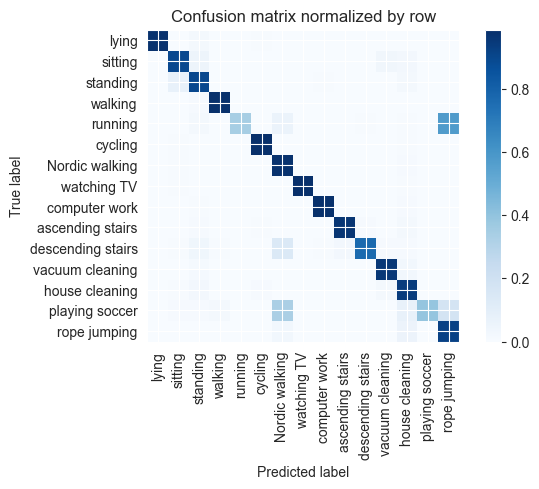

Training Epoch:  67%|██████▋   | 10/15 [06:28<03:15, 39.02s/it]

Overall accuracy: 0.910

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.981      0.988      0.132        591|	 house cleaning: 0.010,	standing: 0.005,	
          walking       0.991      0.982      0.986      0.099        445|	 standing: 0.011,	house cleaning: 0.002,	
         standing       0.855      0.895      0.875      0.085        382|	 sitting: 0.076,	house cleaning: 0.021,	
            lying       1.000      0.979      0.989      0.084        378|	 standing: 0.016,	cycling: 0.005,	
   house cleaning       0.861      0.939      0.898      0.084        376|	 standing: 0.024,	vacuum cleaning: 0.021,	
   Nordic walking       0.828      0.978      0.896      0.081        363|	 house cleaning: 0.008,	sitting: 0.006,	
          sitting       0.891      0.894      0.893      0.080        358|	 standing: 0.047,	vacuum cleaning: 0.034,	
  vacuum cleaning       0.929      0.954      0.941      0.073        


train: 100%|██████████| 283/283 [00:35<00:00,  8.07batch/s, loss=3.75, accuracy=0.828]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:04<00:00, 16.91batch/s, loss=3.53]


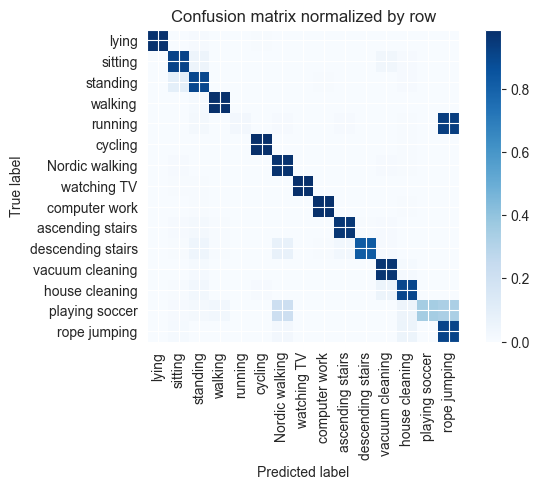

Training Epoch:  73%|███████▎  | 11/15 [07:08<02:36, 39.23s/it]

Overall accuracy: 0.898

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.993      0.983      0.988      0.131        589|	 house cleaning: 0.007,	standing: 0.007,	
          walking       0.986      0.982      0.984      0.100        446|	 standing: 0.013,	vacuum cleaning: 0.002,	
         standing       0.838      0.895      0.866      0.085        382|	 sitting: 0.089,	house cleaning: 0.008,	
   house cleaning       0.923      0.901      0.912      0.084        375|	 vacuum cleaning: 0.051,	standing: 0.029,	
            lying       1.000      0.979      0.989      0.084        375|	 standing: 0.011,	cycling: 0.005,	
   Nordic walking       0.897      0.975      0.934      0.081        365|	 vacuum cleaning: 0.008,	sitting: 0.008,	
          sitting       0.871      0.913      0.892      0.079        356|	 standing: 0.048,	vacuum cleaning: 0.031,	
  vacuum cleaning       0.889      0.967      0.926      0.074      


train: 100%|██████████| 283/283 [00:35<00:00,  7.96batch/s, loss=3.85, accuracy=0.875]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:04<00:00, 15.31batch/s, loss=3.95]


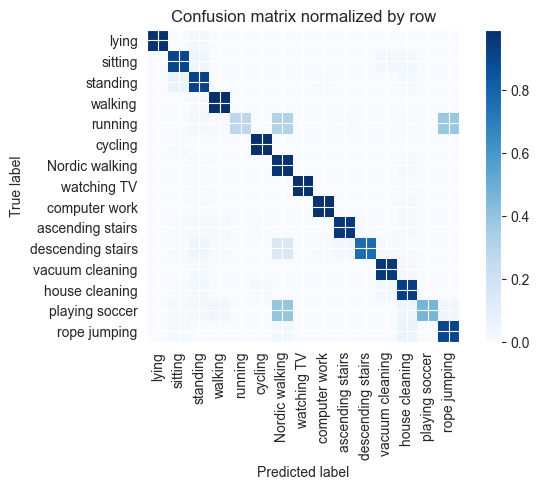

Training Epoch:  80%|████████  | 12/15 [07:48<01:58, 39.66s/it]

Overall accuracy: 0.912

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.982      0.988      0.134        599|	 house cleaning: 0.010,	standing: 0.007,	
          walking       0.982      0.984      0.983      0.100        447|	 standing: 0.011,	vacuum cleaning: 0.002,	
         standing       0.850      0.916      0.882      0.085        383|	 sitting: 0.063,	house cleaning: 0.013,	
   house cleaning       0.896      0.936      0.915      0.084        376|	 vacuum cleaning: 0.024,	standing: 0.021,	
            lying       1.000      0.979      0.989      0.084        375|	 standing: 0.016,	ascending stairs: 0.003,	
   Nordic walking       0.737      0.978      0.840      0.081        361|	 house cleaning: 0.008,	standing: 0.006,	
          sitting       0.905      0.907      0.906      0.079        356|	 standing: 0.045,	vacuum cleaning: 0.031,	
  vacuum cleaning       0.927      0.958      0.942      0.


train: 100%|██████████| 283/283 [00:34<00:00,  8.23batch/s, loss=7.22, accuracy=0.859]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:04<00:00, 15.59batch/s, loss=2.84]


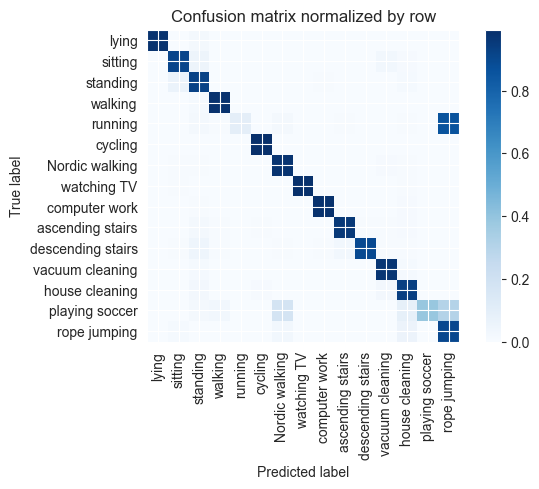

Training Epoch:  87%|████████▋ | 13/15 [08:28<01:19, 39.58s/it]

Overall accuracy: 0.909

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.983      0.989      0.133        596|	 house cleaning: 0.008,	standing: 0.005,	
          walking       0.984      0.982      0.983      0.100        447|	 standing: 0.013,	vacuum cleaning: 0.002,	
         standing       0.841      0.921      0.879      0.085        380|	 sitting: 0.061,	house cleaning: 0.013,	
            lying       1.000      0.979      0.989      0.085        379|	 standing: 0.016,	house cleaning: 0.003,	
   house cleaning       0.900      0.934      0.917      0.084        377|	 vacuum cleaning: 0.027,	standing: 0.027,	
          sitting       0.912      0.912      0.912      0.081        362|	 standing: 0.047,	vacuum cleaning: 0.030,	
   Nordic walking       0.936      0.975      0.955      0.080        359|	 vacuum cleaning: 0.008,	house cleaning: 0.006,	
  vacuum cleaning       0.921      0.966      0.943   


train: 100%|██████████| 283/283 [00:34<00:00,  8.25batch/s, loss=3.73, accuracy=0.922]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:04<00:00, 16.92batch/s, loss=4.21]


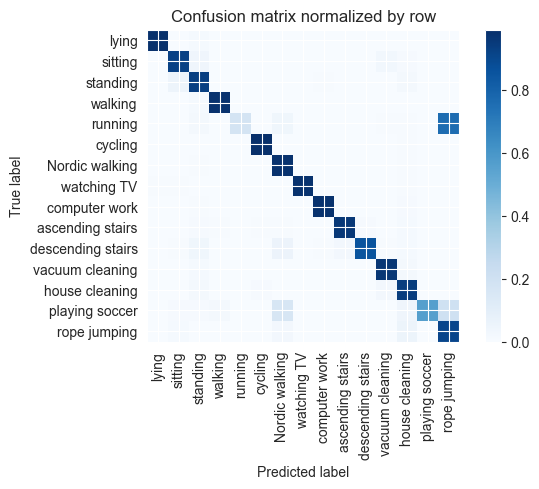

Training Epoch:  93%|█████████▎| 14/15 [09:07<00:39, 39.39s/it]

Overall accuracy: 0.916

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.993      0.981      0.987      0.132        592|	 house cleaning: 0.010,	standing: 0.005,	
          walking       0.991      0.980      0.985      0.099        444|	 standing: 0.014,	vacuum cleaning: 0.002,	
         standing       0.866      0.930      0.897      0.085        383|	 sitting: 0.047,	house cleaning: 0.016,	
            lying       0.997      0.984      0.991      0.084        377|	 standing: 0.013,	computer work: 0.003,	
   house cleaning       0.892      0.938      0.914      0.083        370|	 vacuum cleaning: 0.024,	standing: 0.022,	
   Nordic walking       0.904      0.981      0.941      0.082        366|	 house cleaning: 0.005,	standing: 0.005,	
          sitting       0.927      0.921      0.924      0.079        356|	 standing: 0.039,	vacuum cleaning: 0.031,	
  vacuum cleaning       0.926      0.960      0.943      0.073


train: 100%|██████████| 283/283 [00:34<00:00,  8.29batch/s, loss=3, accuracy=0.922]


torch.Size([15, 512])



seen: 100%|██████████| 70/70 [00:04<00:00, 17.36batch/s, loss=2.98]


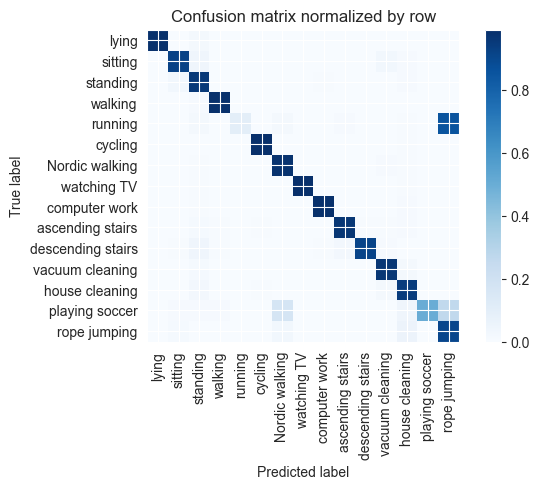

Overall accuracy: 0.917

                    precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

    computer work       0.995      0.983      0.989      0.131        589|	 house cleaning: 0.008,	standing: 0.005,	
          walking       0.991      0.984      0.988      0.100        448|	 standing: 0.011,	vacuum cleaning: 0.002,	
         standing       0.858      0.955      0.904      0.085        379|	 sitting: 0.029,	house cleaning: 0.011,	
            lying       1.000      0.984      0.992      0.084        375|	 standing: 0.016,	rope jumping: 0.000,	
   house cleaning       0.907      0.944      0.925      0.083        373|	 standing: 0.024,	vacuum cleaning: 0.021,	
   Nordic walking       0.939      0.975      0.957      0.081        363|	 vacuum cleaning: 0.011,	house cleaning: 0.006,	
          sitting       0.946      0.919      0.932      0.080        360|	 standing: 0.042,	vacuum cleaning: 0.028,	
  vacuum cleaning       0.924      0.961      0.942     

unseen: 100%|██████████| 60/60 [00:03<00:00, 15.87batch/s, loss=2.49]


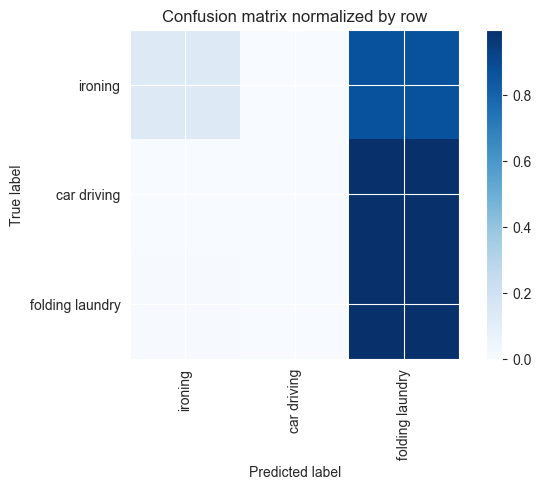

Overall accuracy: 0.331

                  precision     recall   f1-score rel. freq. abs. freq.|	 biggest thieves

        ironing       0.981      0.130      0.230      0.606       2328|	 folding laundry: 0.870,	car driving: 0.000,	
folding laundry       0.274      0.995      0.430      0.253        973|	 ironing: 0.005,	car driving: 0.000,	
    car driving       0.000      0.000      0.000      0.140        539|	 folding laundry: 0.998,	ironing: 0.002,	

----------------------------------------------------------------------------------------------------
    avg / total       0.664      0.331      0.248        1.0       3840|	      

{'accuracy': 0.33098958333333334, 'precision': 0.41824194215084337, 'recall': 0.37500529767643914, 'f1': 0.21988224683439858}
============== Overall Unseen Classes Performance ==============


accuracy     0.411175
precision    0.382981
recall       0.377545
f1           0.306024
dtype: float64

In [152]:
fold_metric_scores = []
for i, cs in enumerate(fold_cls_ids):
    print("="*16, f'Fold-{i}', "="*16)
    print(f'Unseen Classes : {fold_classes[i]}')

    data_dict = dataReader.generate(unseen_classes=cs, seen_ratio=config['seen_split'], unseen_ratio=config['unseen_split'], window_size=5.21, window_overlap=4.21, resample_freq=20)
    all_classes = dataReader.idToLabel
    seen_classes = data_dict['seen_classes']
    unseen_classes = data_dict['unseen_classes']
    print("seen classes > ", seen_classes)
    print("unseen classes > ", unseen_classes)
    train_n, in_ft = data_dict['train']['X'].shape

    print("Initiate IMU datasets ...")
    # build IMU datasets
    train_dt = PAMAP2Dataset(data=data_dict['train']['X'], actions=data_dict['train']['y'], attributes=video_feat, attribute_dict=action_dict, action_classes=seen_classes, seq_len=100)
    train_dl = DataLoader(train_dt, batch_size=config['batch_size'], shuffle=True, pin_memory=True, drop_last=True)
    # build seen eval_dt
    eval_dt = PAMAP2Dataset(data=data_dict['eval-seen']['X'], actions=data_dict['eval-seen']['y'], attributes=video_feat, attribute_dict=action_dict, action_classes=seen_classes, seq_len=100)
    eval_dl = DataLoader(eval_dt, batch_size=config['batch_size'], shuffle=True, pin_memory=True, drop_last=True)
    # build unseen test_dt
    test_dt = PAMAP2Dataset(data=data_dict['test']['X'], actions=data_dict['test']['y'], attributes=video_feat, attribute_dict=action_dict, action_classes=unseen_classes, seq_len=100)
    test_dl = DataLoader(test_dt, batch_size=config['batch_size'], shuffle=True, pin_memory=True, drop_last=True)
    
    # build model
    model = SOTAEmbedding(
        linear_filters=config["model_params"]["linear_filters"],
        input_feat=config["model_params"]["input_feat"],
        dropout=config["model_params"]["dropout"]
    )
    # model = Model1(feat_dim=in_ft, max_len=seq_len, d_model=config['d_model'], n_heads=config['num_heads'], num_layers=2, dim_feedforward=128, ft_size=feat_size)
    model.to(device)
    # define run parameters 
    optimizer = Adam(model.parameters(), lr=config['lr'],weight_decay=1e-5)
    loss_module = {'class': nn.CrossEntropyLoss(reduction="sum"), 'feature': nn.L1Loss(reduction="sum")}
    best_acc = 0.0
    # train the model 
    for epoch in tqdm(range(config['n_epochs']), desc='Training Epoch', leave=False):
        train_metrics = train_step(model, train_dl, train_dt,optimizer, loss_module, device, class_names=[all_classes[i] for i in seen_classes], phase='train', loss_alpha=0.0001)
        eval_metrics = eval_step(model, eval_dl, eval_dt,loss_module, device, class_names=[all_classes[i] for i in seen_classes], phase='seen', print_report=True, loss_alpha=0.0001)
        # print(f"EPOCH [{epoch}] TRAINING : {train_metrics}")
        # print(f"EPOCH [{epoch}] EVAL : {eval_metrics}")
        if eval_metrics['accuracy'] > best_acc:
            best_model = deepcopy(model.state_dict())
    
    # replace by best model 
    model.load_state_dict(best_model)
    save_model(model,notebook_iden,model_iden,i)

    # run evaluation on unseen classes
    test_metrics = eval_step(model, test_dl,test_dt, loss_module, device, class_names=[all_classes[i] for i in unseen_classes],   phase='unseen', loss_alpha=0.0001)
    fold_metric_scores.append(test_metrics)
    print(test_metrics)
    print("="*40)

print("="*14, "Overall Unseen Classes Performance", "="*14)
seen_score_df = pd.DataFrame.from_records(fold_metric_scores)
seen_score_df.mean()
